In [1]:
%run custom_datasets.ipynb

Imported classes.


In [2]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import os

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize
import numpy as np
import skimage
import matplotlib.pyplot as plt

import time
import pickle

from datetime import datetime
from pathlib import Path


## Network initialization

In [3]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
    
    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
    # hyperparameter.
    
    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
    
    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30, add_dropout=True):
        super().__init__()
        
        self.omega_0 = omega_0
        self.is_first = is_first
        self.in_features = in_features
        self.add_dropout = add_dropout
        
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        ####### ADDED DROPOUT #########
#         self.dropout = nn.Dropout(.2)
        
        self.init_weights()
    
    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features, 
                                             1 / self.in_features)      
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                             np.sqrt(6 / self.in_features) / self.omega_0)
        
    def forward(self, input):
        out = torch.sin(self.omega_0 * self.linear(input))
        ####### ADDED DROPOUT #########
#         if self.add_dropout and not self.is_first: 
#             out = self.dropout(out)
        return out
    
    
class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, 
                 first_different_init=True, outermost_layer="None", 
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()
        
        self.net = []
        
        
        # first layer 
        if first_different_init:
            self.net.append(SineLayer(in_features, hidden_features, 
                                  is_first=True, omega_0=first_omega_0))
        else: 
            self.net.append(SineLayer(in_features, hidden_features, omega_0=hidden_omega_0))

            
        # hidden layers
        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features, omega_0=hidden_omega_0))

            
        # last layer
        if outermost_layer.lower() == "linear":
            final_linear = nn.Linear(hidden_features, out_features)    
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)  
            self.net.append(final_linear)

        elif outermost_layer.lower() == "sigmoid":
            final_linear = nn.Linear(hidden_features, out_features)    
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)  
            self.net.append(final_linear)
            self.net.append(nn.Sigmoid())
        
        elif outermost_layer.lower() == "sine":
            self.net.append(SineLayer(hidden_features, out_features, omega_0=hidden_omega_0))
        
        else: 
            raise(Exception("Choose a correct outermost_layer"))
            
        
        # add all to network
        self.net = nn.Sequential(*self.net)
    
    def forward(self, coords):
        output = self.net(coords)
        return output


def set_device():
    DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print('----------------------------------')
    print('Using device for training:', DEVICE)
    print('----------------------------------')
    
    return DEVICE 

def mem(step):
    div = 1024*1024*1024
    
    t = torch.cuda.get_device_properties(0).total_memory
    c = torch.cuda.memory_cached(0)
    a = torch.cuda.memory_allocated(0)

    print(step)
    print("Memory cached:", round(c/div, 3))
    print("Memory allocated:", round(c/div, 3))
    print()

In [4]:
DEVICE = set_device()


----------------------------------
Using device for training: cuda
----------------------------------


In [5]:
data = PrepareData3D(["Aorta Volunteers", "Aorta BaV", "Aorta Resvcue", "Aorta CoA"], norm_min_max=[0,1])

train_ds = SirenDataset(data.train, DEVICE) 
train_dataloader = DataLoader(train_ds, batch_size=1, num_workers=0)

In [6]:
val_ds = SirenDataset(data.val, DEVICE) 
val_dataloader = DataLoader(val_ds, batch_size=1, num_workers=0)

In [7]:
train_ds.__len__()

54

### Init models

In [8]:
def save_models(dt, models, name=None): 
    
    Path(f"Models/{dt}").mkdir(parents=True, exist_ok=True)   
    
    if isinstance(models, dict):
        for subject, (model, optim) in train_models.items():
            torch.save(model.state_dict(), f"Models/{dt}/{subject}.pt")
        
    else:
        torch.save(models.state_dict(), f"Models/{dt}/{name}.pt")

def save_all_models(dt):
    save_models(dt, train_models)
    save_models(dt, pcmra_siren, "pcmra_siren")
    save_models(dt, mask_siren, "mask_siren")

In [9]:
def load_models(dt, models, name=None): 
    if isinstance(models, dict):
        for subject, (model, optim) in train_models.items():
            model.load_state_dict(torch.load(f"Models/{dt}/{subject}.pt"))
        
    else:
        models.load_state_dict(torch.load(f"Models/{dt}/{name}.pt"))
    
    return models
        
def load_all_models(dt):
    m1 = load_models(dt, train_models)
    m2 = load_models(dt, pcmra_siren, "pcmra_siren")
    m3 = load_models(dt, mask_siren, "mask_siren")

In [10]:
size = 256

def create_model_per_image(dataset): 
    models = {}
    
    for i in range(dataset.__len__()):
        subj = dataset[i][1].item()
        
        models[subj] = []

        model = Siren(in_features=3, out_features=size, hidden_features=size, 
                      hidden_layers=1, first_different_init=True, outermost_layer="sine").cuda()

        models[subj].append(model)
        models[subj].append(torch.optim.Adam(lr=1e-4, params=model.parameters()))
    
    return models

In [11]:
pcmra_siren = Siren(in_features=size, out_features=1, hidden_features=size, 
                  hidden_layers=1, first_different_init=False, outermost_layer="linear").cuda()
pcmra_optim = torch.optim.Adam(lr=1e-4, params=pcmra_siren.parameters())

mask_siren = Siren(in_features=size, out_features=1, hidden_features=size, 
                  hidden_layers=1, first_different_init=False, outermost_layer="sigmoid").cuda()
mask_optim = torch.optim.Adam(lr=1e-4, params=mask_siren.parameters())

train_models = create_model_per_image(train_ds)

val_models = create_model_per_image(val_ds)

In [12]:
load_all_models("11_03_2021_10_52_54")

In [13]:
train_models["RESV_109.npy"]

[Siren(
   (net): Sequential(
     (0): SineLayer(
       (linear): Linear(in_features=3, out_features=256, bias=True)
     )
     (1): SineLayer(
       (linear): Linear(in_features=256, out_features=256, bias=True)
     )
     (2): SineLayer(
       (linear): Linear(in_features=256, out_features=256, bias=True)
     )
   )
 ),
 Adam (
 Parameter Group 0
     amsgrad: False
     betas: (0.9, 0.999)
     eps: 1e-08
     lr: 0.0001
     weight_decay: 0
 )]

In [14]:
pcmra_siren

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): Linear(in_features=256, out_features=1, bias=True)
  )
)

In [15]:
mask_siren

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): Linear(in_features=256, out_features=1, bias=True)
    (3): Sigmoid()
  )
)

### Train and validation functions

In [16]:
def l2_loss(out, ground_truth): 
    return ((out - ground_truth)**2).mean()

def train_model(coords, ground_truth, h_model, h_optim, 
                t_model, t_optim, criterion, train_head=True, train_tail=True): 

    h_model.train()
    t_model.train()
    
    out = h_model(coords)
    out = t_model(out)

    loss = criterion(out, ground_truth)

    h_optim.zero_grad()
    t_optim.zero_grad()
    
    loss.backward()

    if train_head: 
        h_optim.step()
    
    if train_tail: 
        t_optim.step()
    
    return out, loss

In [17]:
batches = 1
steps_til_summary = 10

mask_loss = torch.Tensor([0])
pcmra_loss = torch.Tensor([0])

bceloss = nn.BCELoss()

now = datetime.now()
dt = now.strftime("%d_%m_%Y_%H_%M_%S")
print(dt)

lowest_losses = 1000

# old_time = time.time()

for batch in range(batches):
    
    pcmra_losses = []
    mask_losses = []
        
    for idx, subj, proj, coords, pcmra, mask in train_dataloader:
        subj = subj[0].item()
        img_siren, img_optim = train_models[subj]
        
        pcmra_out, pcmra_loss = train_model(coords, pcmra, img_siren, img_optim,
                                            pcmra_siren, pcmra_optim, l2_loss,
                                            train_head=False, train_tail=False)
        
        mask_out, mask_loss = train_model(coords, mask, img_siren, img_optim,
                                          mask_siren, mask_optim, bceloss,
                                          train_head=False, train_tail=False)

        pcmra_losses.append(pcmra_loss.item())
        mask_losses.append(mask_loss.item())
    
    if not batch % steps_til_summary:
        p_mean, p_std = round(np.mean(pcmra_losses), 6), round(np.std(pcmra_losses), 6)
        m_mean, m_std = round(np.mean(mask_losses), 6), round(np.std(mask_losses), 6)
        
        print(f"Batch {batch} \n Pcmra loss: \t mean {p_mean} \t std {p_std} \n Mask loss: \t mean {m_mean} \t std {m_std}")
        
        if (p_mean + m_mean) < lowest_losses: 
            print("Saving models...")
            lowest_losses = (p_mean + m_mean)            
            save_all_models(dt)


17_03_2021_14_07_59
Batch 0 
 Pcmra loss: 	 mean 0.000348 	 std 0.000168 
 Mask loss: 	 mean 0.005529 	 std 0.002104
Saving models...


### Train single Image Siren

In [19]:
    # load_all_models("11_03_2021_10_52_54")

Batch 0 	 pcmra loss: 0.0135 	 mask loss: 0.033114
4.998830793745412e-10
1.8974665181303862e-05
0.12456312142312492
0.9993072748184204


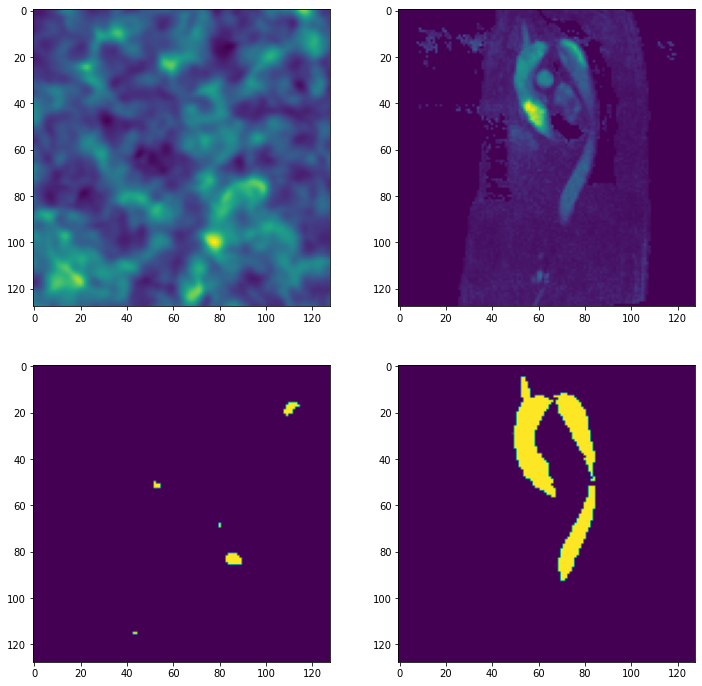

Batch 1 	 pcmra loss: 0.006649 	 mask loss: 0.036562
1.1887062167925677e-10
2.8563627893163357e-05
0.4350227341055869
0.9999662637710571


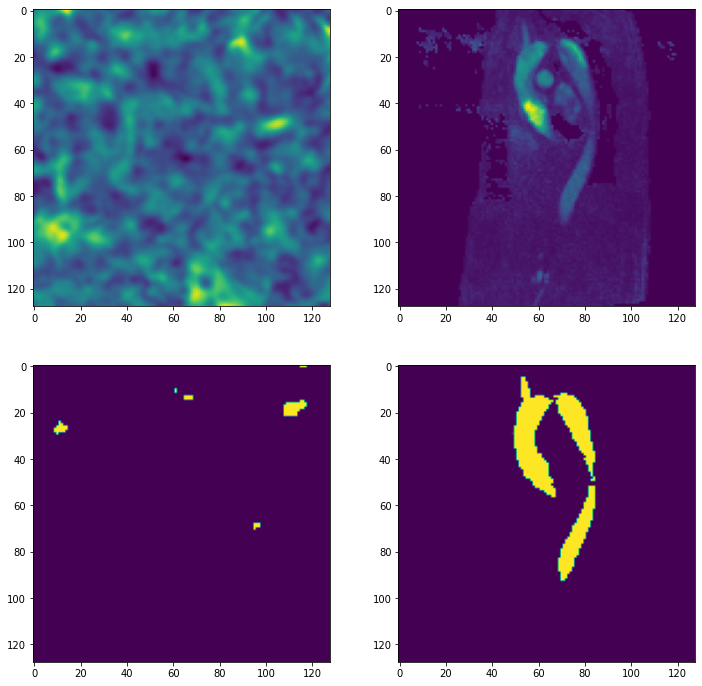

Batch 2 	 pcmra loss: 0.006432 	 mask loss: 0.040869
9.59072266049077e-10
4.199135219096206e-05
0.6880342721939081
0.9998838901519775


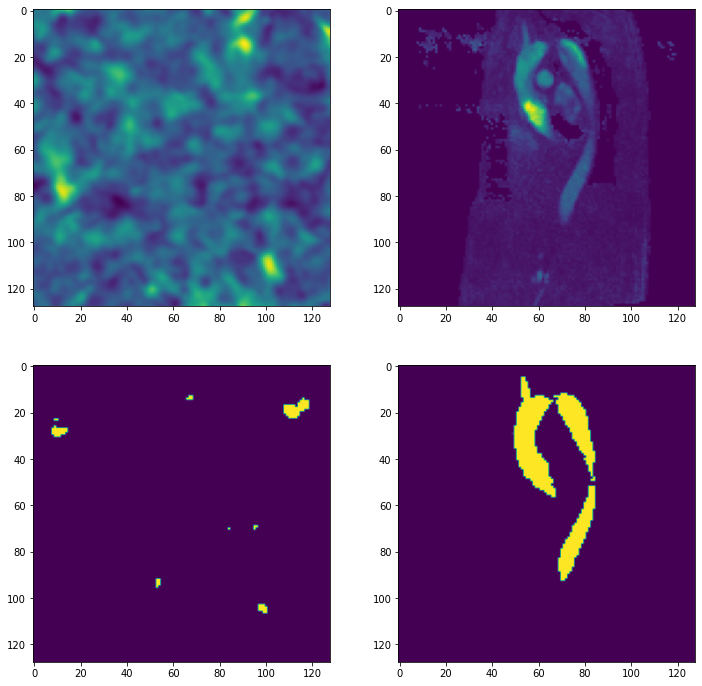

Batch 3 	 pcmra loss: 0.005927 	 mask loss: 0.042317
1.5202371583811214e-09
4.483650627662428e-05
0.7397943109273902
0.9999008178710938


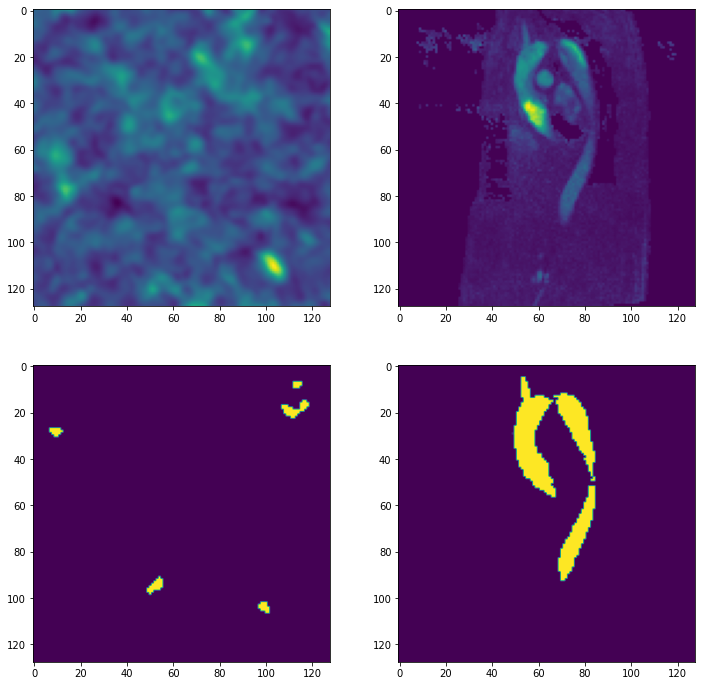

Batch 4 	 pcmra loss: 0.005225 	 mask loss: 0.041755
1.4907278744757946e-09
4.1464378227829e-05
0.7149504482746121
0.9999828338623047


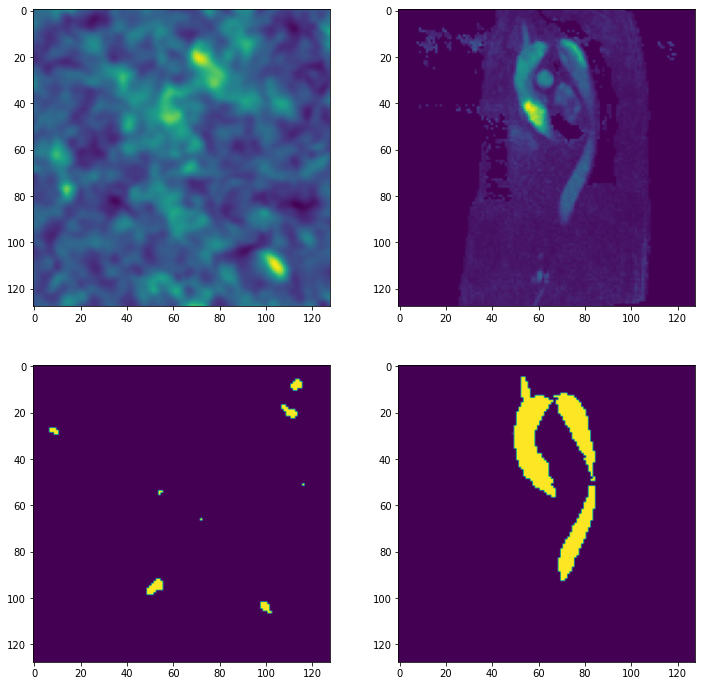

Batch 5 	 pcmra loss: 0.004534 	 mask loss: 0.04105
1.5910479600478311e-09
3.8350412069121376e-05
0.6811832547187783
0.9999922513961792


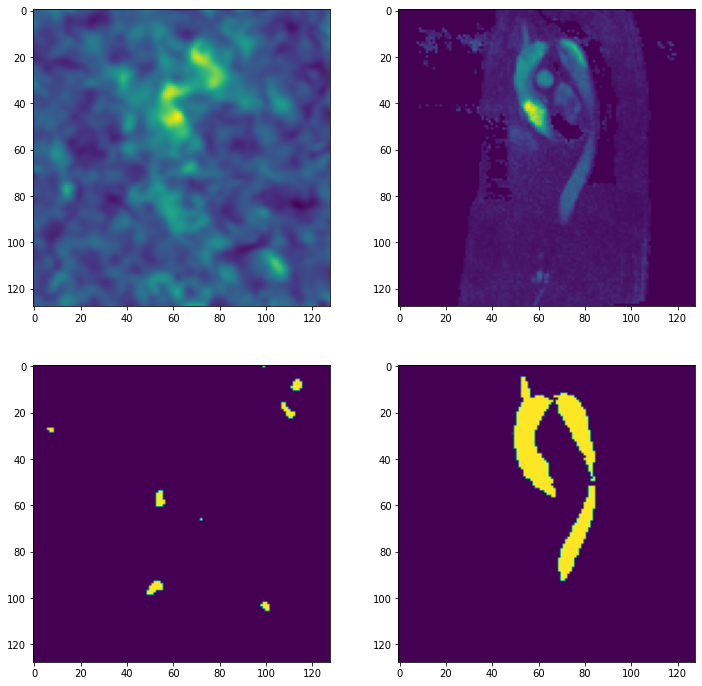

Batch 6 	 pcmra loss: 0.003955 	 mask loss: 0.040754
1.4433177986106216e-09
3.6156034184386954e-05
0.6663888365030239
0.9999903440475464


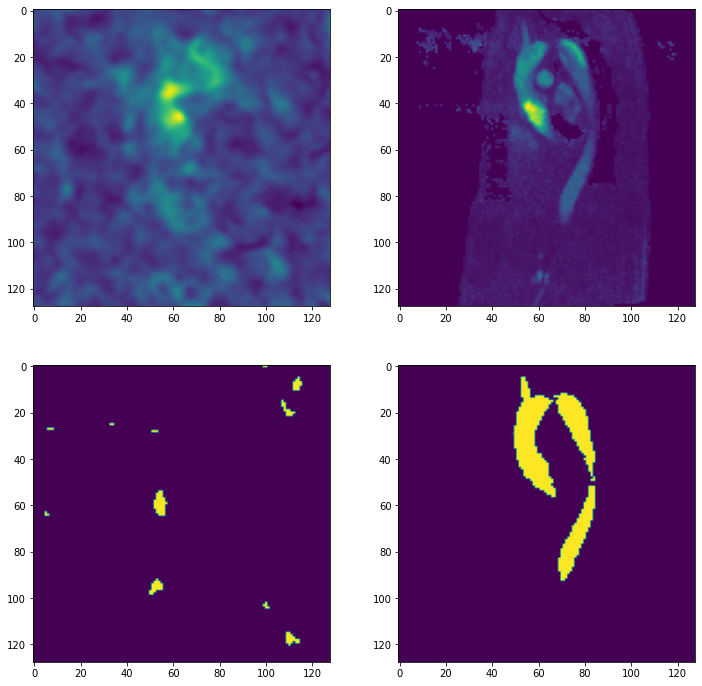

Batch 7 	 pcmra loss: 0.003515 	 mask loss: 0.040435
6.751134651317159e-10
3.3472757422714494e-05
0.6554584026336645
0.9999784231185913


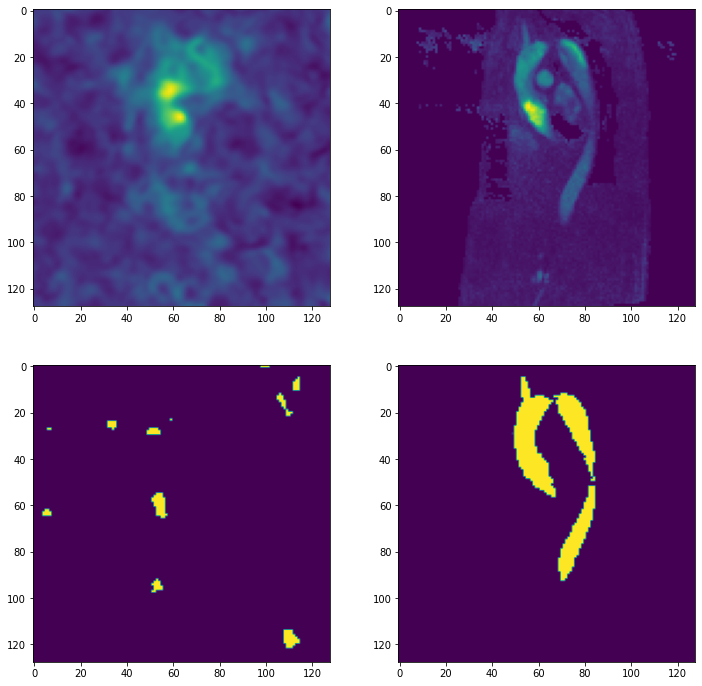

Batch 8 	 pcmra loss: 0.003162 	 mask loss: 0.039866
5.939610470129253e-10
3.096648651990108e-05
0.6323101043701165
0.9999493360519409


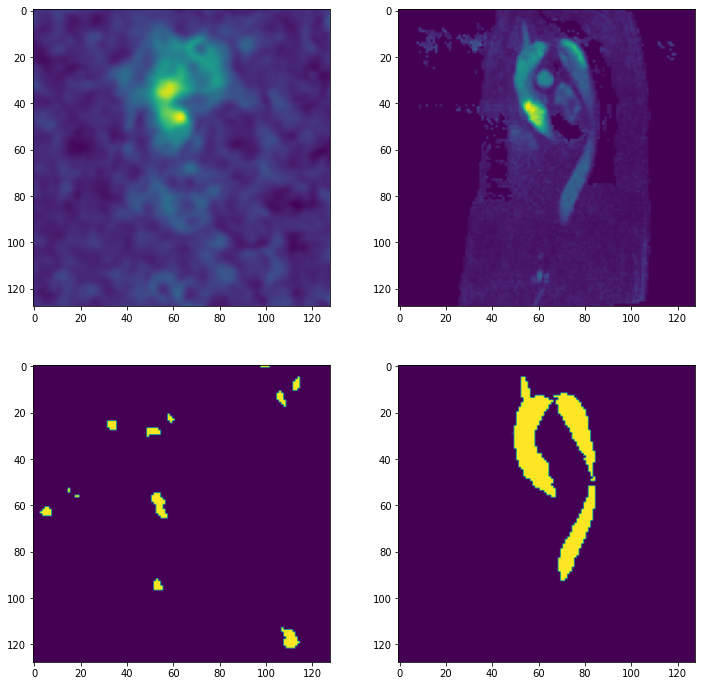

Batch 9 	 pcmra loss: 0.002861 	 mask loss: 0.039374
7.010903524395928e-10
2.9252434615045786e-05
0.6048727095127098
0.9999486207962036


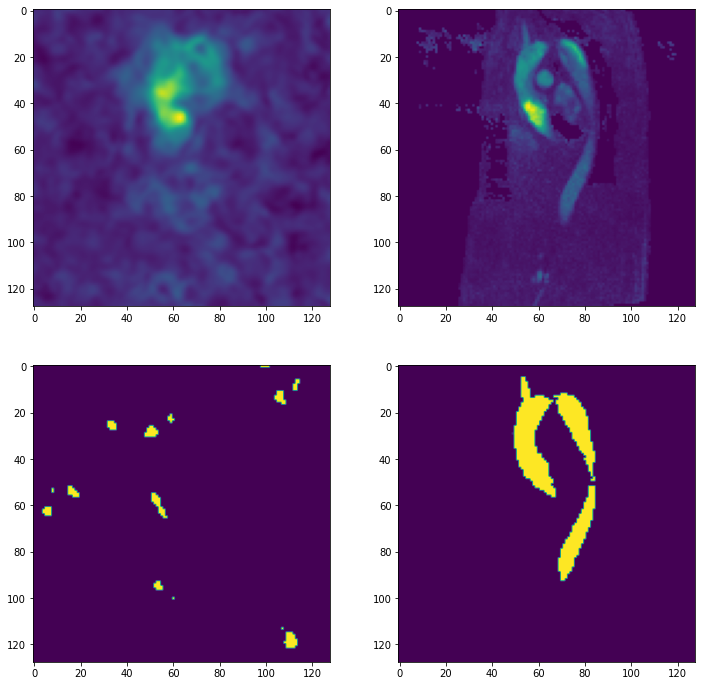

Batch 10 	 pcmra loss: 0.002609 	 mask loss: 0.039126
6.255543860689272e-10
2.8485243092291057e-05
0.5903520524501799
0.9999672174453735


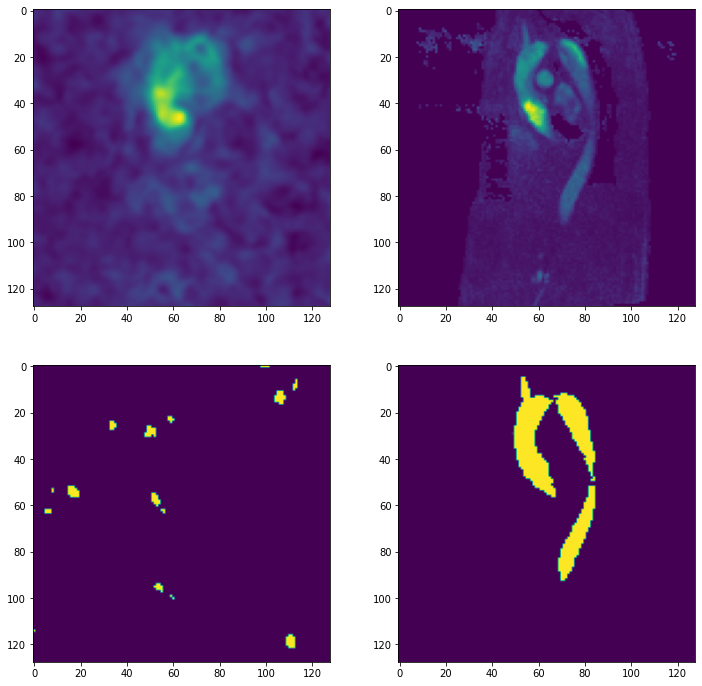

Batch 11 	 pcmra loss: 0.002396 	 mask loss: 0.039103
7.255657741289667e-10
2.875731479434762e-05
0.5934277027845307
0.9999680519104004


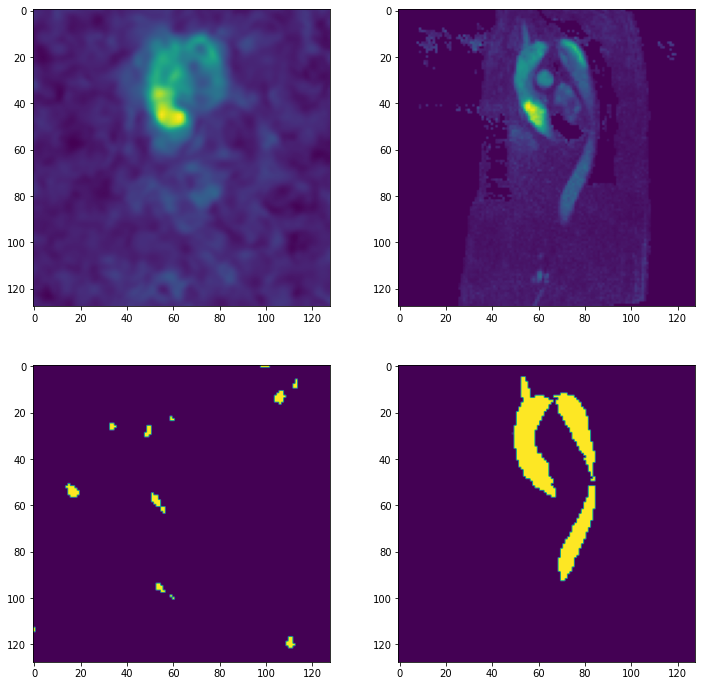

Batch 12 	 pcmra loss: 0.002209 	 mask loss: 0.039218
1.00531194480169e-09
2.966122883663047e-05
0.6026717871427509
0.9999542236328125


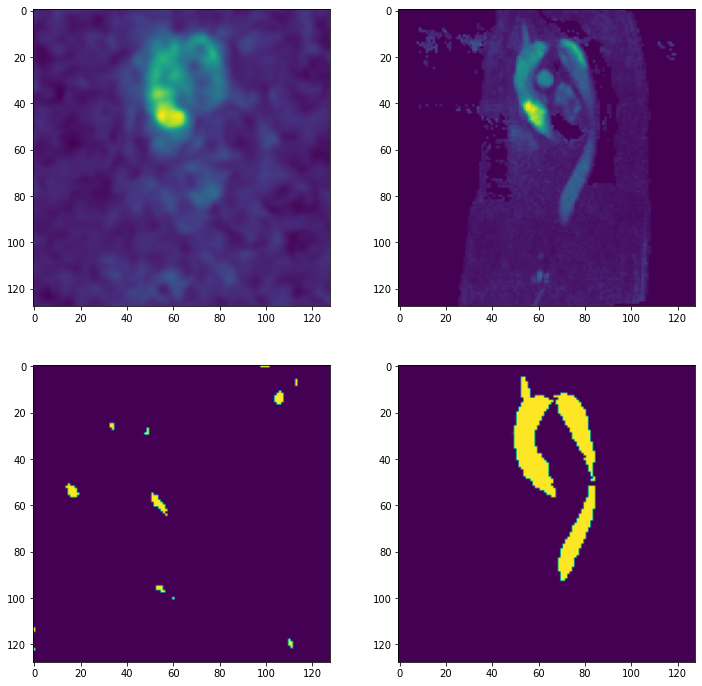

Batch 13 	 pcmra loss: 0.002048 	 mask loss: 0.039346
1.1519649678604083e-09
3.060153903788887e-05
0.6176764667033982
0.9999322891235352


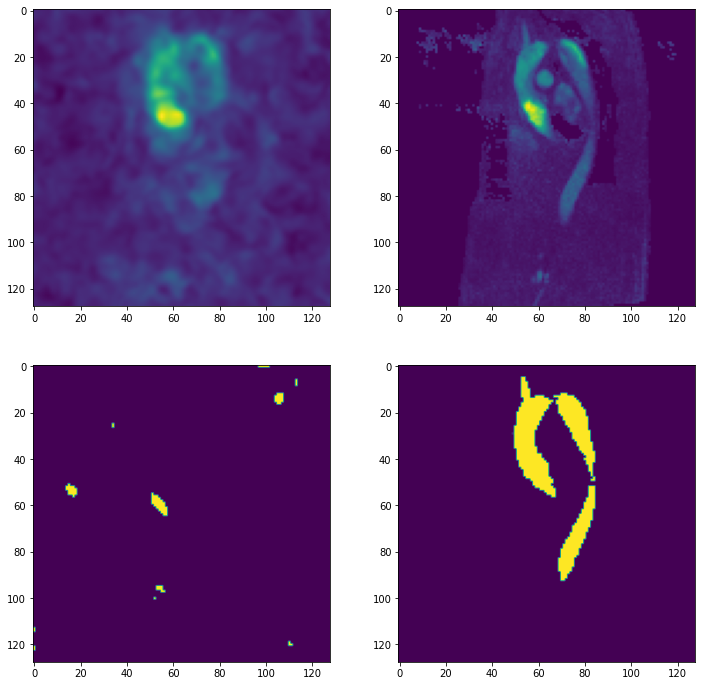

Batch 14 	 pcmra loss: 0.001908 	 mask loss: 0.039329
1.0994769539252047e-09
3.106406256847549e-05
0.6174611747264852
0.9999281167984009


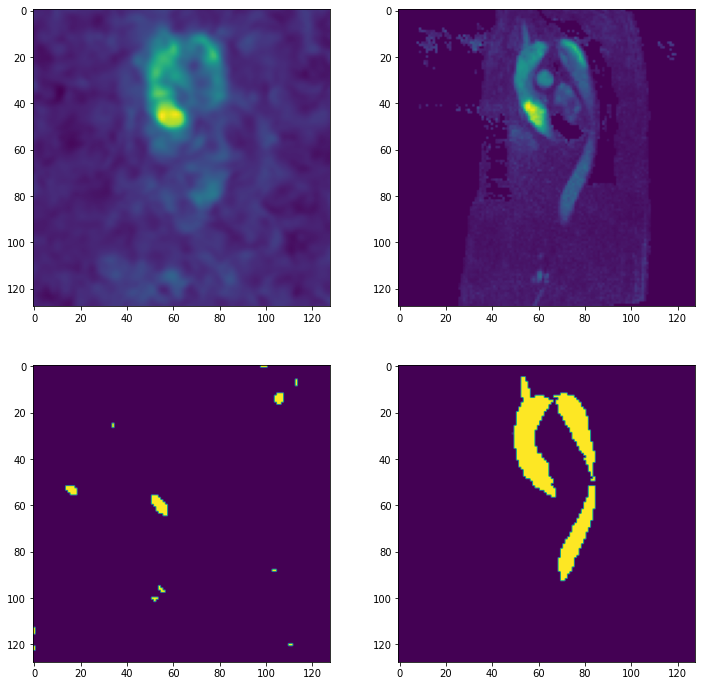

Batch 15 	 pcmra loss: 0.001781 	 mask loss: 0.039107
9.818178492437823e-10
3.090171958319843e-05
0.6036335170269005
0.9999228715896606


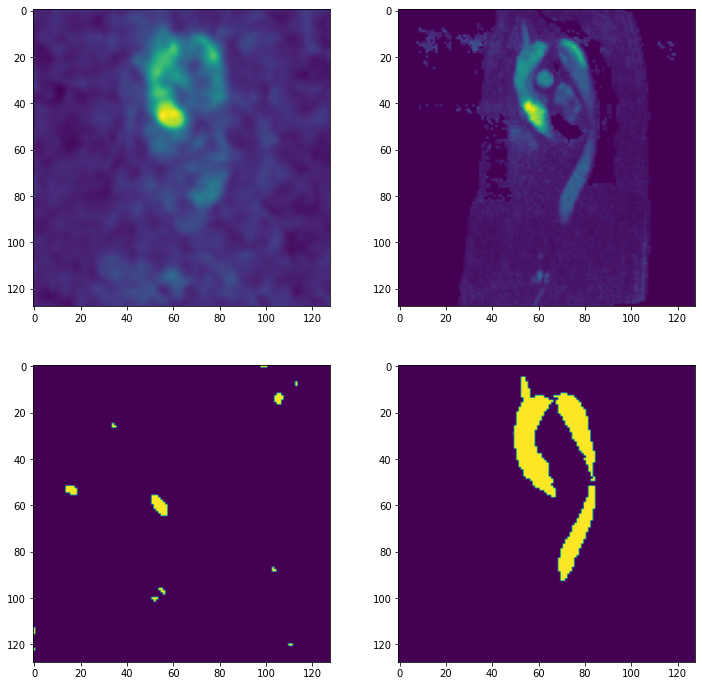

Batch 16 	 pcmra loss: 0.001668 	 mask loss: 0.038778
6.963671861370813e-10
3.0375652386283036e-05
0.5800071567296886
0.9999384880065918


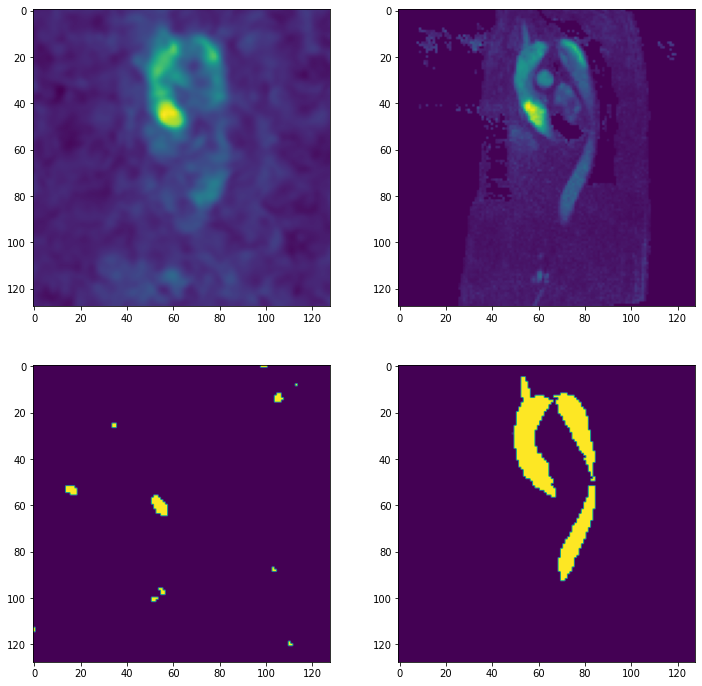

Batch 17 	 pcmra loss: 0.001571 	 mask loss: 0.038496
5.69951918993894e-10
2.9734127565461677e-05
0.55912410318851
0.999948263168335


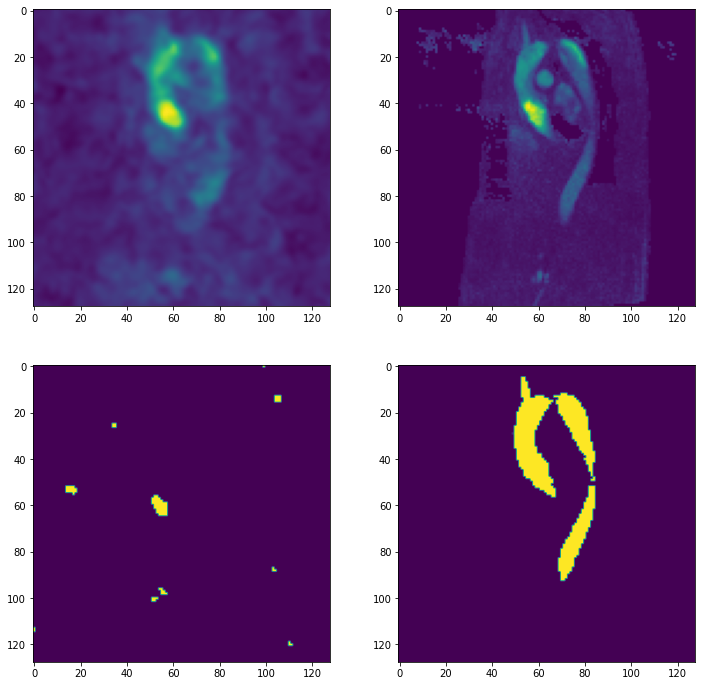

Batch 18 	 pcmra loss: 0.001487 	 mask loss: 0.038369
5.461659458028123e-10
2.940209196822252e-05
0.5460252135992009
0.999955415725708


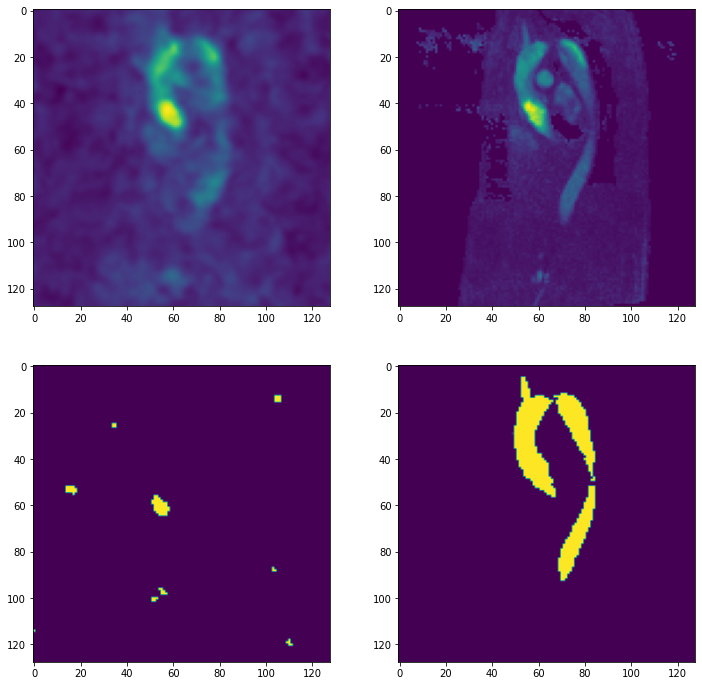

Batch 19 	 pcmra loss: 0.001411 	 mask loss: 0.03841
5.916837575448142e-10
2.9380075829976704e-05
0.552306473255152
0.9999616146087646


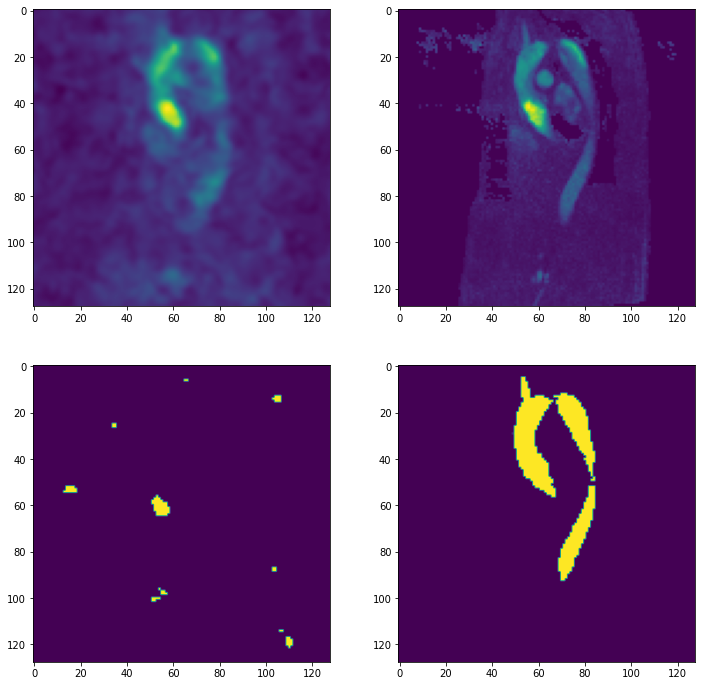

Batch 20 	 pcmra loss: 0.00134 	 mask loss: 0.038563
5.886187093295803e-10
2.9703208383580204e-05
0.5625342905521377
0.9999668598175049


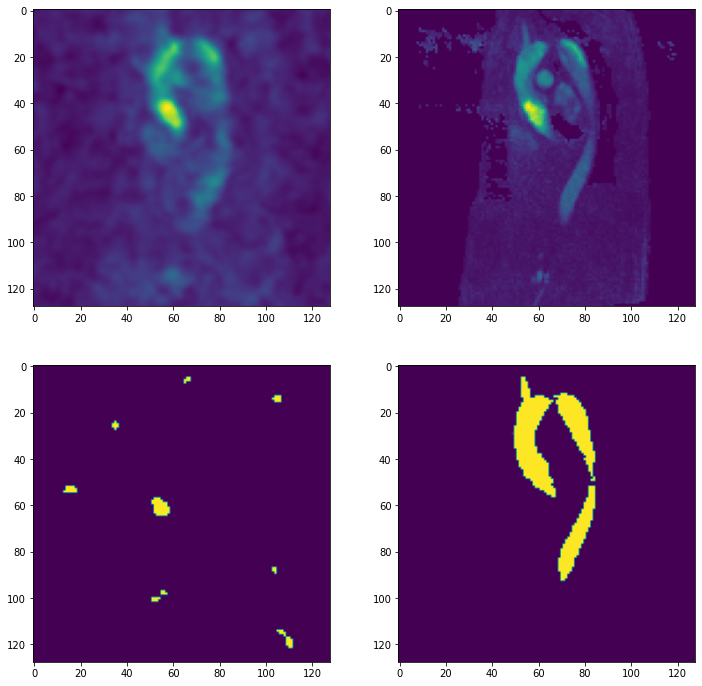

Batch 21 	 pcmra loss: 0.001274 	 mask loss: 0.038737
6.205265190573073e-10
3.0099608011369128e-05
0.5804810732603056
0.9999704360961914


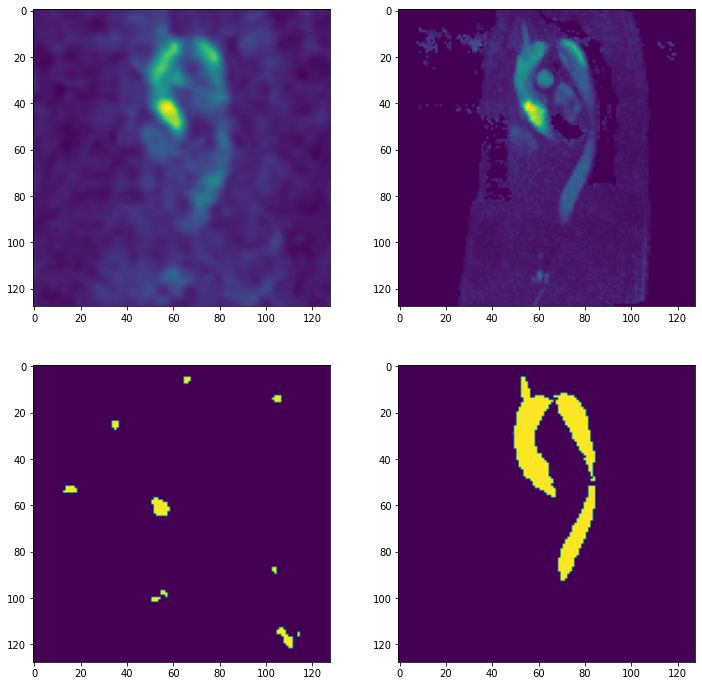

Batch 22 	 pcmra loss: 0.001213 	 mask loss: 0.038853
6.729061197141561e-10
3.038109753106255e-05
0.5869300454854954
0.9999715089797974


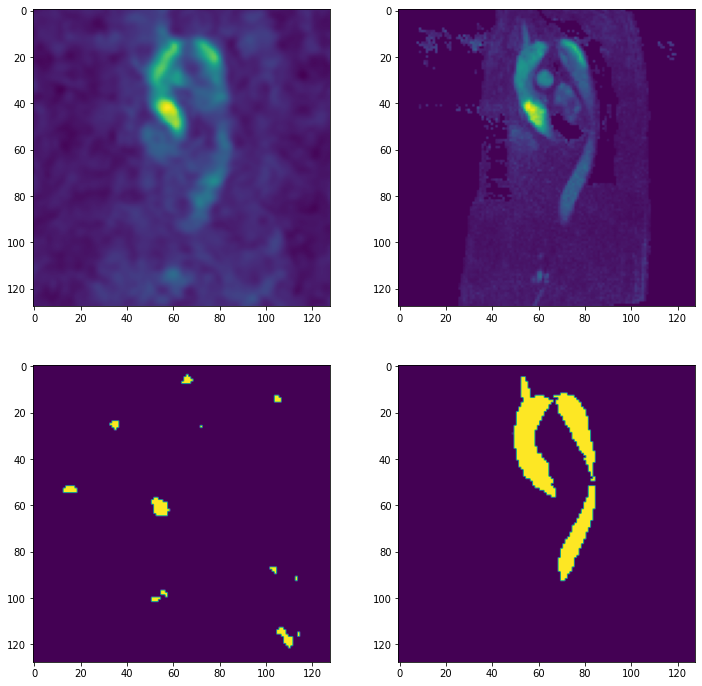

Batch 23 	 pcmra loss: 0.001159 	 mask loss: 0.038892
7.403732626976023e-10
3.0481466637866106e-05
0.5921563237905502
0.9999700784683228


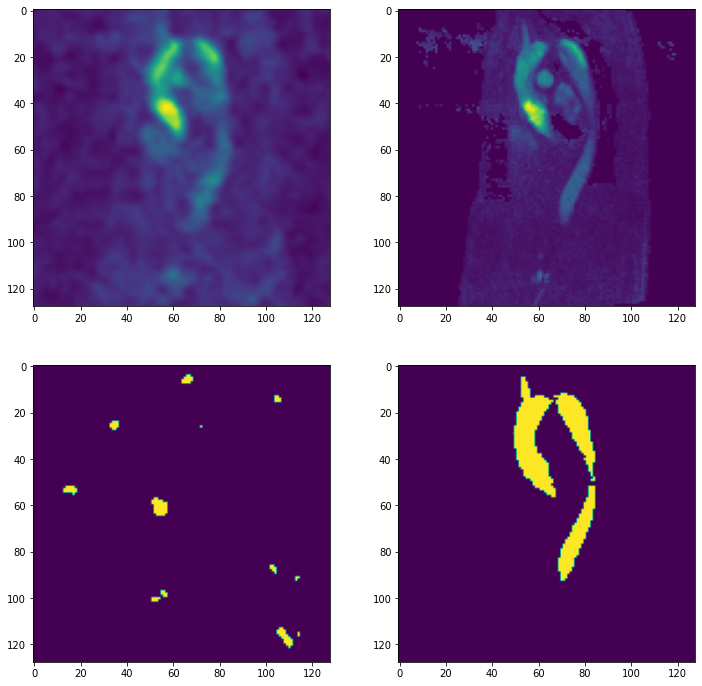

Batch 24 	 pcmra loss: 0.001112 	 mask loss: 0.03888
8.323398636989054e-10
3.0588962545152754e-05
0.5938817620277393
0.9999659061431885


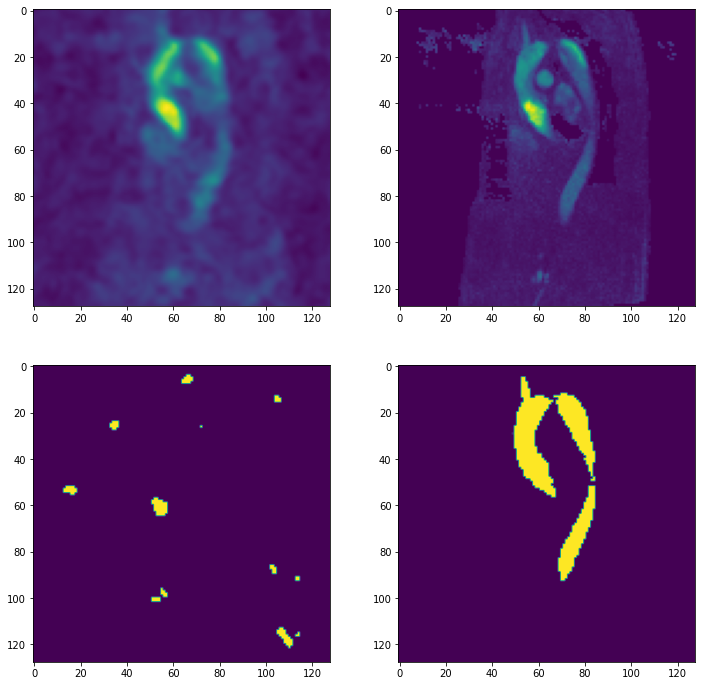

Batch 25 	 pcmra loss: 0.001069 	 mask loss: 0.038857
8.619644442653396e-10
3.059517803194467e-05
0.5949092805385565
0.9999595880508423


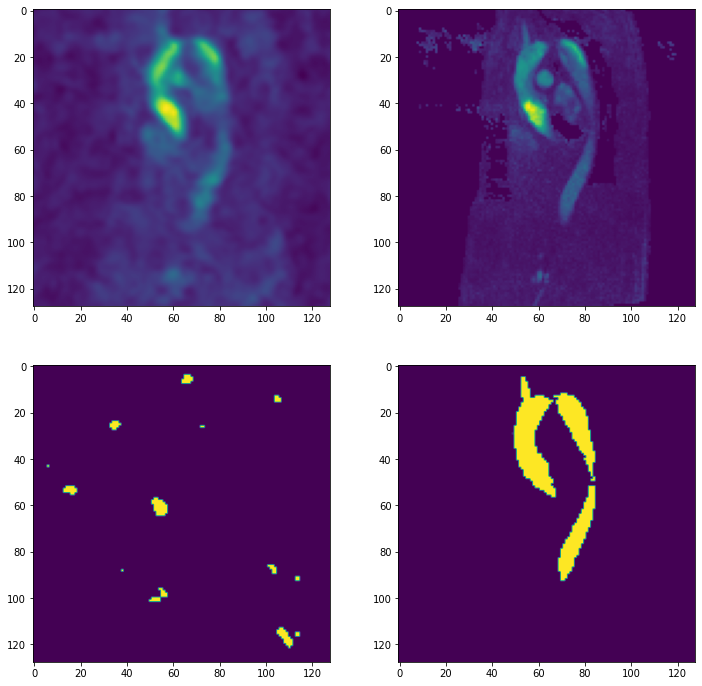

Batch 26 	 pcmra loss: 0.001029 	 mask loss: 0.038836
8.879431079300559e-10
3.067992292926647e-05
0.5967489063739762
0.9999576807022095


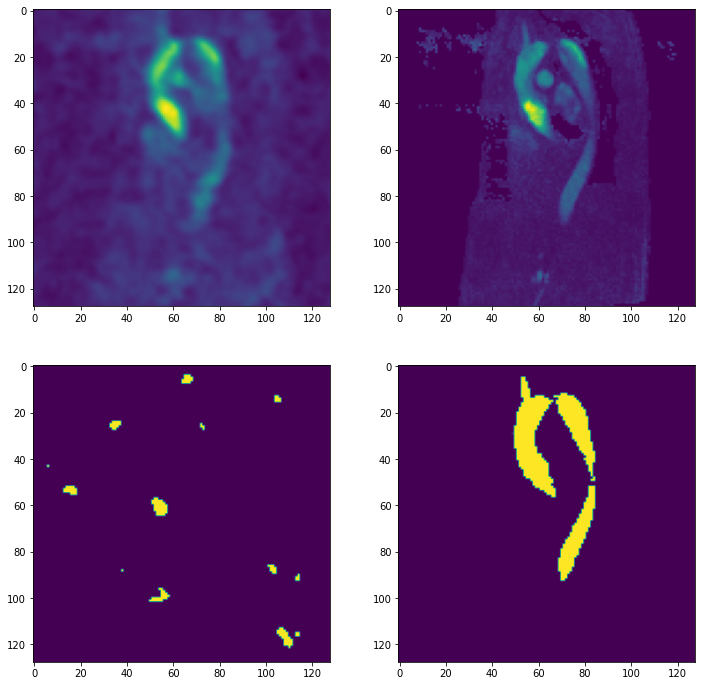

Batch 27 	 pcmra loss: 0.00099 	 mask loss: 0.038813
8.473814427922832e-10
3.078438930970151e-05
0.596683898568146
0.9999614953994751


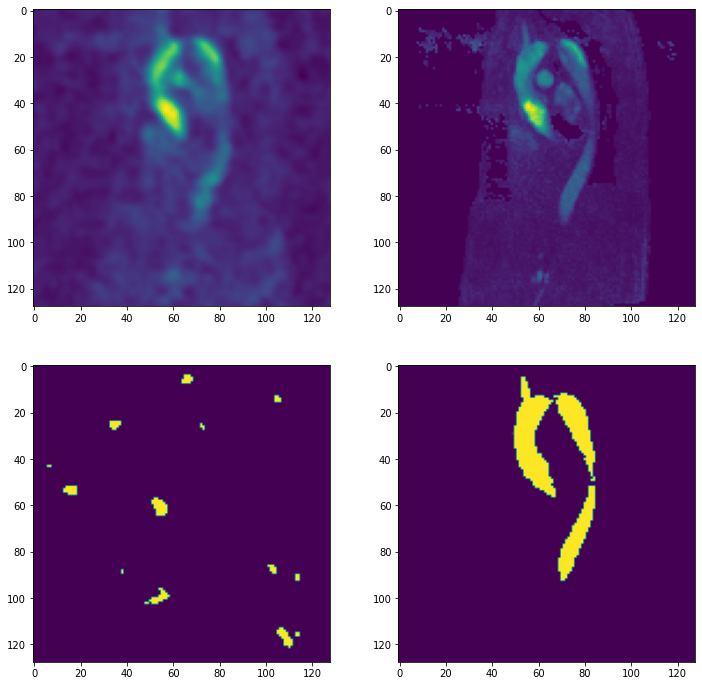

Batch 28 	 pcmra loss: 0.000954 	 mask loss: 0.038777
8.213384417032898e-10
3.064021802856587e-05
0.5984228760004028
0.9999639987945557


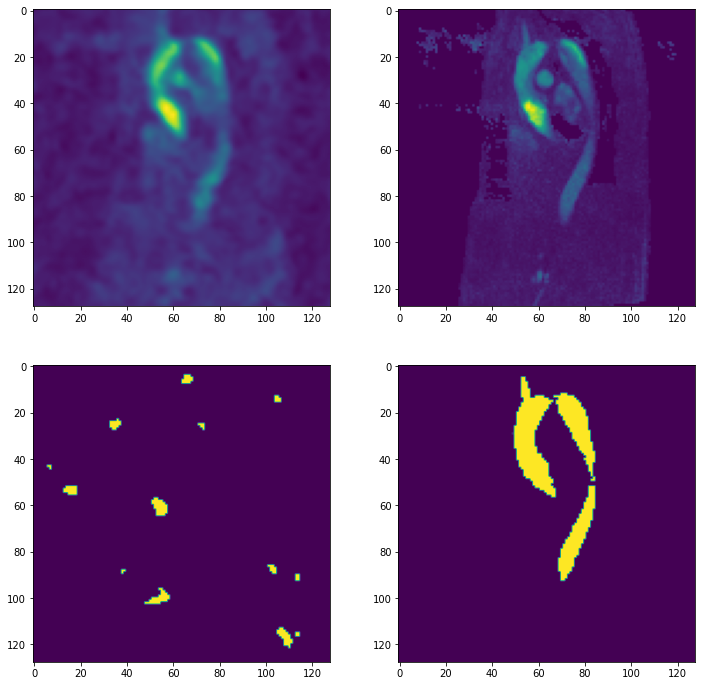

Batch 29 	 pcmra loss: 0.000921 	 mask loss: 0.038728
8.187623357081009e-10
3.0436501219810452e-05
0.5966631561517713
0.9999657869338989


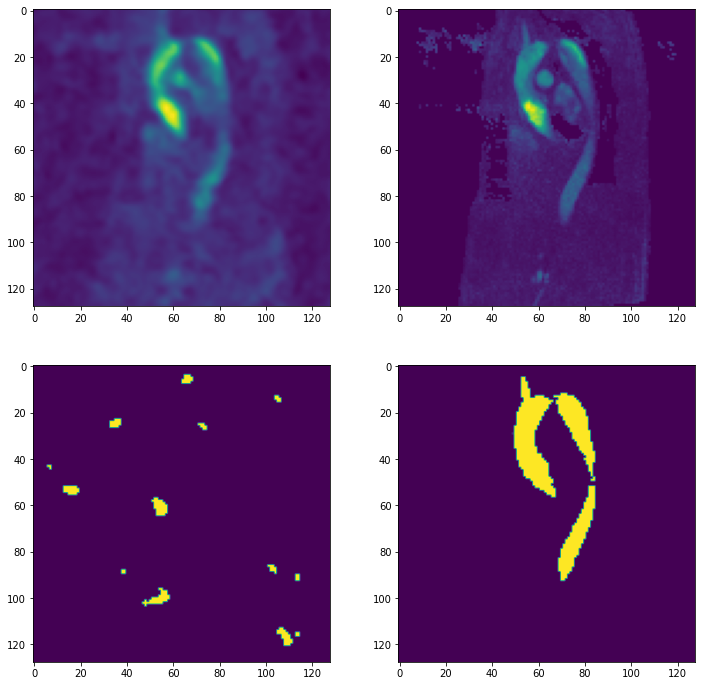

Batch 30 	 pcmra loss: 0.00089 	 mask loss: 0.038673
8.51129611234569e-10
3.021771044586785e-05
0.5938407242298086
0.9999668598175049


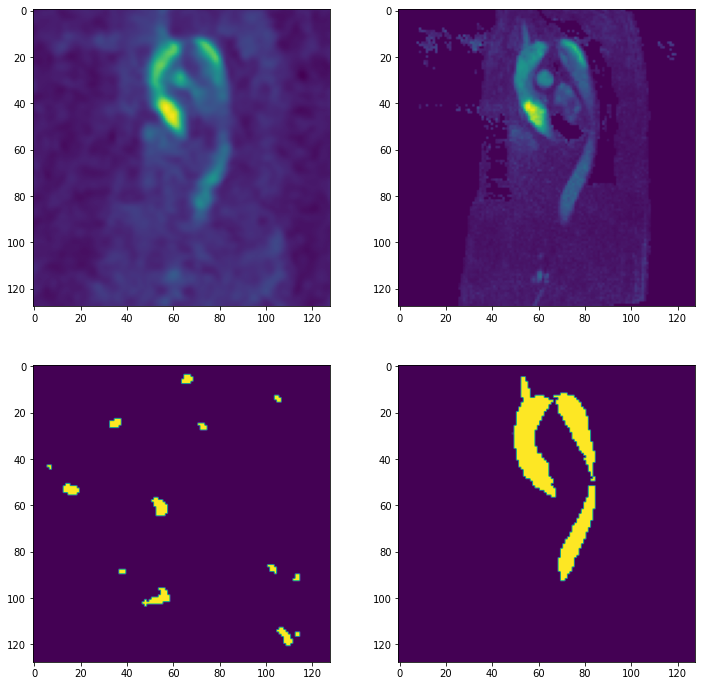

Batch 31 	 pcmra loss: 0.000862 	 mask loss: 0.03863
9.341449835886806e-10
3.0010185582796112e-05
0.5865906566381378
0.9999669790267944


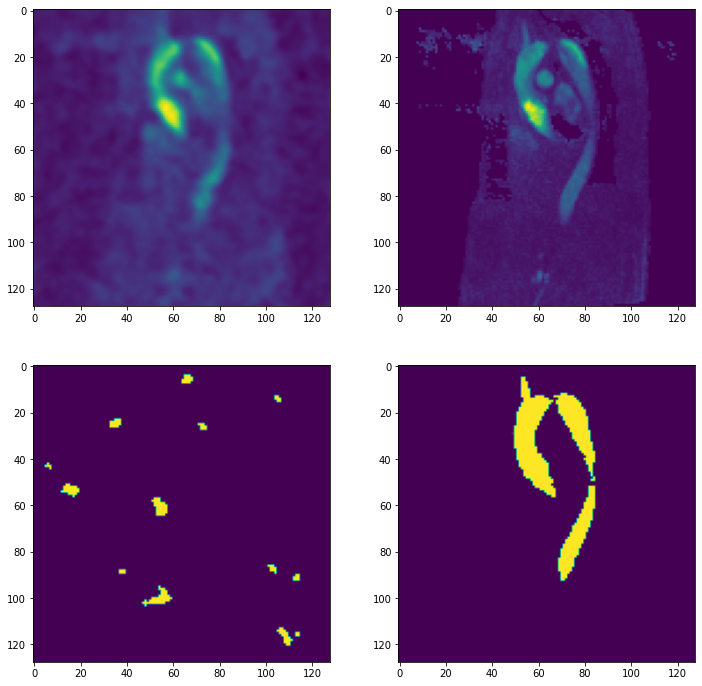

Batch 32 	 pcmra loss: 0.000837 	 mask loss: 0.038618
1.0819398710282258e-09
2.9897122658439912e-05
0.584382355213164
0.999969482421875


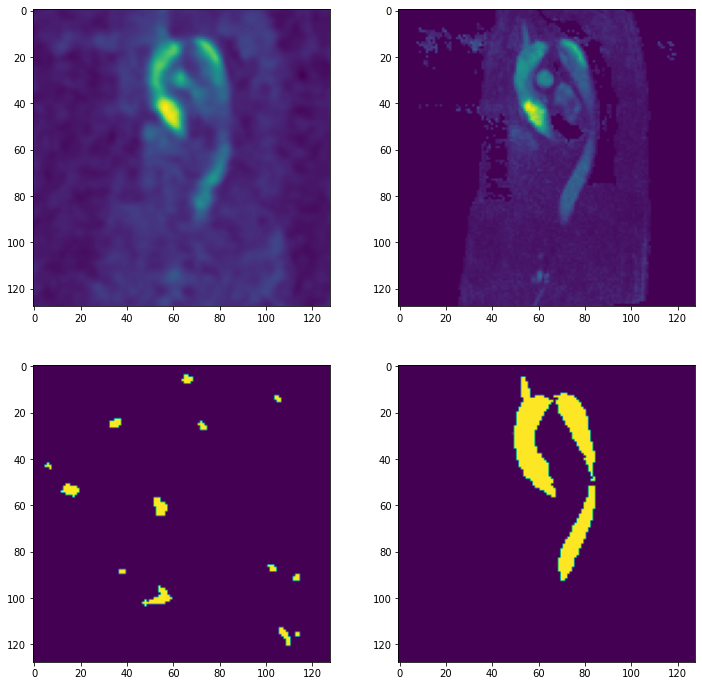

Batch 33 	 pcmra loss: 0.000813 	 mask loss: 0.03865
1.2196708087941488e-09
2.9912206628068816e-05
0.5849452942609762
0.9999709129333496


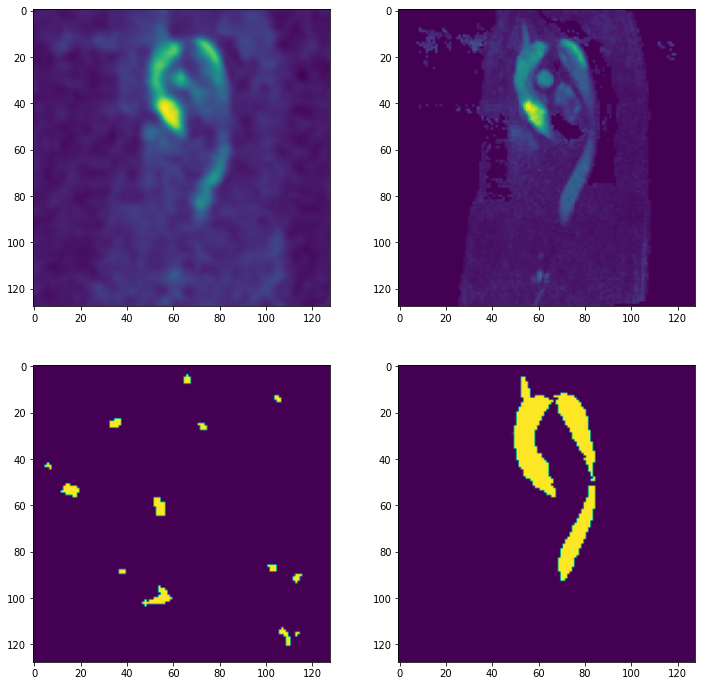

Batch 34 	 pcmra loss: 0.000791 	 mask loss: 0.038729
1.2505247948269016e-09
3.005108010256663e-05
0.5867438763380031
0.9999698400497437


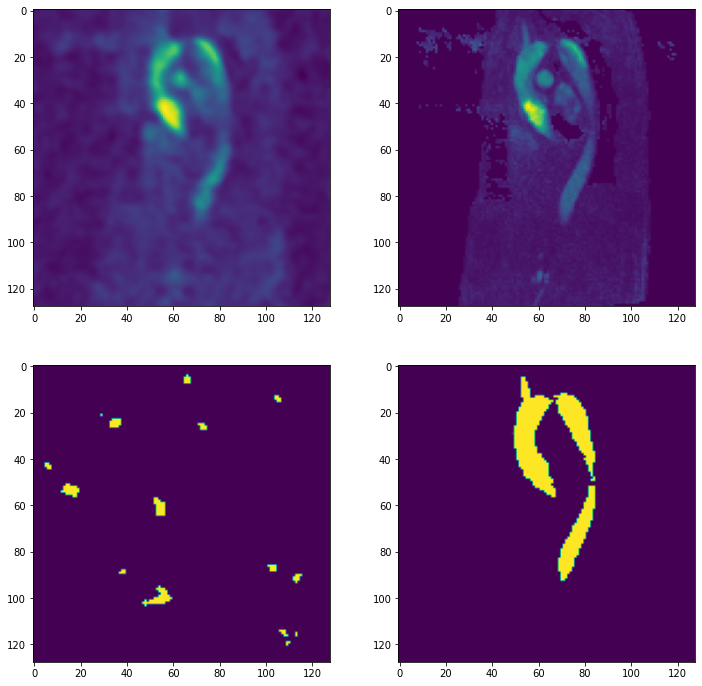

Batch 35 	 pcmra loss: 0.000769 	 mask loss: 0.038841
1.3099989981668614e-09
3.034756809938699e-05
0.5890958607196775
0.9999681711196899


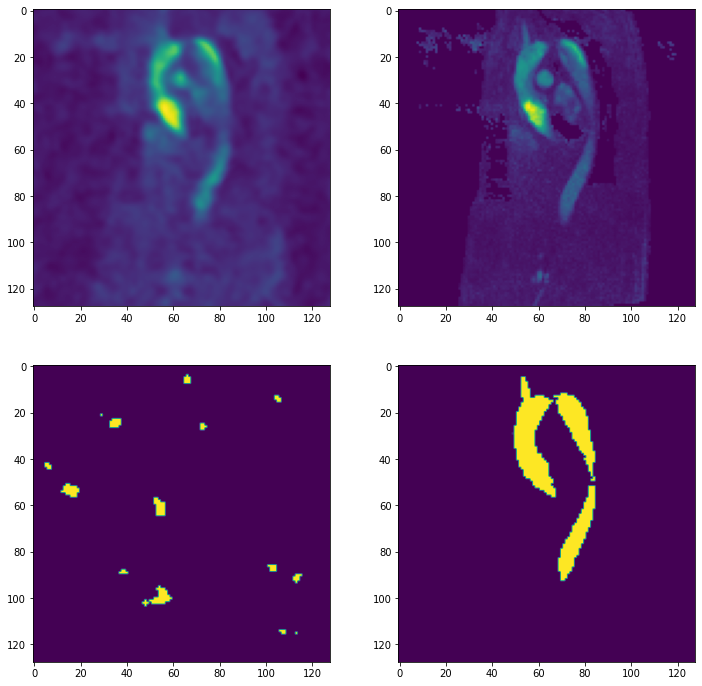

Batch 36 	 pcmra loss: 0.000749 	 mask loss: 0.038966
1.392325921223403e-09
3.070042475883383e-05
0.5994715213775608
0.9999667406082153


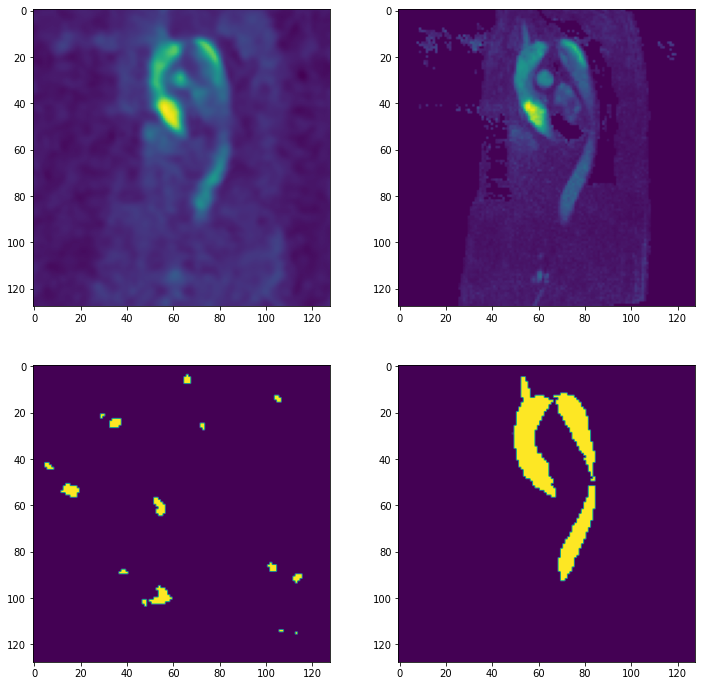

Batch 37 	 pcmra loss: 0.00073 	 mask loss: 0.039079
1.486639145120705e-09
3.102919981756713e-05
0.6055568873882291
0.9999650716781616


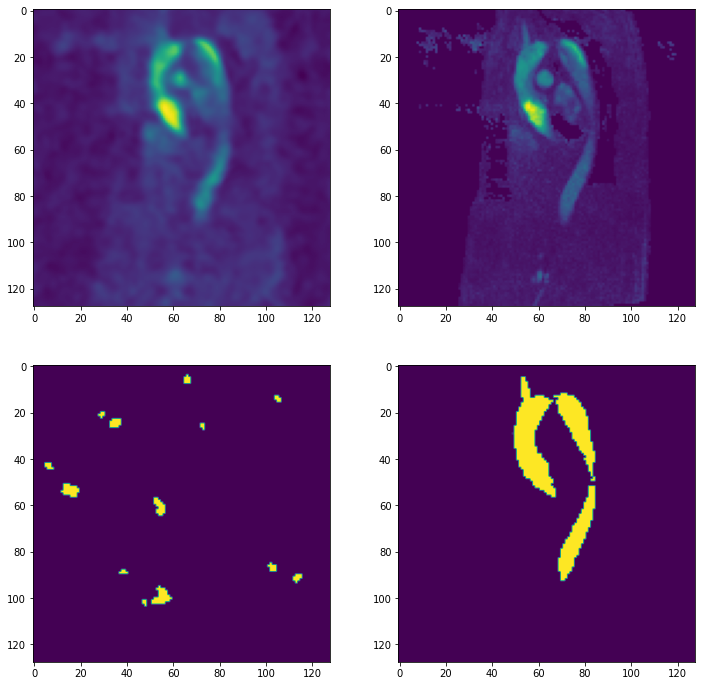

Batch 38 	 pcmra loss: 0.000712 	 mask loss: 0.039157
1.4968850603480632e-09
3.13057371386094e-05
0.6091789275407753
0.9999629259109497


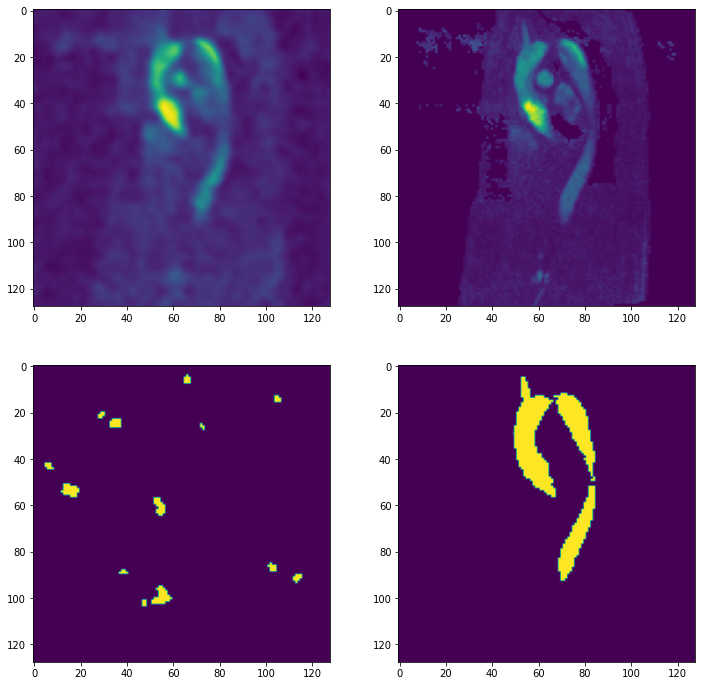

Batch 39 	 pcmra loss: 0.000695 	 mask loss: 0.039189
1.386376791145949e-09
3.147298048133962e-05
0.6114519238471979
0.9999597072601318


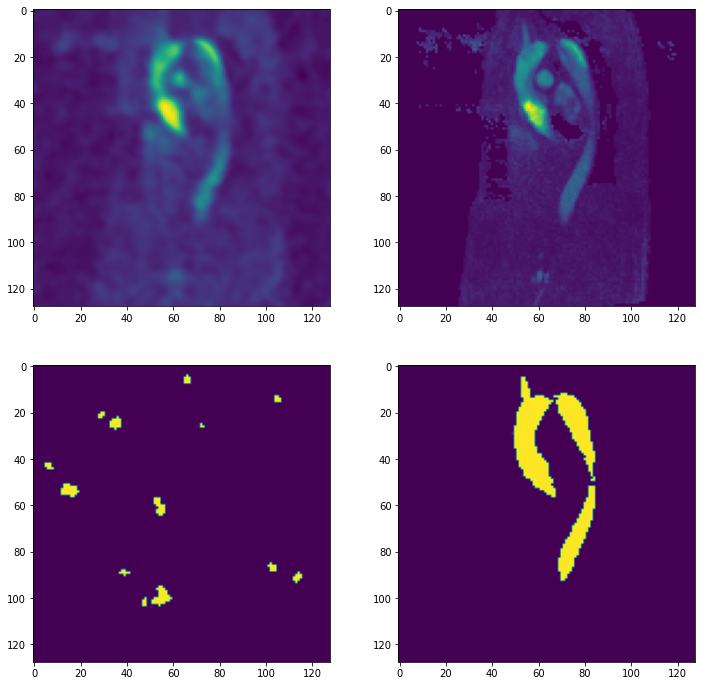

Batch 40 	 pcmra loss: 0.000679 	 mask loss: 0.039171
1.2597344278830747e-09
3.147248753521126e-05
0.6071059018373436
0.999955415725708


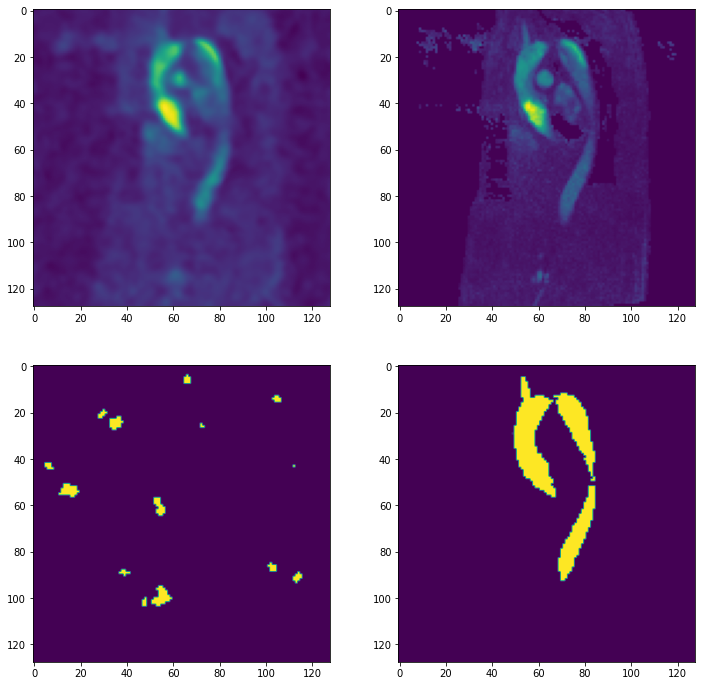

Batch 41 	 pcmra loss: 0.000664 	 mask loss: 0.039116
1.1834674351618446e-09
3.143681897199713e-05
0.6033606201410292
0.9999504089355469


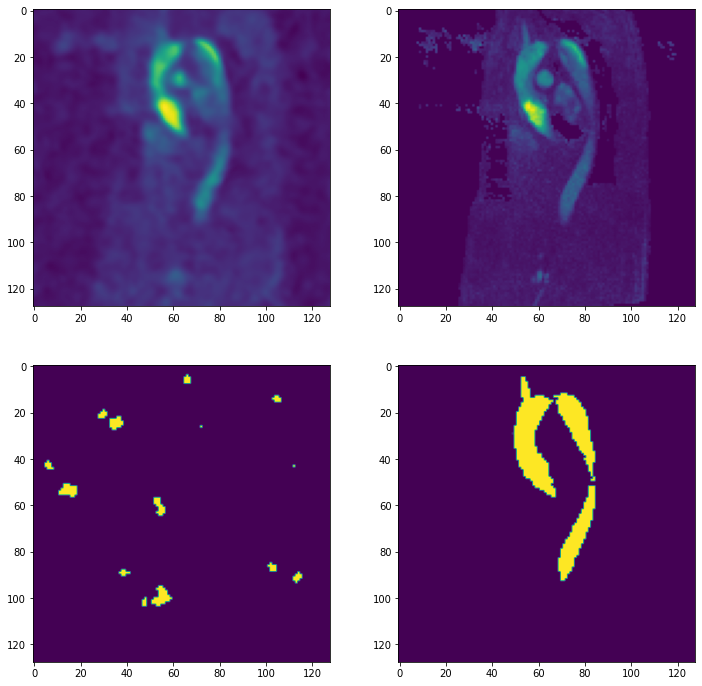

Batch 42 	 pcmra loss: 0.00065 	 mask loss: 0.03904
1.1543757061360793e-09
3.1262641641660593e-05
0.5983619332313476
0.9999465942382812


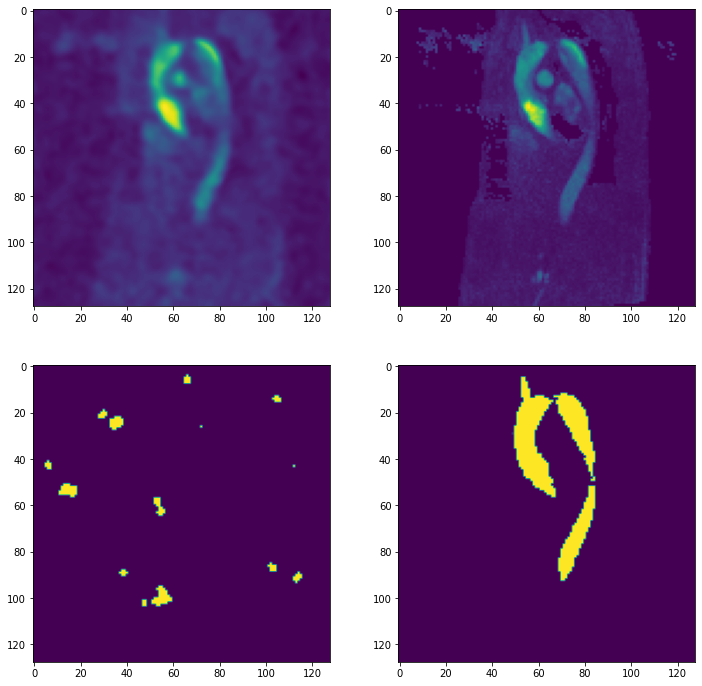

Batch 43 	 pcmra loss: 0.000637 	 mask loss: 0.038967
1.166834184829213e-09
3.1116840546019375e-05
0.5894503802061033
0.999945878982544


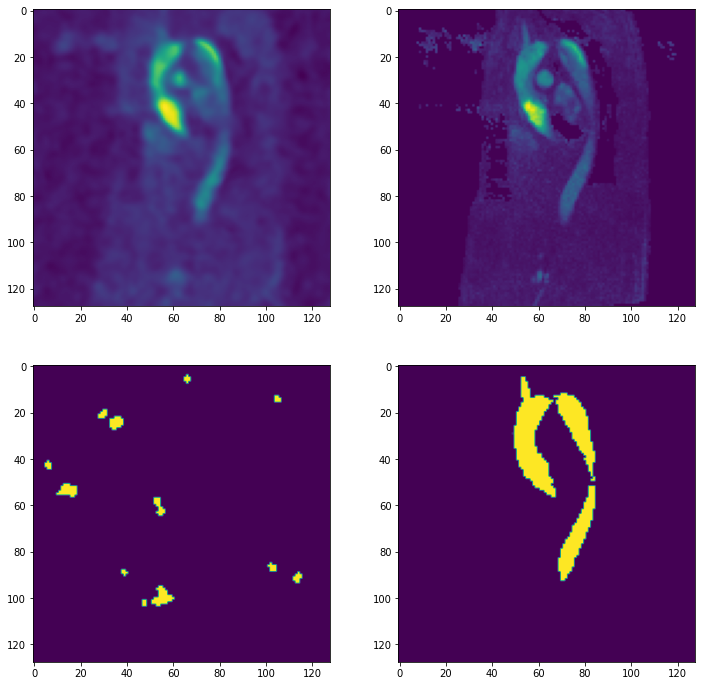

Batch 44 	 pcmra loss: 0.000625 	 mask loss: 0.038919
1.1497588436881756e-09
3.095605097769294e-05
0.5862826853990551
0.9999490976333618


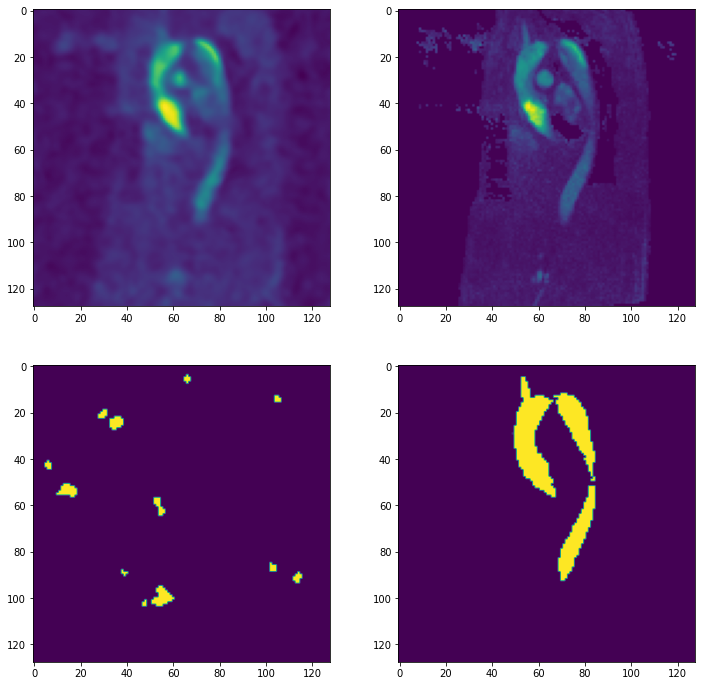

Batch 45 	 pcmra loss: 0.000614 	 mask loss: 0.038906
1.1274452482723518e-09
3.082307557633612e-05
0.5823150247335431
0.9999550580978394


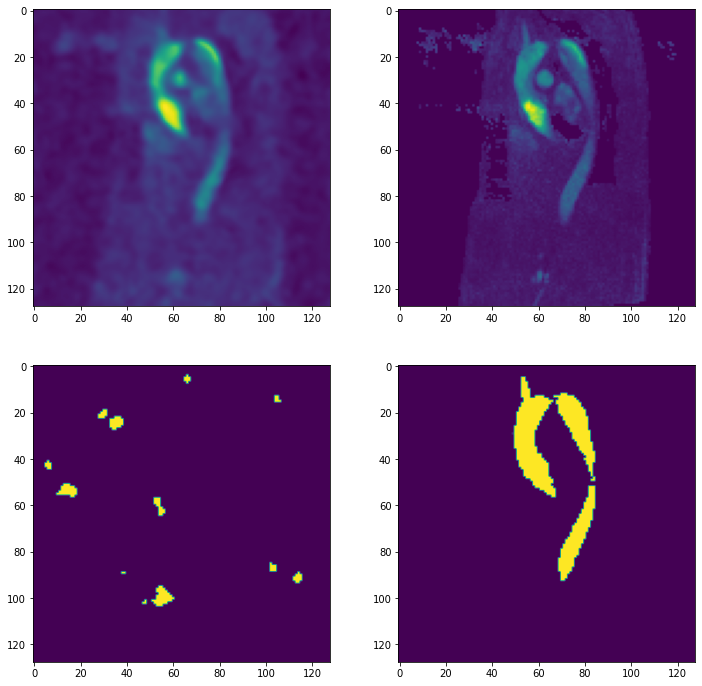

Batch 46 	 pcmra loss: 0.000603 	 mask loss: 0.038924
1.0099129310603416e-09
3.074466440011747e-05
0.5849680483341175
0.9999613761901855


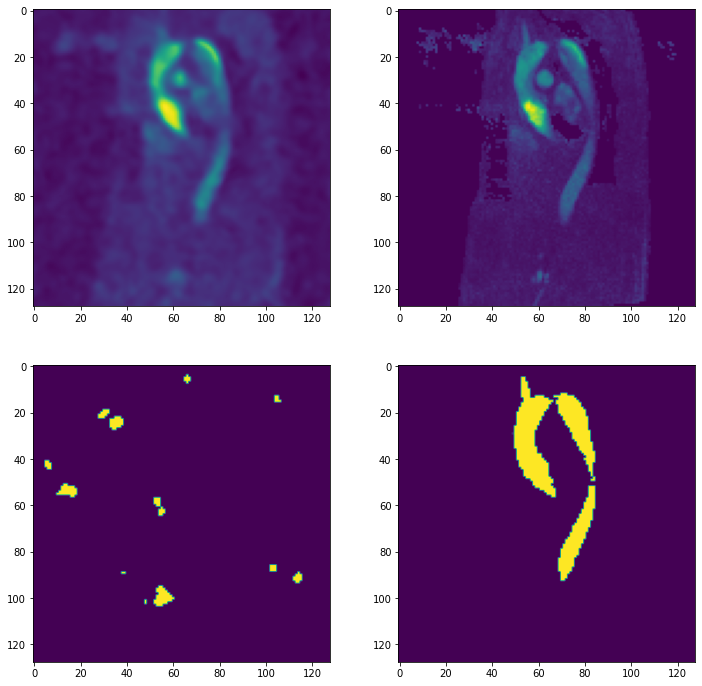

Batch 47 	 pcmra loss: 0.000592 	 mask loss: 0.038951
8.900048475979361e-10
3.071683931921143e-05
0.587900280952451
0.9999665021896362


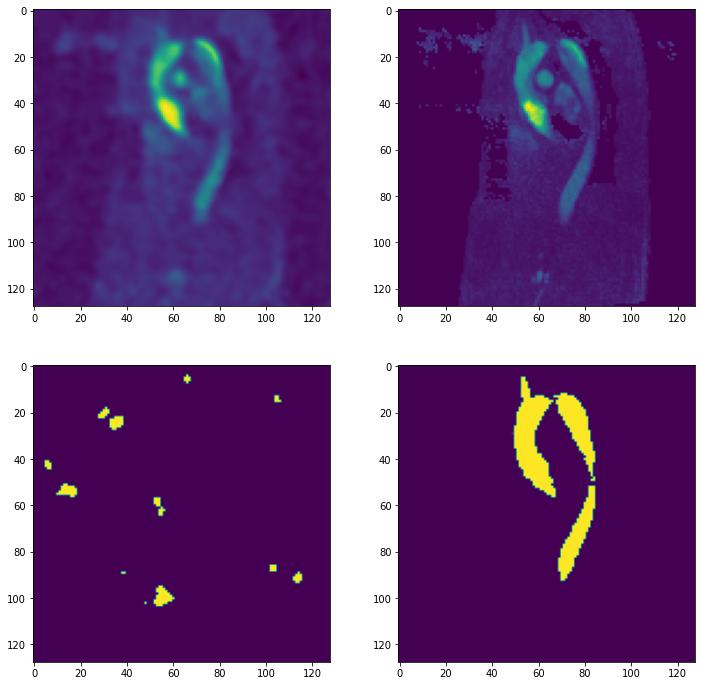

Batch 48 	 pcmra loss: 0.000583 	 mask loss: 0.038959
8.017446151420415e-10
3.061109964619391e-05
0.5879591882228794
0.9999698400497437


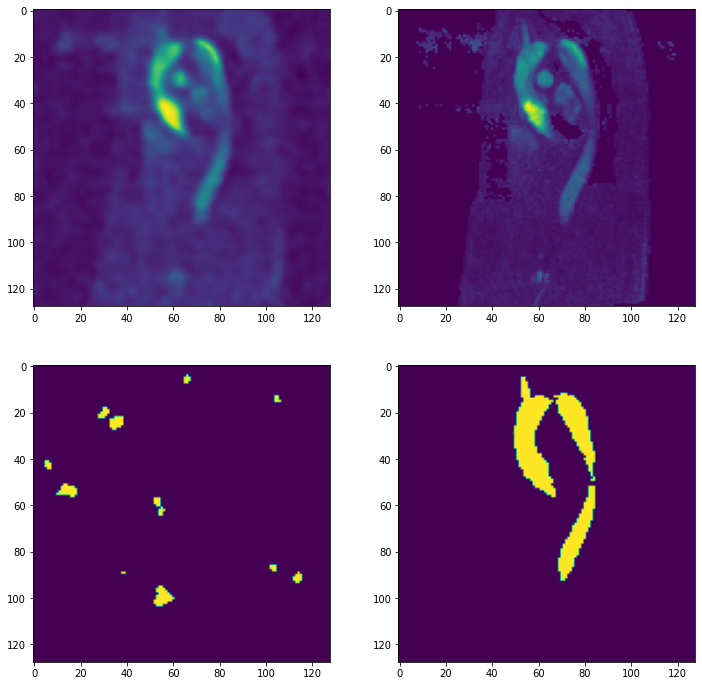

Batch 49 	 pcmra loss: 0.000573 	 mask loss: 0.03893
7.402490287411467e-10
3.0500965294777416e-05
0.5813285201787913
0.9999715089797974


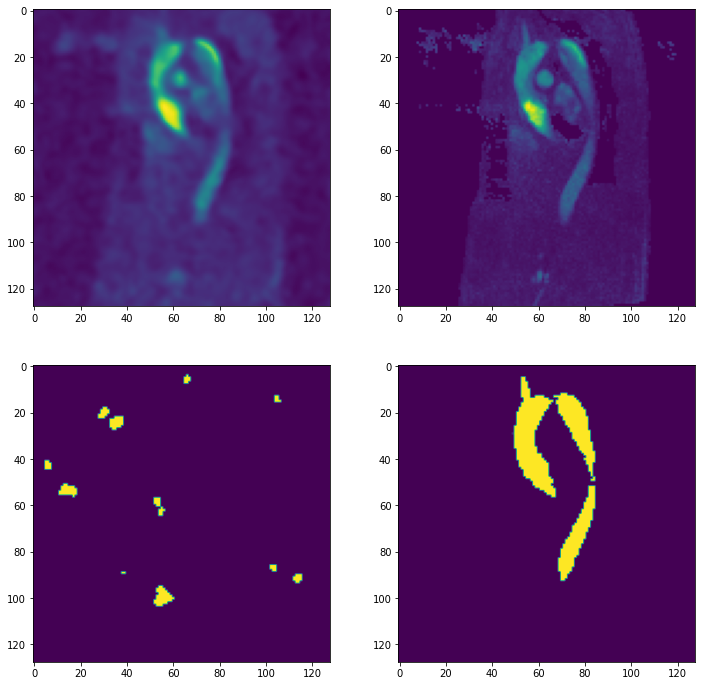

Batch 50 	 pcmra loss: 0.000565 	 mask loss: 0.038862
7.003418955875418e-10
3.0330584195326082e-05
0.5762701481580692
0.9999719858169556


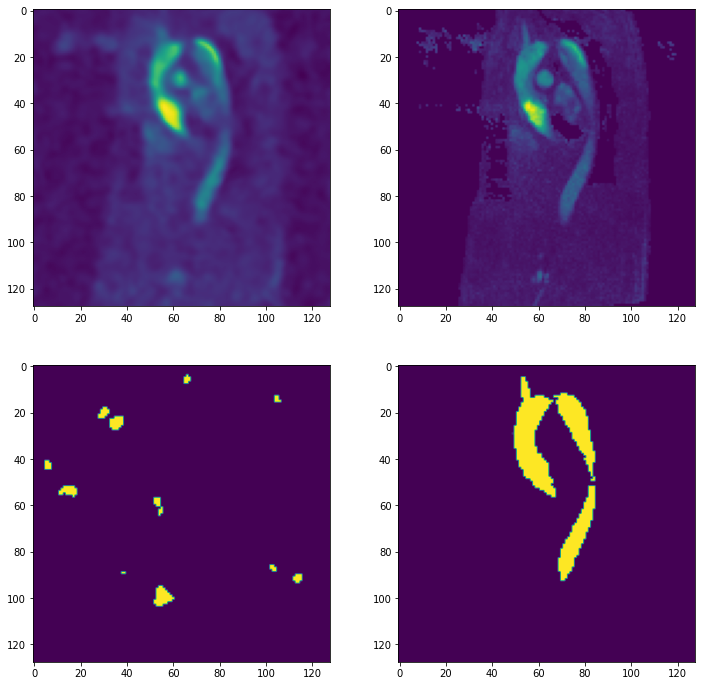

Batch 51 	 pcmra loss: 0.000556 	 mask loss: 0.038774
6.774120153707486e-10
3.0143312869768124e-05
0.5700454533100124
0.9999719858169556


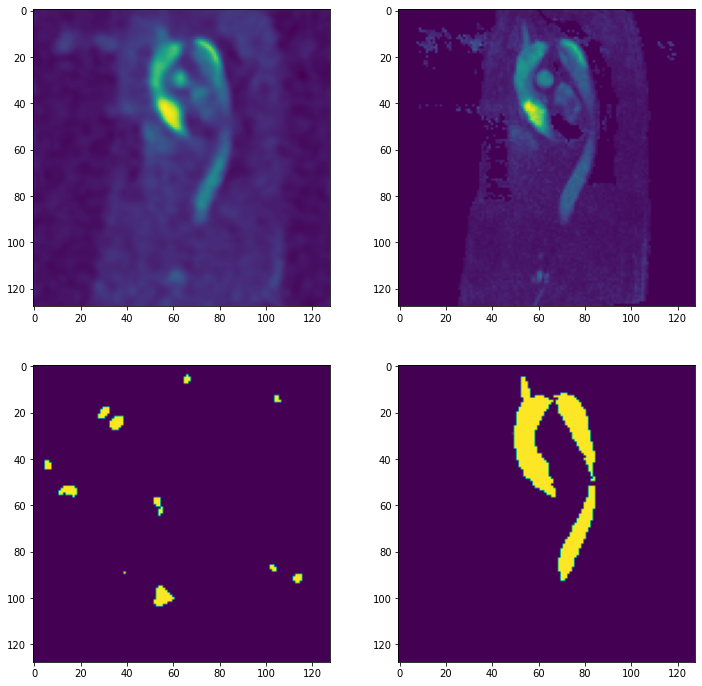

Batch 52 	 pcmra loss: 0.000548 	 mask loss: 0.038693
6.67407240584339e-10
3.0042613616387825e-05
0.5652298718690804
0.9999719858169556


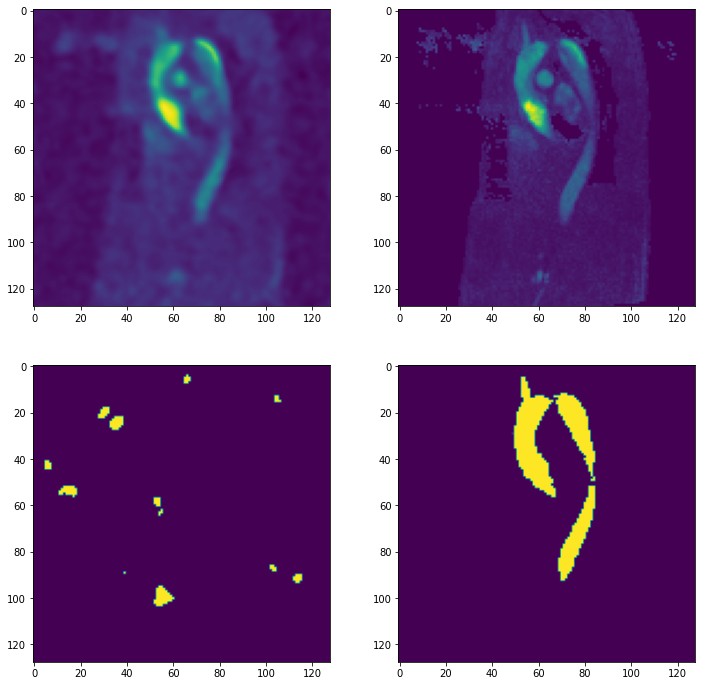

Batch 53 	 pcmra loss: 0.00054 	 mask loss: 0.038637
6.669682584004022e-10
3.0032286304049194e-05
0.5620546847581823
0.9999721050262451


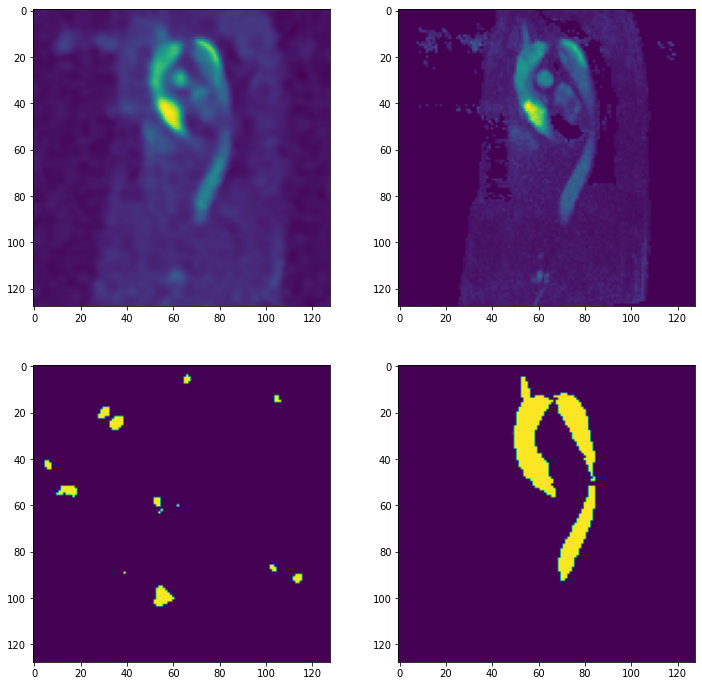

Batch 54 	 pcmra loss: 0.000533 	 mask loss: 0.038609
6.740699109997195e-10
3.009352440130897e-05
0.5609259963035557
0.9999724626541138


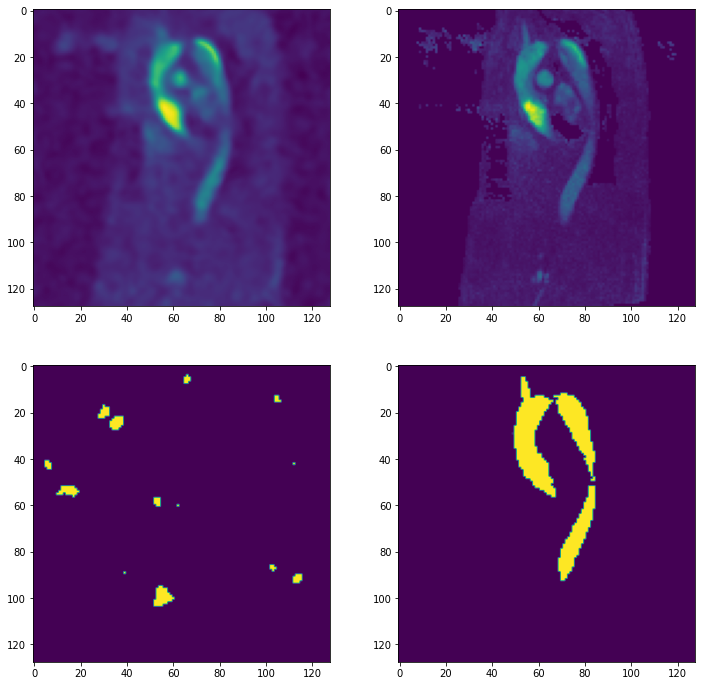

Batch 55 	 pcmra loss: 0.000526 	 mask loss: 0.038597
6.885588765825901e-10
3.0146446988510434e-05
0.5602431565523122
0.9999728202819824


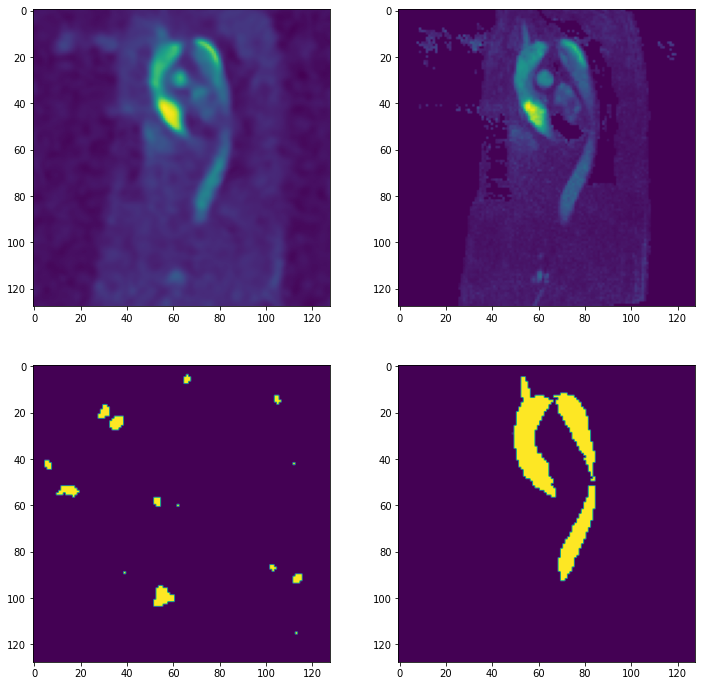

Batch 56 	 pcmra loss: 0.00052 	 mask loss: 0.038585
7.110897981554842e-10
3.0171729122230317e-05
0.5577528834342955
0.999972939491272


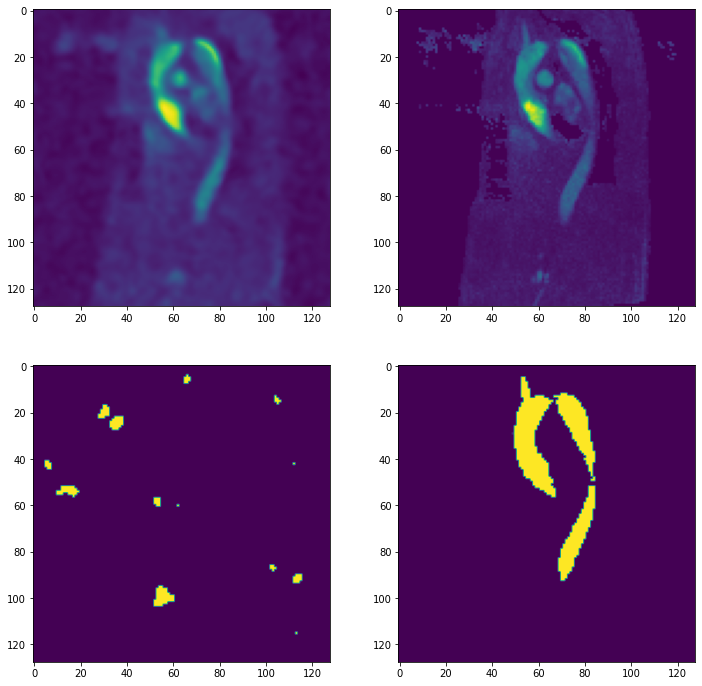

Batch 57 	 pcmra loss: 0.000513 	 mask loss: 0.038567
7.414995284449333e-10
3.0203425012587104e-05
0.5569700688123702
0.9999730587005615


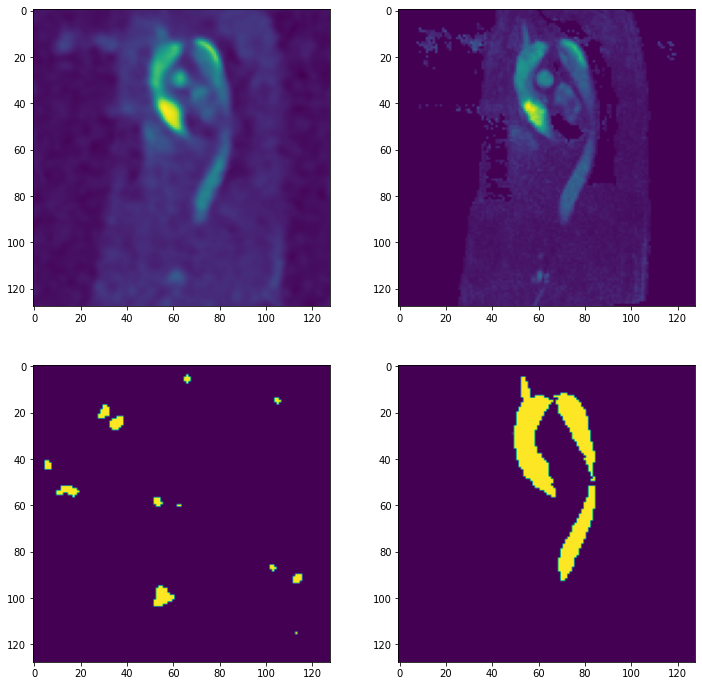

Batch 58 	 pcmra loss: 0.000507 	 mask loss: 0.038548
7.779376032246432e-10
3.0179698114807252e-05
0.5553590625524437
0.9999734163284302


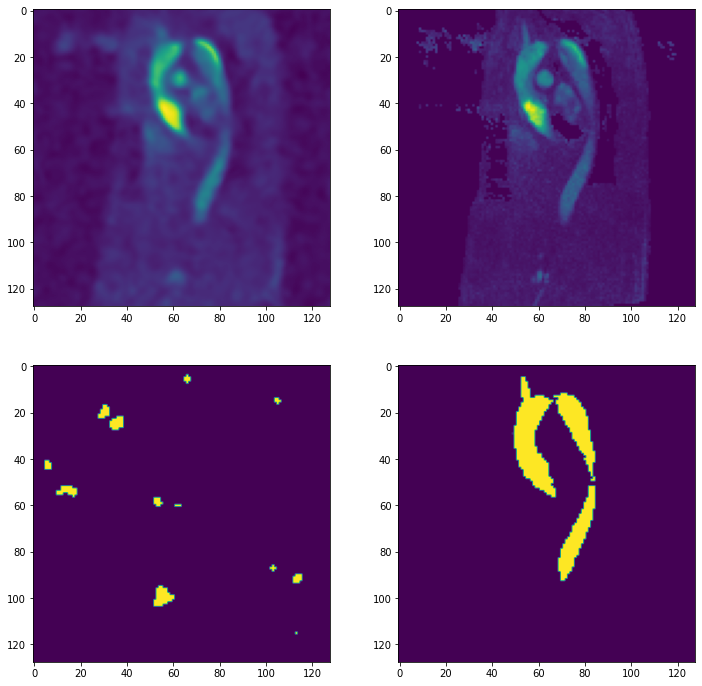

Batch 59 	 pcmra loss: 0.000501 	 mask loss: 0.038541
8.179038002431582e-10
3.017523886228446e-05
0.5539773136377308
0.9999741315841675


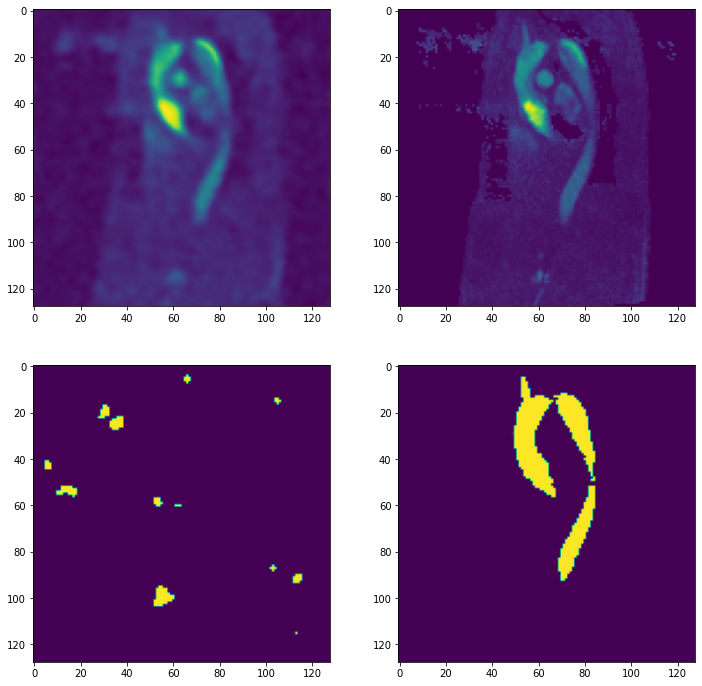

Batch 60 	 pcmra loss: 0.000496 	 mask loss: 0.038556
8.480879887251547e-10
3.0219011023291387e-05
0.5543526619672768
0.999975323677063


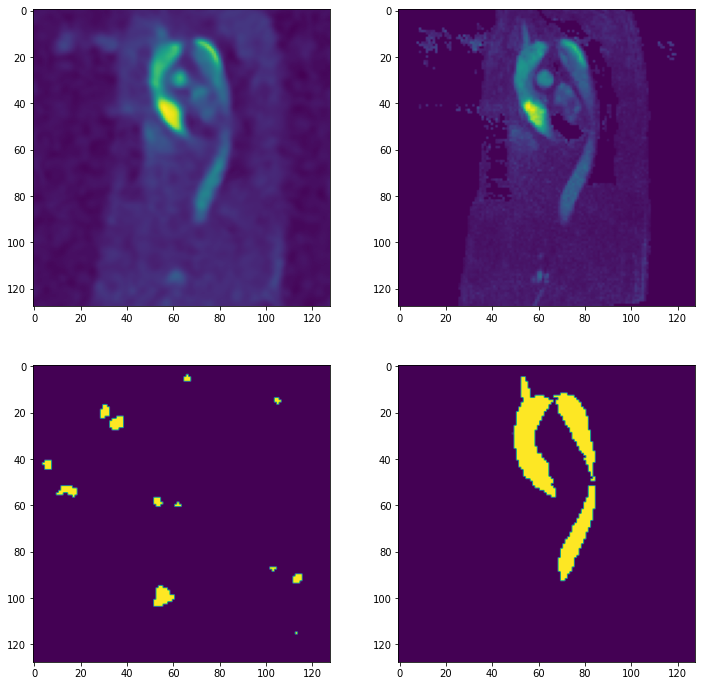

Batch 61 	 pcmra loss: 0.000491 	 mask loss: 0.038588
8.702141784944217e-10
3.0331322705023922e-05
0.5571266204118689
0.9999769926071167


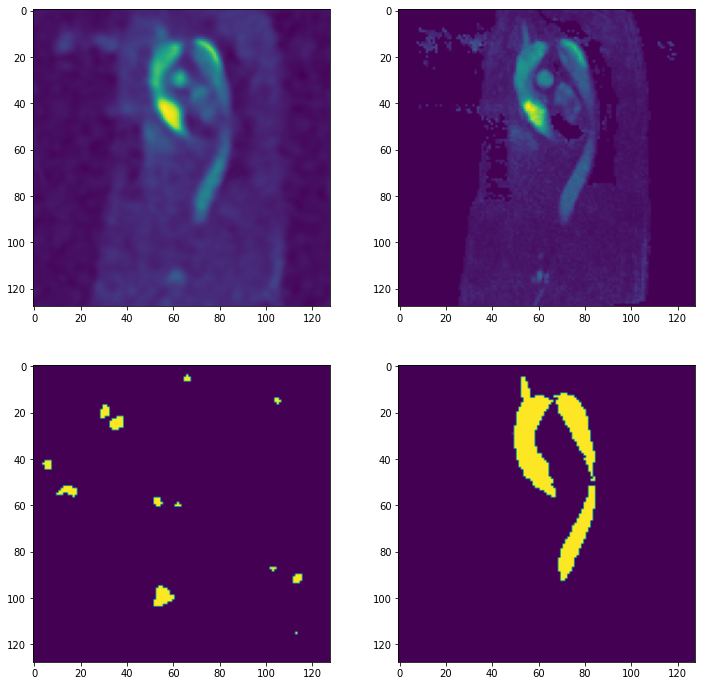

Batch 62 	 pcmra loss: 0.000486 	 mask loss: 0.038622
9.049244131809075e-10
3.0491817597066984e-05
0.5596698820590899
0.9999785423278809


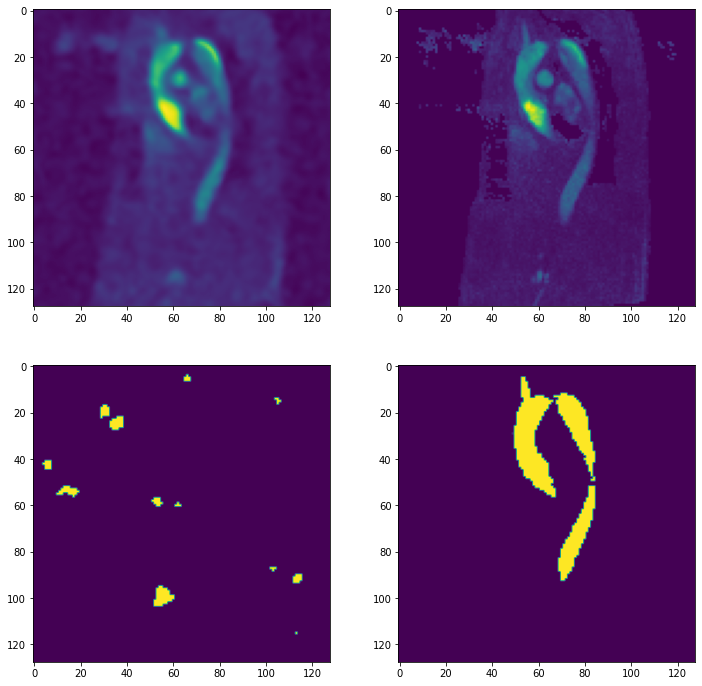

Batch 63 	 pcmra loss: 0.000481 	 mask loss: 0.03864
9.588344562772022e-10
3.0586075808969326e-05
0.561089518666266
0.9999797344207764


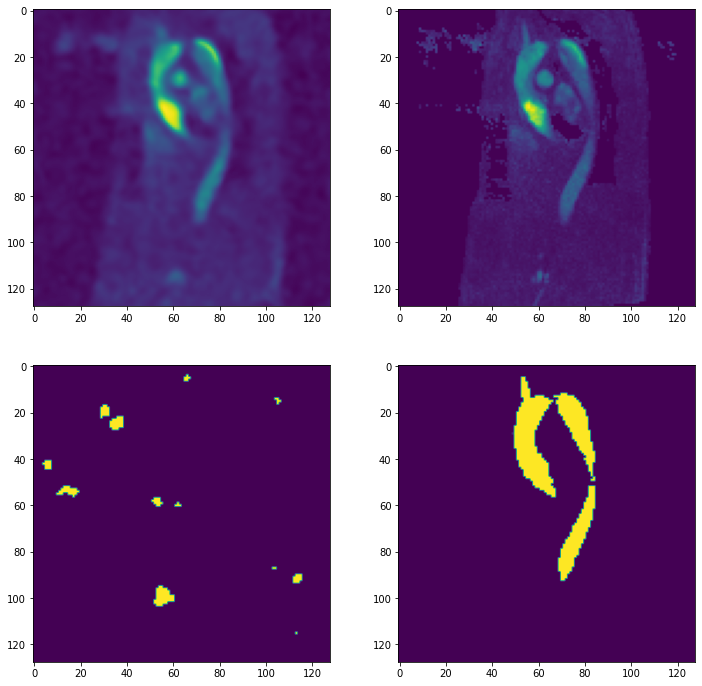

Batch 64 	 pcmra loss: 0.000476 	 mask loss: 0.038634
1.0208940359746066e-09
3.0578596124541946e-05
0.5604645520448674
0.9999805688858032


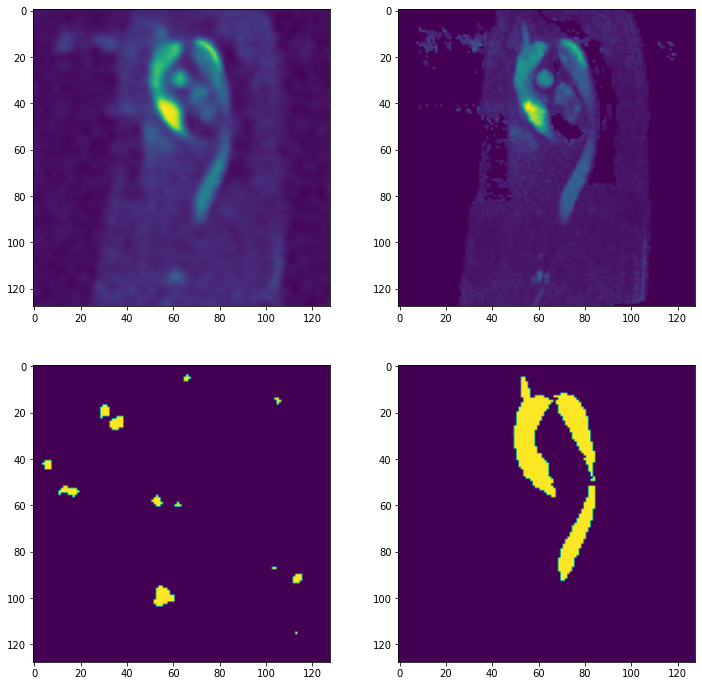

Batch 65 	 pcmra loss: 0.000471 	 mask loss: 0.038608
9.901696129688276e-10
3.0518858693540096e-05
0.5589589297771441
0.9999808073043823


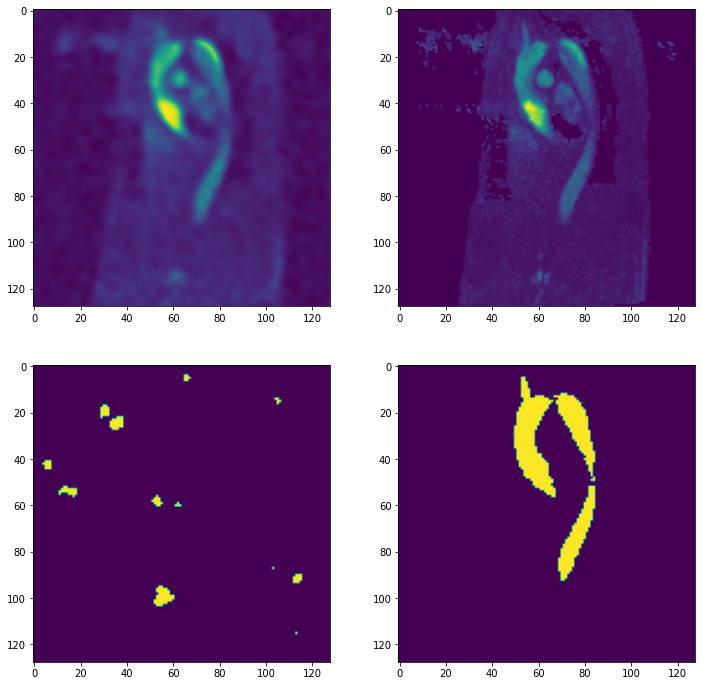

Batch 66 	 pcmra loss: 0.000467 	 mask loss: 0.038575
9.663306821394713e-10
3.044608183699893e-05
0.5566993266344061
0.9999808073043823


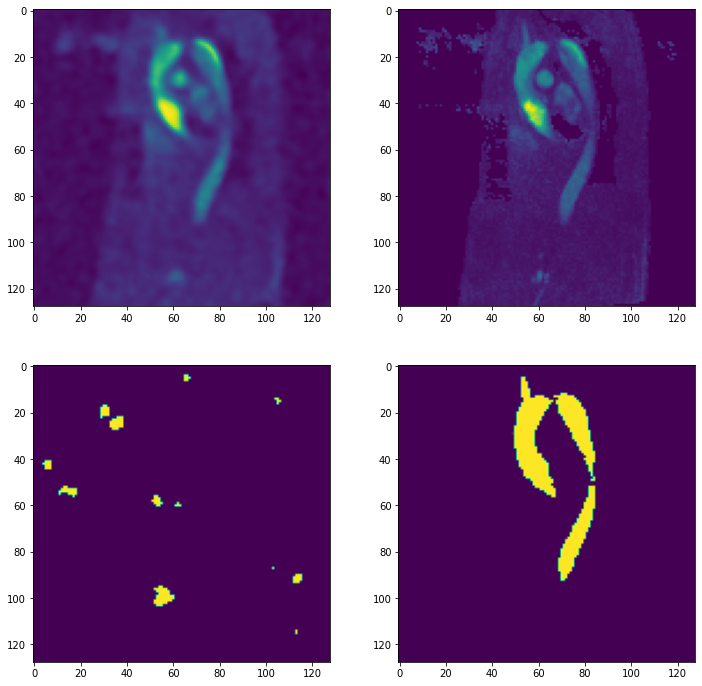

Batch 67 	 pcmra loss: 0.000463 	 mask loss: 0.038544
9.49869627397959e-10
3.0397459340747446e-05
0.5544891417026516
0.9999806880950928


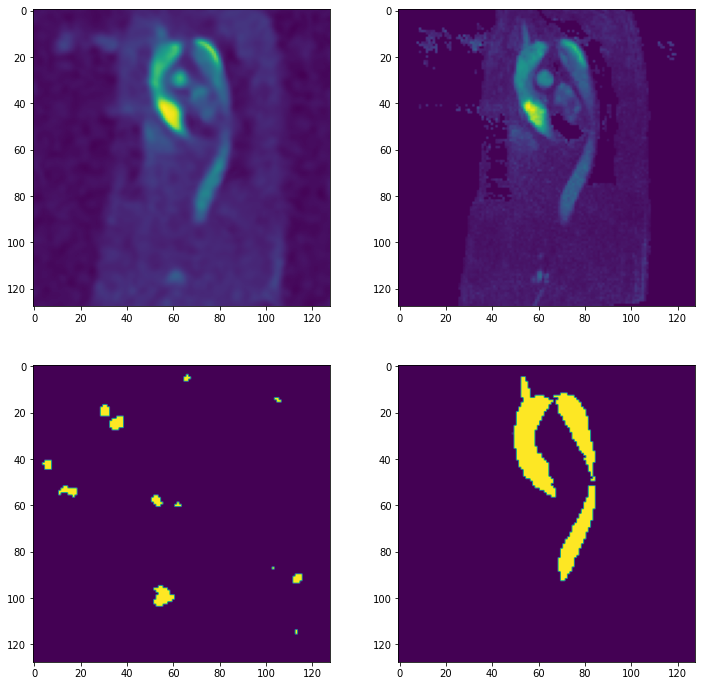

Batch 68 	 pcmra loss: 0.000459 	 mask loss: 0.038521
9.397222999751875e-10
3.039380862901453e-05
0.5530137628316852
0.9999806880950928


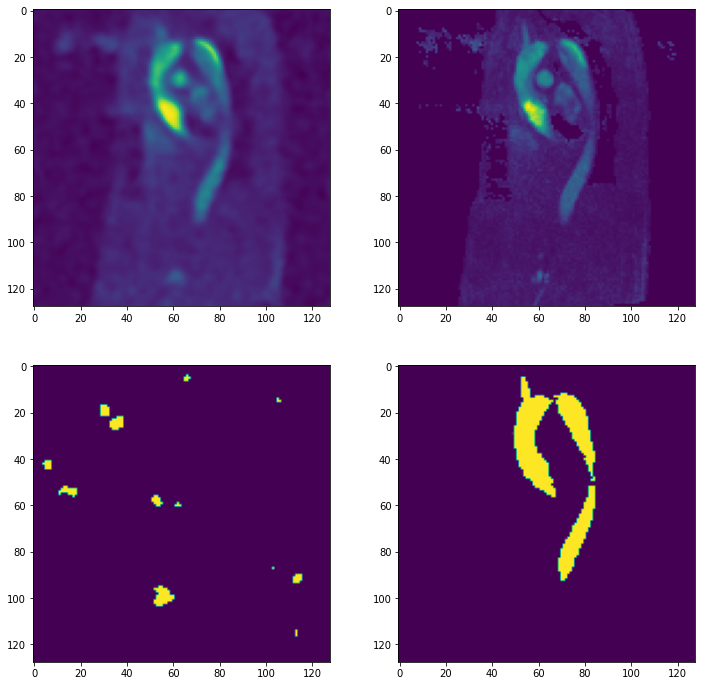

Batch 69 	 pcmra loss: 0.000455 	 mask loss: 0.038504
9.352556507025156e-10
3.0447666176769417e-05
0.5510526508092811
0.9999805688858032


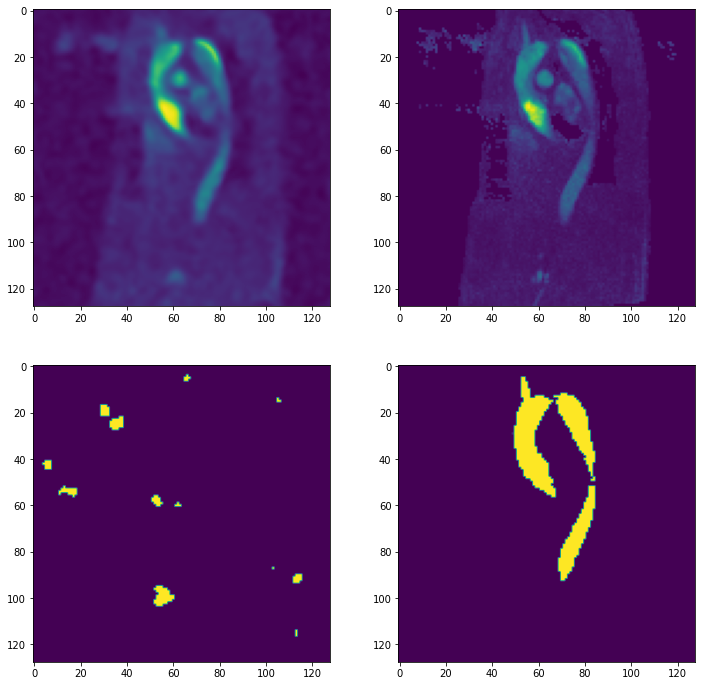

Batch 70 	 pcmra loss: 0.000451 	 mask loss: 0.038488
9.370787479312526e-10
3.0451338716375176e-05
0.55089075565338
0.9999802112579346


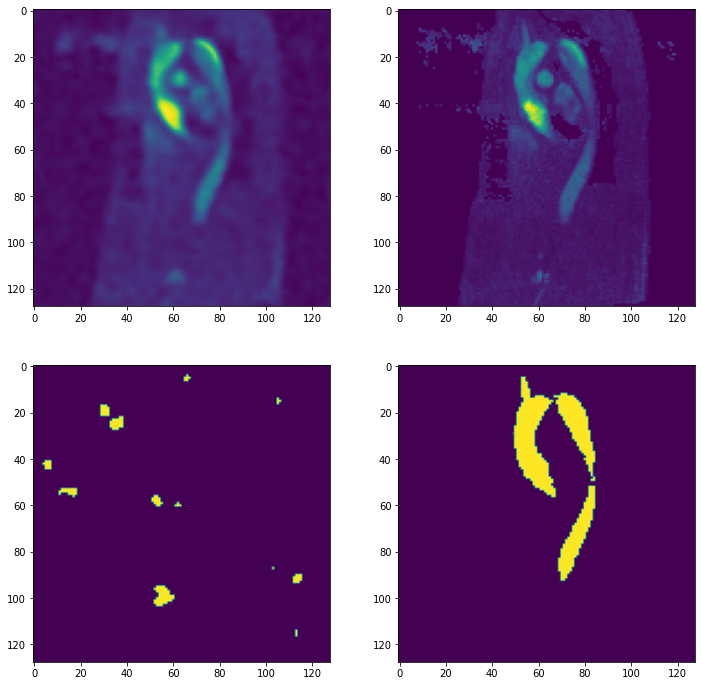

Batch 71 	 pcmra loss: 0.000448 	 mask loss: 0.038474
9.321337035572697e-10
3.040908541152021e-05
0.5499964386224742
0.9999796152114868


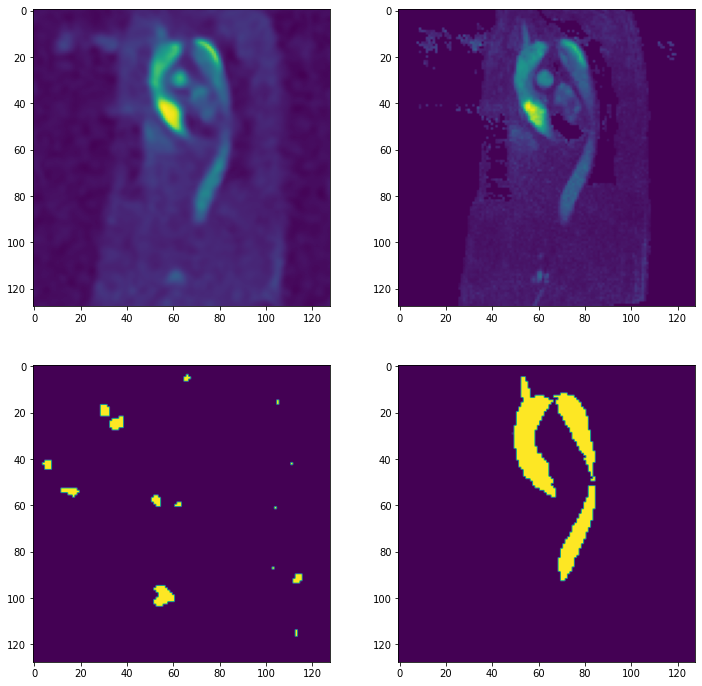

Batch 72 	 pcmra loss: 0.000444 	 mask loss: 0.038461
8.92495244375624e-10
3.040917272301158e-05
0.5475897461175838
0.99997878074646


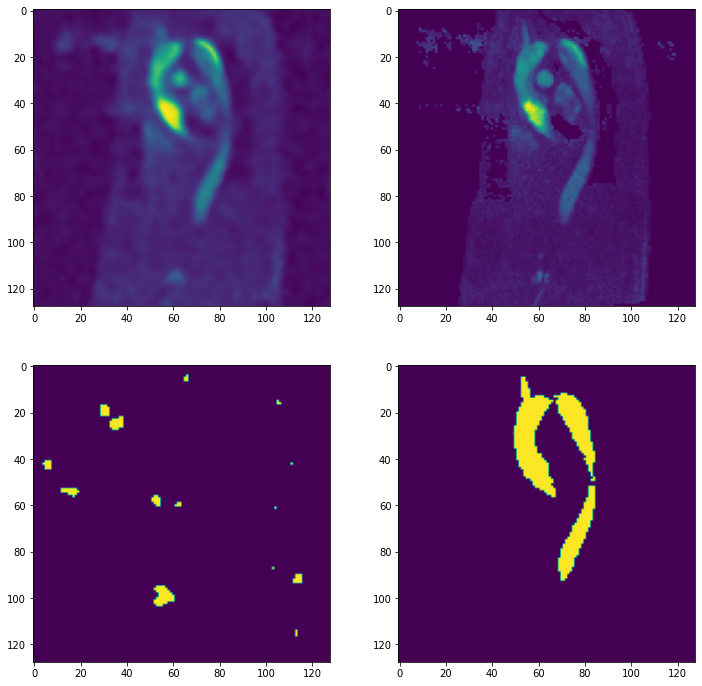

Batch 73 	 pcmra loss: 0.000441 	 mask loss: 0.038453
8.545505414403465e-10
3.0421614610531833e-05
0.5469157040119135
0.9999775886535645


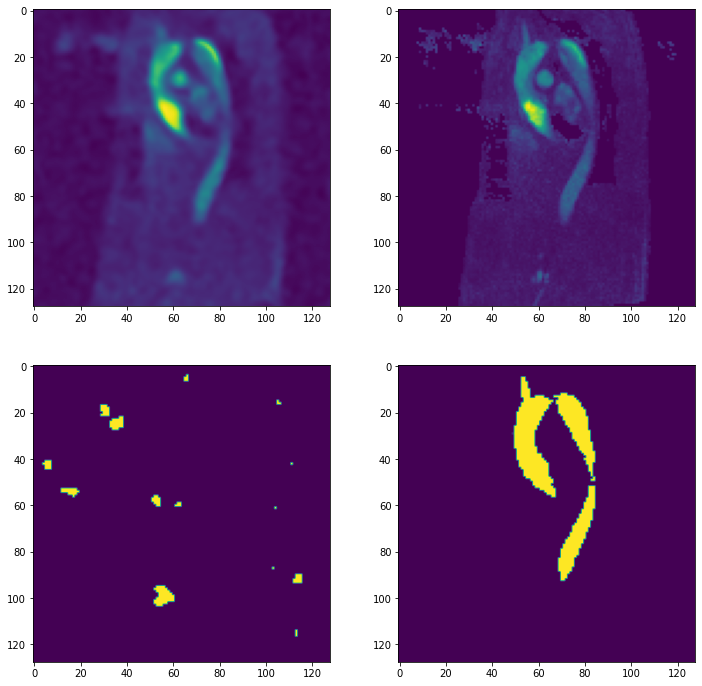

Batch 74 	 pcmra loss: 0.000438 	 mask loss: 0.038448
8.174468879573737e-10
3.040296633116668e-05
0.546462485194205
0.999976396560669


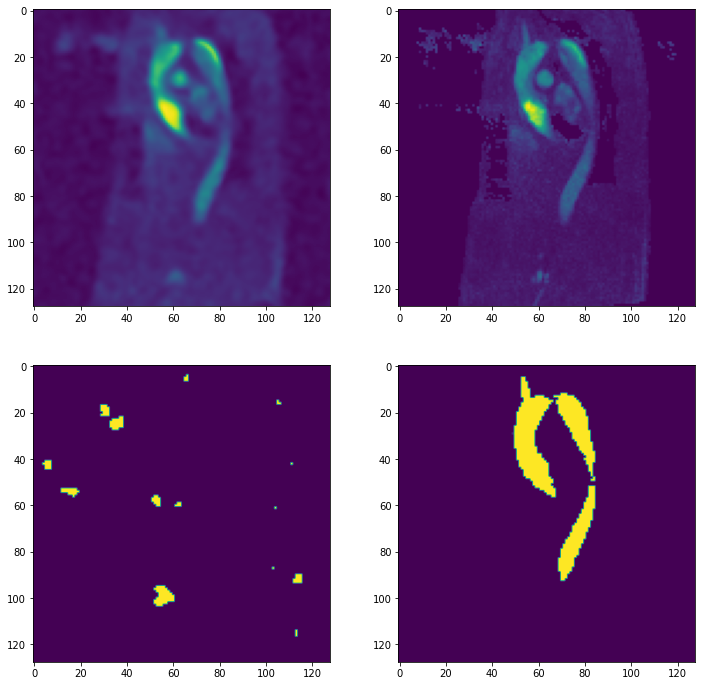

Batch 75 	 pcmra loss: 0.000435 	 mask loss: 0.038443
7.802067325535234e-10
3.0382431759790052e-05
0.5463100522756522
0.9999752044677734


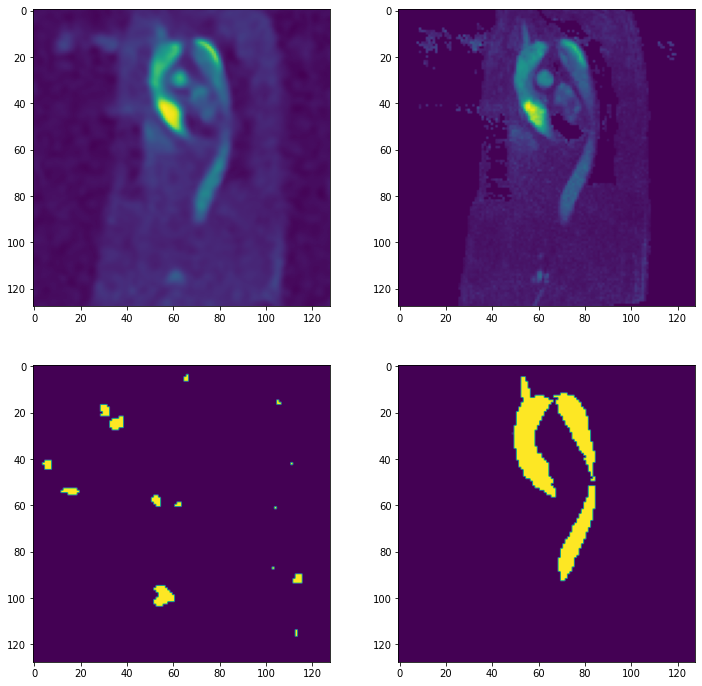

Batch 76 	 pcmra loss: 0.000432 	 mask loss: 0.038434
7.428543336018834e-10
3.0376276299648453e-05
0.5479394555091854
0.9999752044677734


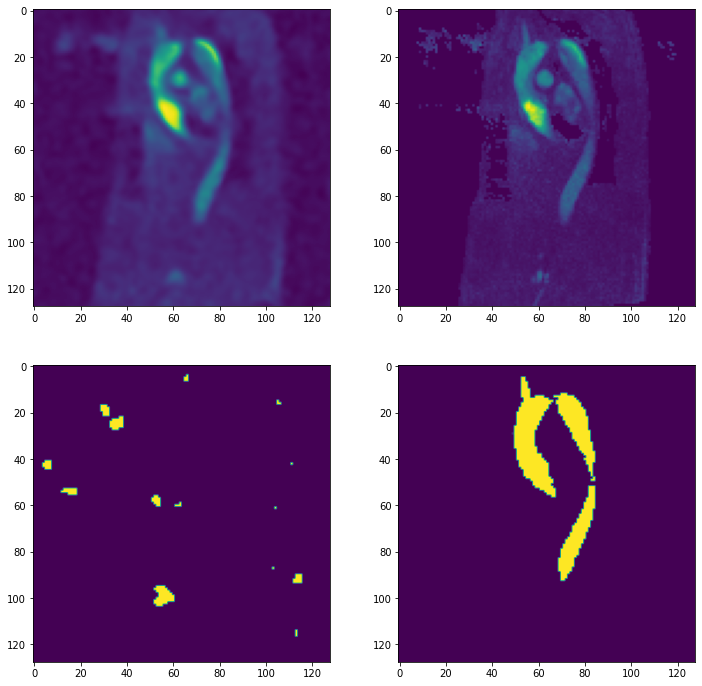

Batch 77 	 pcmra loss: 0.000429 	 mask loss: 0.03842
7.067427199025644e-10
3.0338813303387724e-05
0.5474072575569117
0.999976396560669


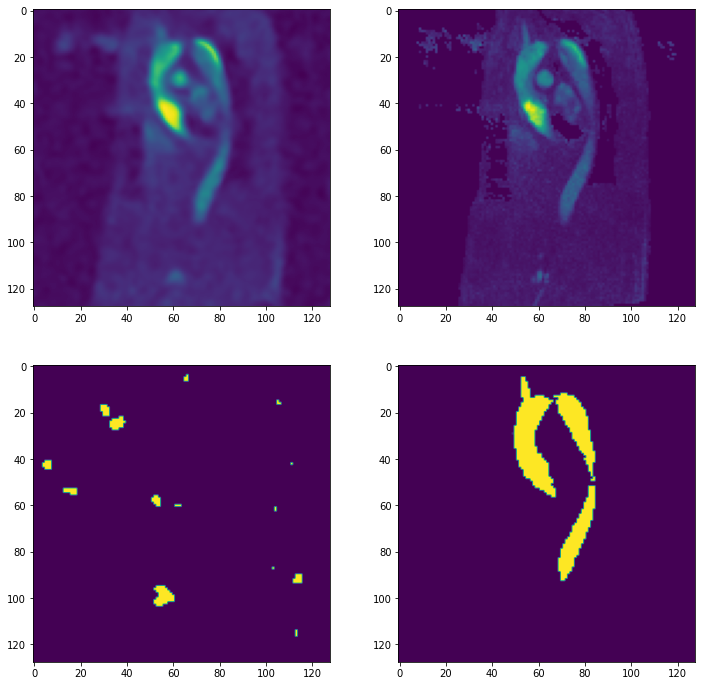

Batch 78 	 pcmra loss: 0.000426 	 mask loss: 0.038404
6.734505175742811e-10
3.030111111002043e-05
0.545130395889281
0.9999774694442749


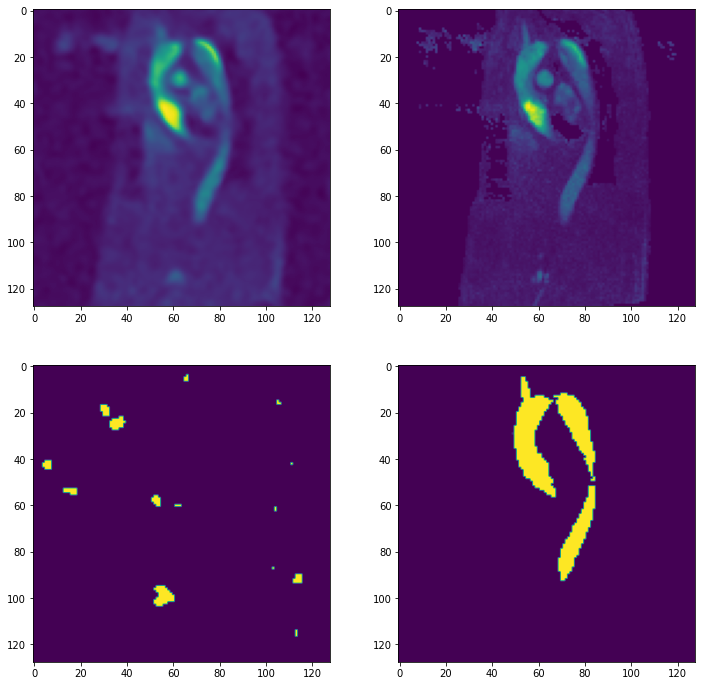

Batch 79 	 pcmra loss: 0.000423 	 mask loss: 0.03839
6.437003152726106e-10
3.0285361390269827e-05
0.5439098626375168
0.9999786615371704


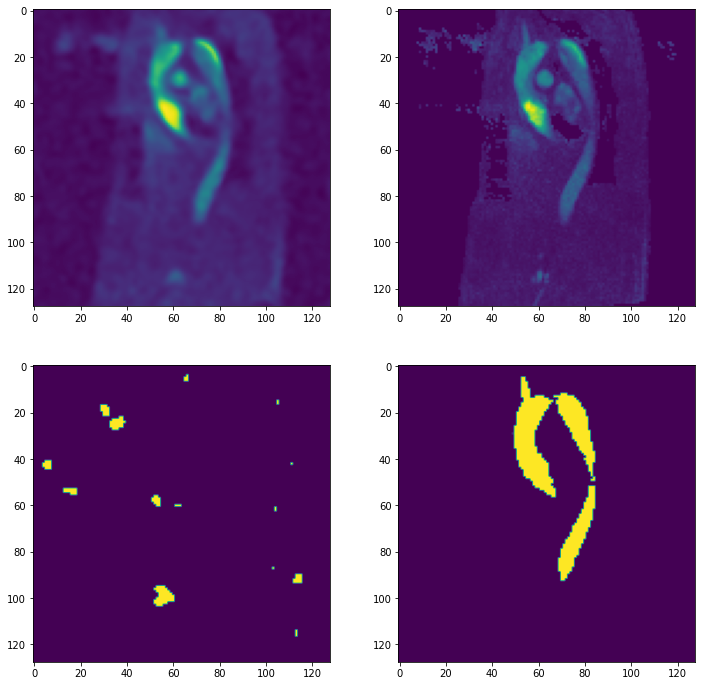

Batch 80 	 pcmra loss: 0.00042 	 mask loss: 0.038382
6.172060640352584e-10
3.0272602089098655e-05
0.5440448731184006
0.9999797344207764


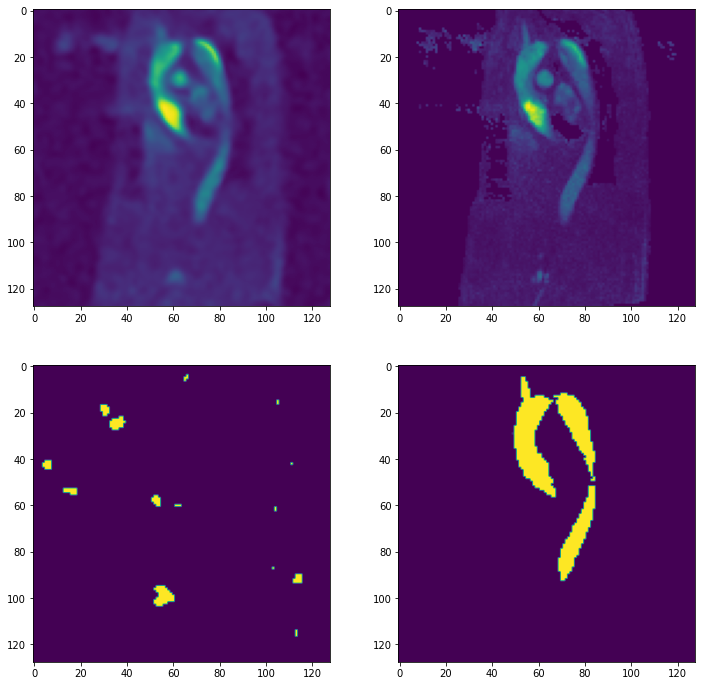

Batch 81 	 pcmra loss: 0.000418 	 mask loss: 0.038382
5.933598057339395e-10
3.0278331905719824e-05
0.5423035204410551
0.9999808073043823


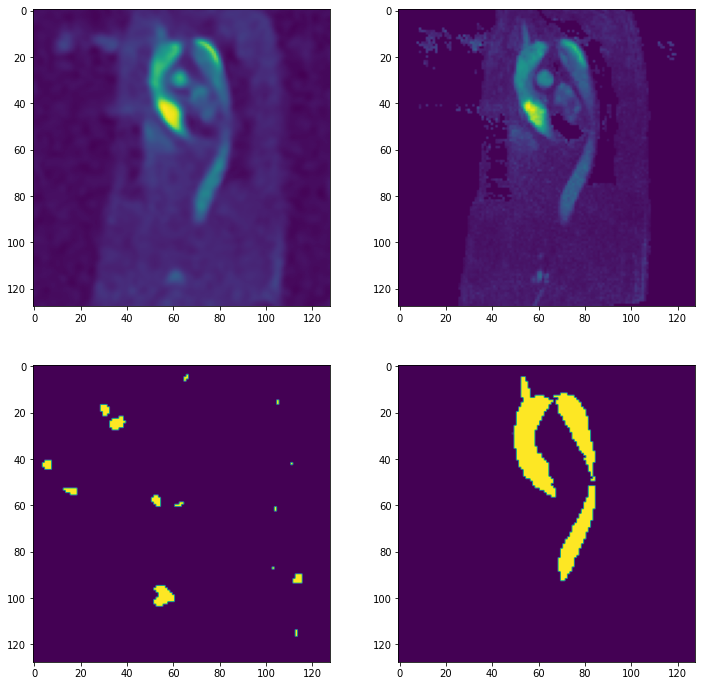

Batch 82 	 pcmra loss: 0.000415 	 mask loss: 0.038389
5.721357276833317e-10
3.0289843380160164e-05
0.5419922560453412
0.9999817609786987


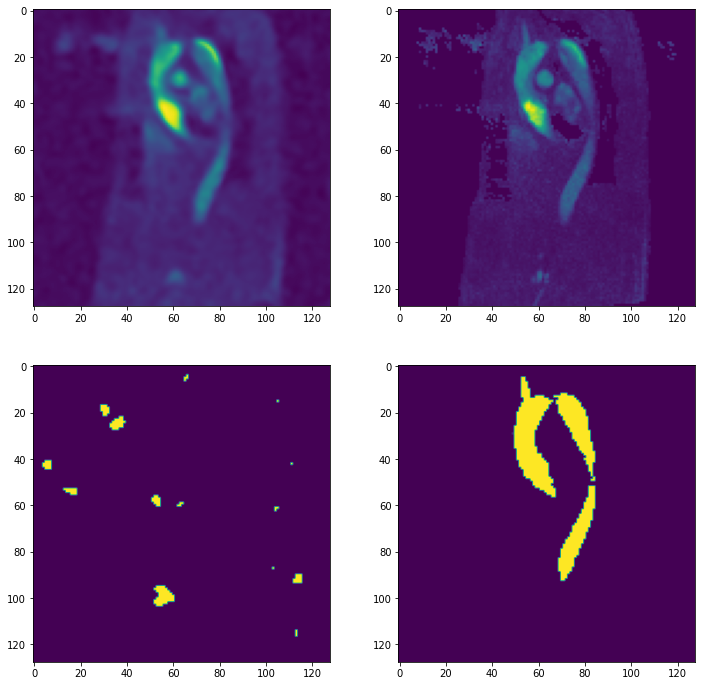

Batch 83 	 pcmra loss: 0.000413 	 mask loss: 0.038399
5.540529701697494e-10
3.0319304642034695e-05
0.5419369399547567
0.9999825954437256


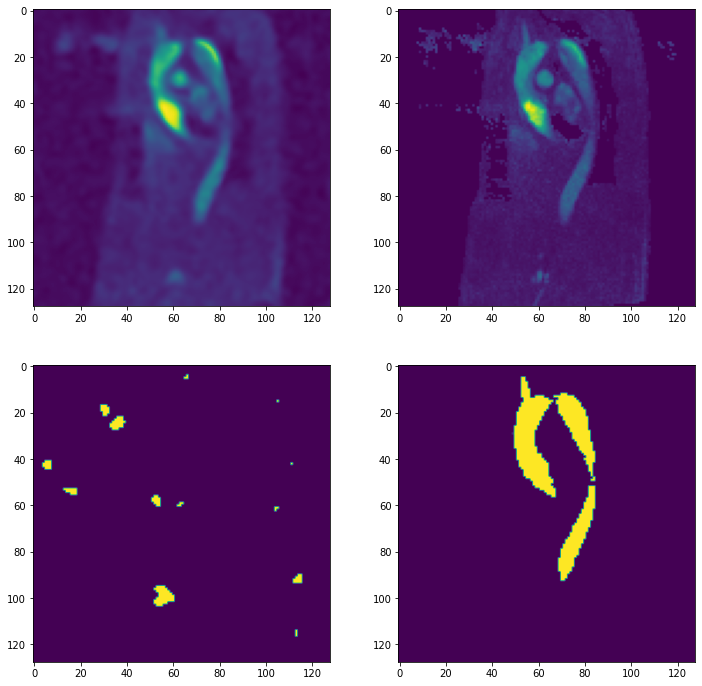

Batch 84 	 pcmra loss: 0.00041 	 mask loss: 0.038408
5.395743851721591e-10
3.0343067010107916e-05
0.5422919481992714
0.9999833106994629


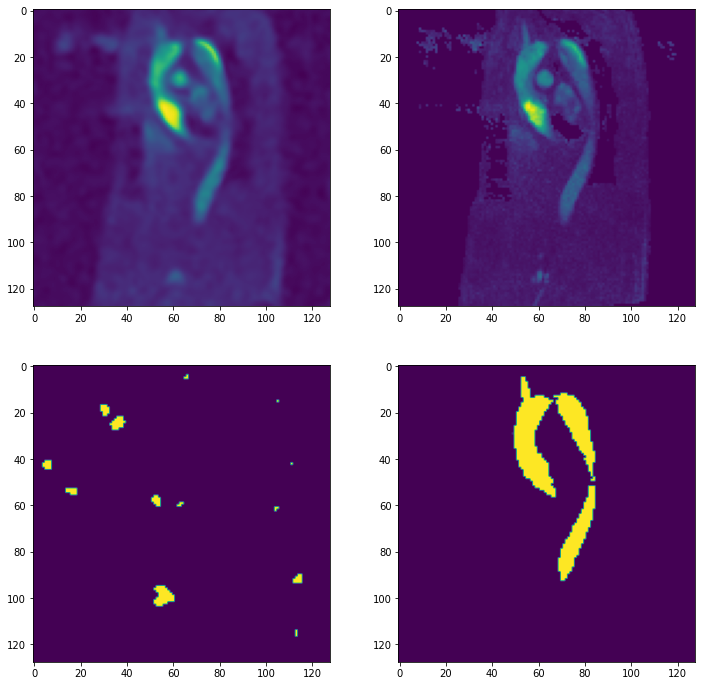

Batch 85 	 pcmra loss: 0.000408 	 mask loss: 0.038412
5.285741844218705e-10
3.035231293324614e-05
0.5437220245599738
0.9999839067459106


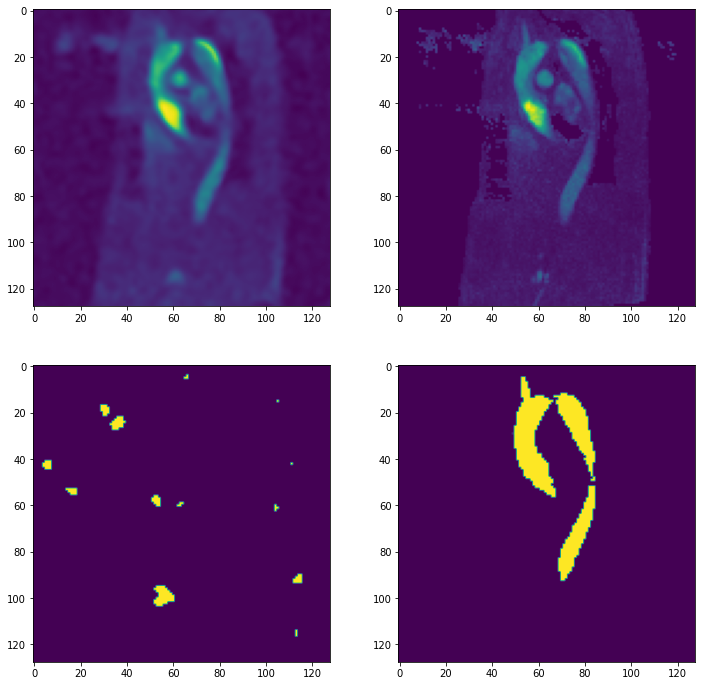

Batch 86 	 pcmra loss: 0.000406 	 mask loss: 0.038409
5.204180975049155e-10
3.0380910175153986e-05
0.544292750954625
0.9999843835830688


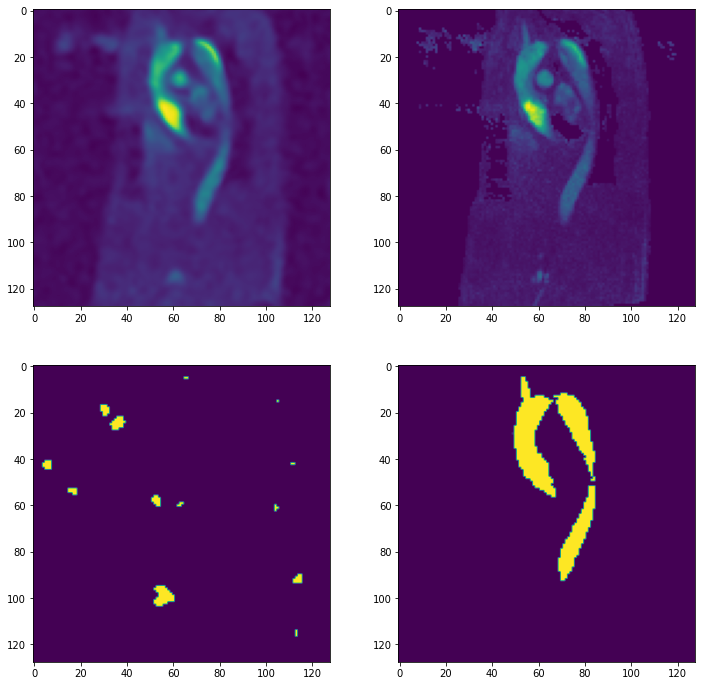

Batch 87 	 pcmra loss: 0.000403 	 mask loss: 0.038402
5.143786507844084e-10
3.035206646018196e-05
0.5446915477514243
0.999984860420227


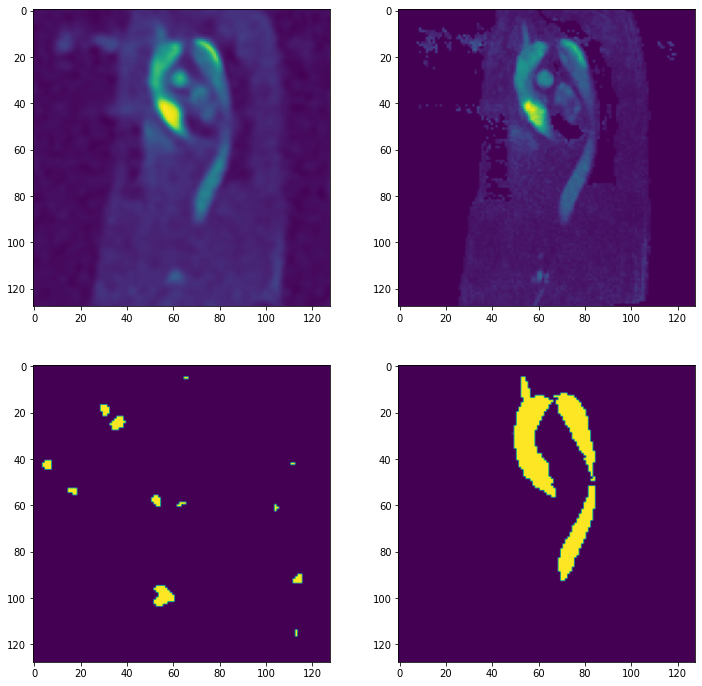

Batch 88 	 pcmra loss: 0.000401 	 mask loss: 0.038397
5.101897793124976e-10
3.0310399779409636e-05
0.546743893623348
0.9999853372573853


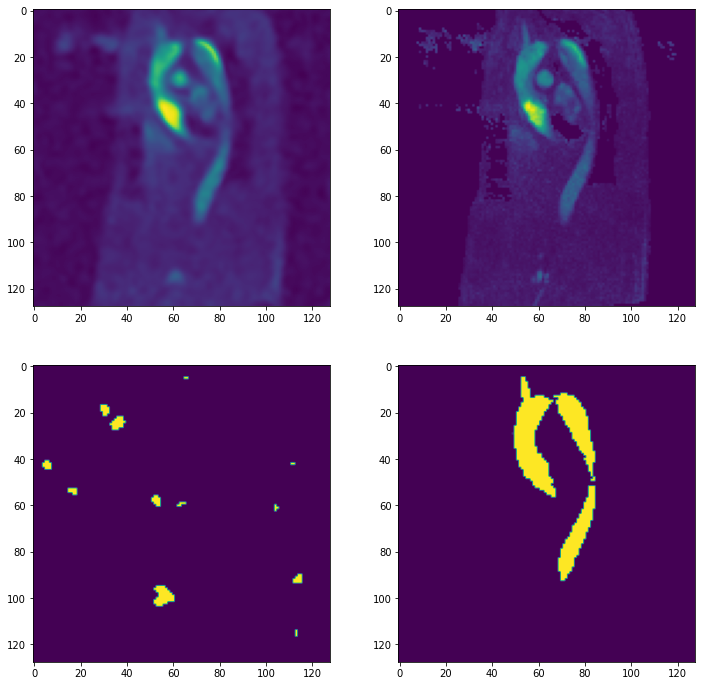

Batch 89 	 pcmra loss: 0.000399 	 mask loss: 0.038398
5.079245912753549e-10
3.0283200430858415e-05
0.5458590626716582
0.9999856948852539


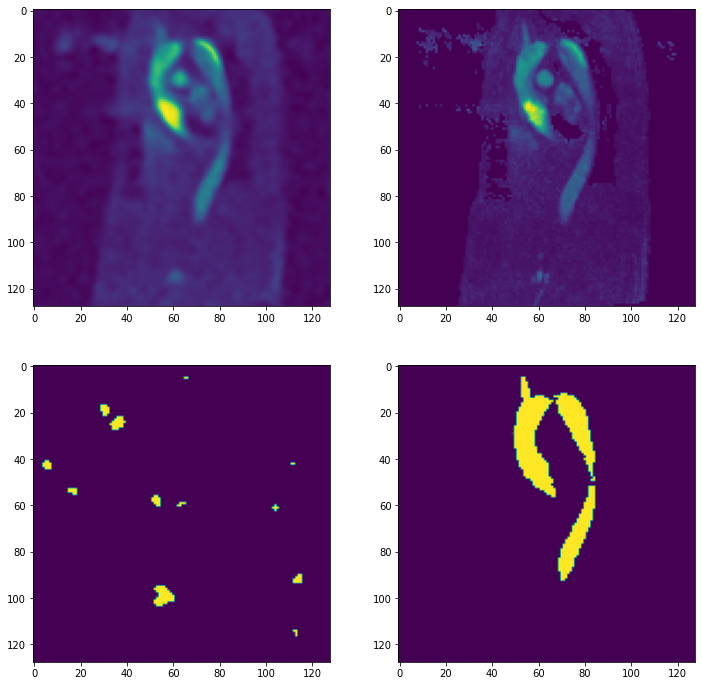

Batch 90 	 pcmra loss: 0.000397 	 mask loss: 0.038405
5.074713427255517e-10
3.0292700103018433e-05
0.545909082889555
0.9999861717224121


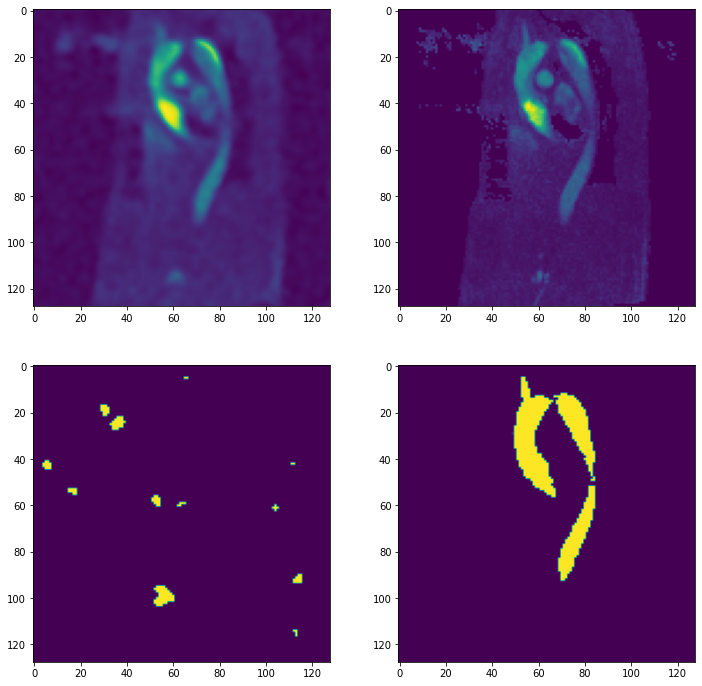

Batch 91 	 pcmra loss: 0.000395 	 mask loss: 0.038413
5.07983655140265e-10
3.0309967769426294e-05
0.5444482803344708
0.9999866485595703


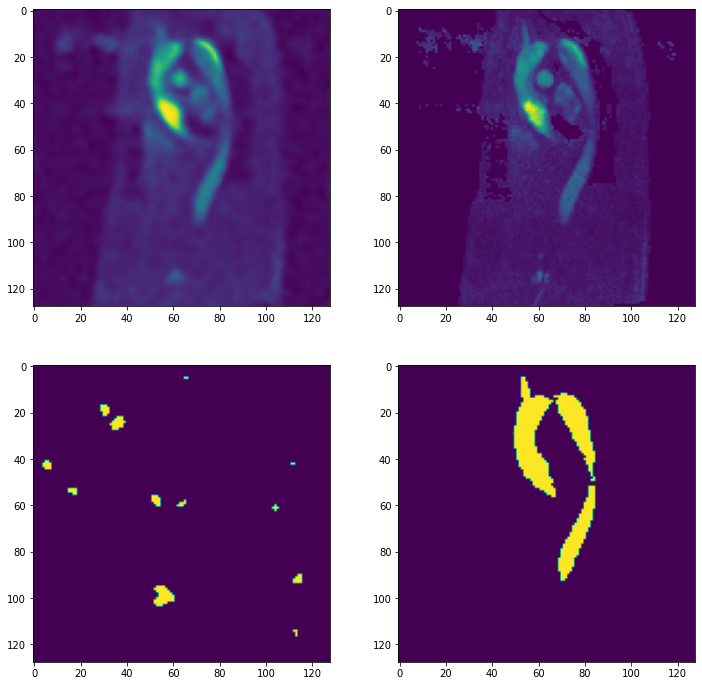

Batch 92 	 pcmra loss: 0.000393 	 mask loss: 0.038417
5.081435827669623e-10
3.035043118870817e-05
0.5455284506082437
0.9999871253967285


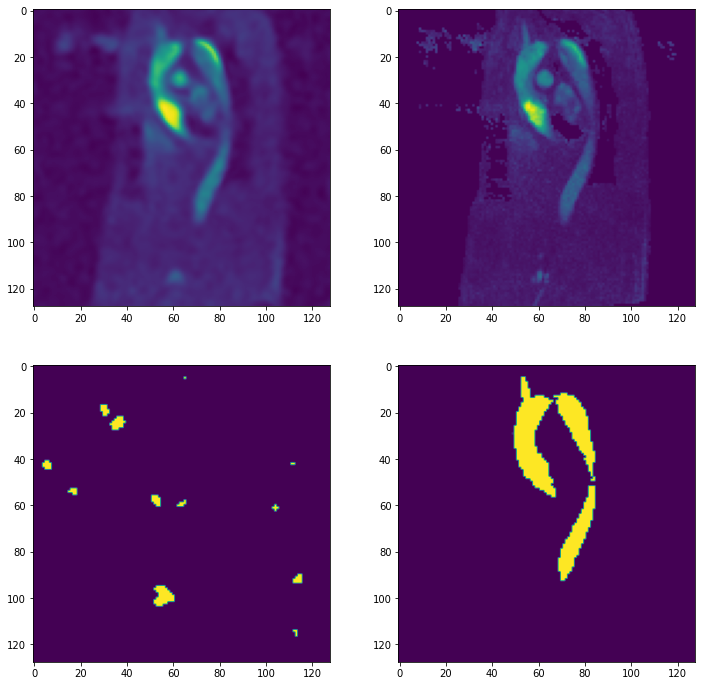

Batch 93 	 pcmra loss: 0.000391 	 mask loss: 0.038415
5.069151209902145e-10
3.033006032637786e-05
0.545924556255339
0.9999876022338867


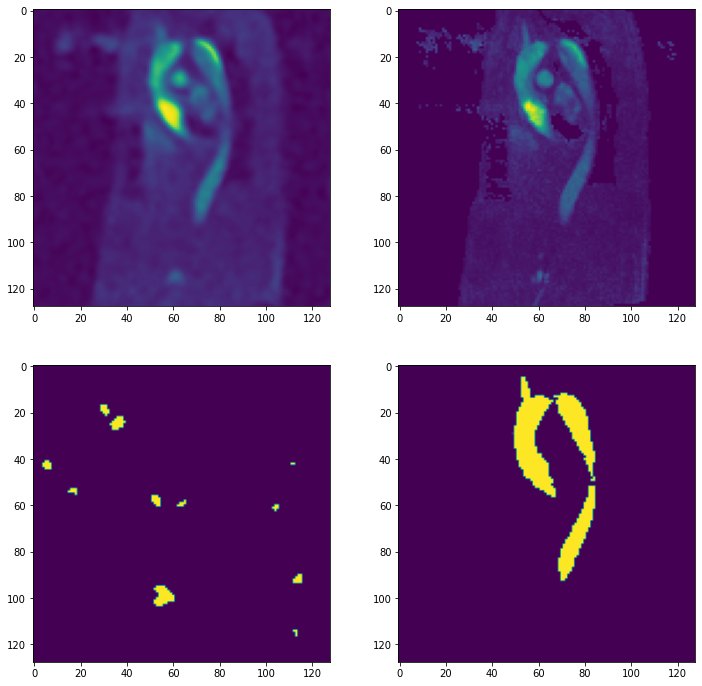

Batch 94 	 pcmra loss: 0.000389 	 mask loss: 0.038409
5.043767070667116e-10
3.0316818083520047e-05
0.5441121190786321
0.9999880790710449


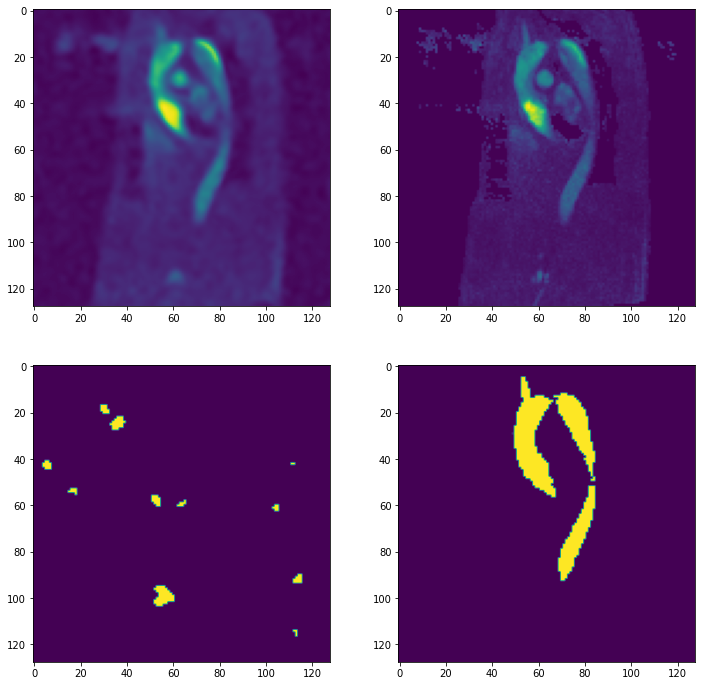

Batch 95 	 pcmra loss: 0.000387 	 mask loss: 0.038404
5.017926629768965e-10
3.0300082471512724e-05
0.5444851219654073
0.9999885559082031


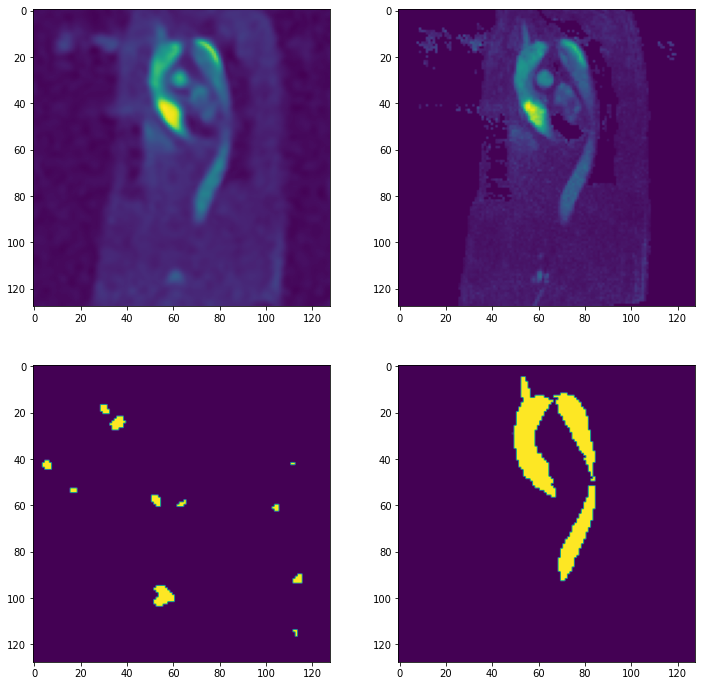

Batch 96 	 pcmra loss: 0.000385 	 mask loss: 0.038401
5.008221615199204e-10
3.030162952200044e-05
0.5459212273359284
0.9999889135360718


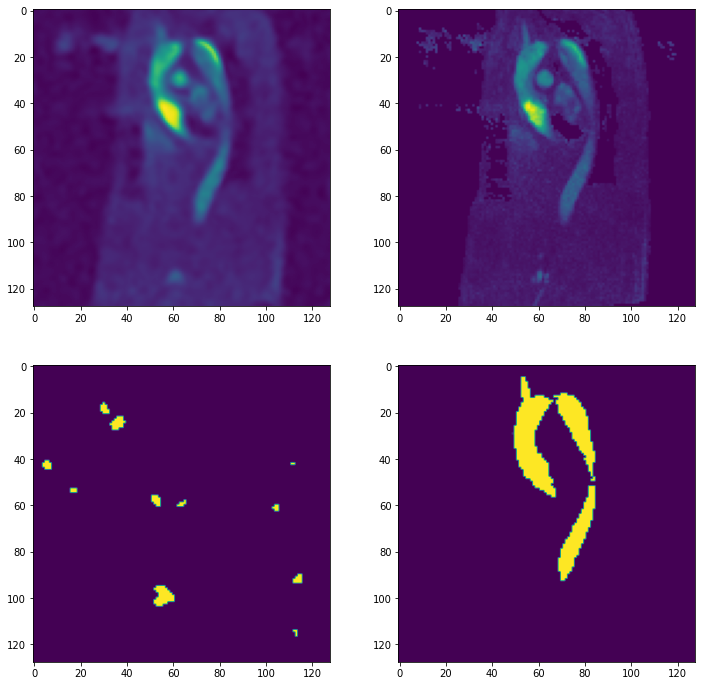

Batch 97 	 pcmra loss: 0.000384 	 mask loss: 0.0384
5.02614450059724e-10
3.029968047485454e-05
0.5455637633800349
0.99998939037323


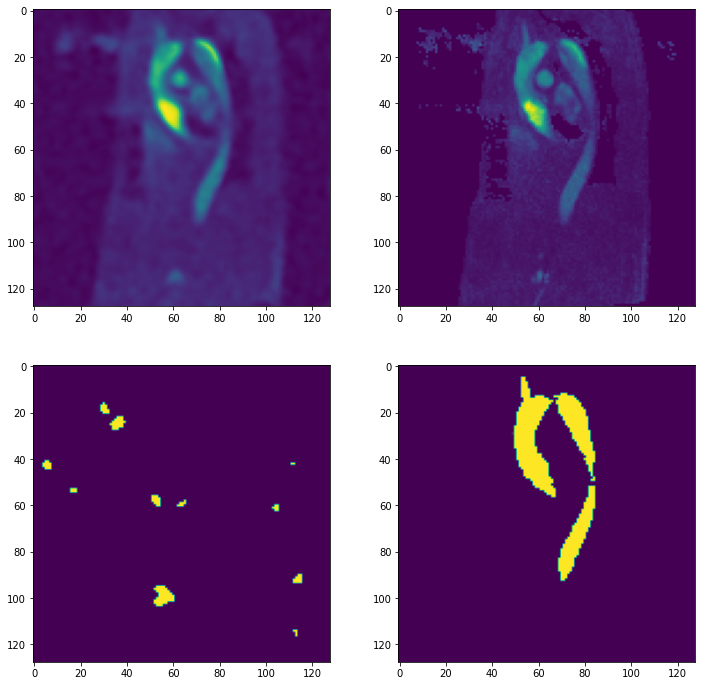

Batch 98 	 pcmra loss: 0.000382 	 mask loss: 0.038397
5.073668152277833e-10
3.0290146241895854e-05
0.5444757729768732
0.9999897480010986


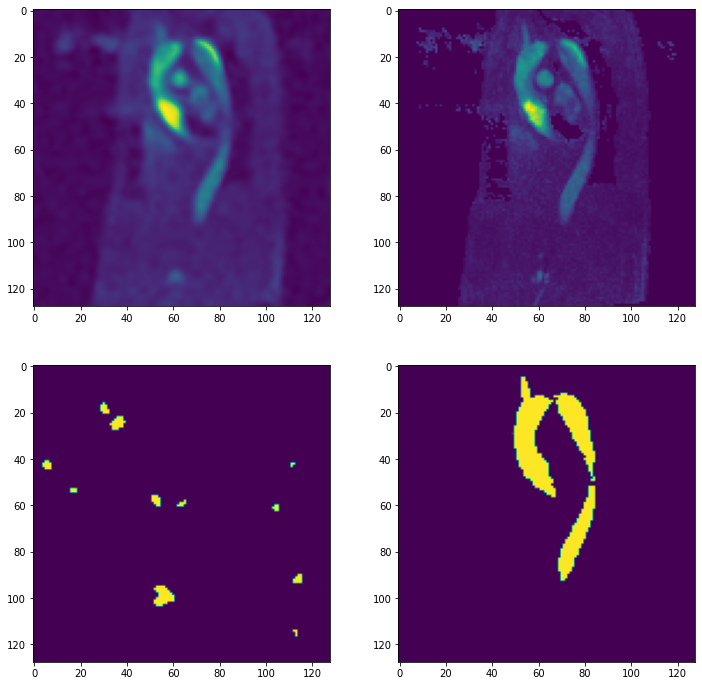

Batch 99 	 pcmra loss: 0.00038 	 mask loss: 0.038391
5.144895065534172e-10
3.028475839528255e-05
0.5441993594169614
0.9999901056289673


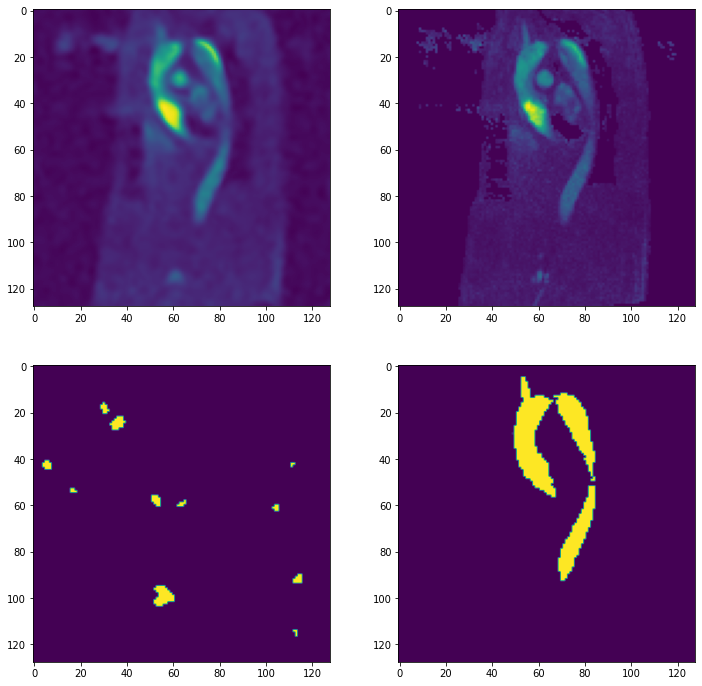

Batch 100 	 pcmra loss: 0.000378 	 mask loss: 0.038384
5.232567712454284e-10
3.0289638743852265e-05
0.544381362199783
0.9999903440475464


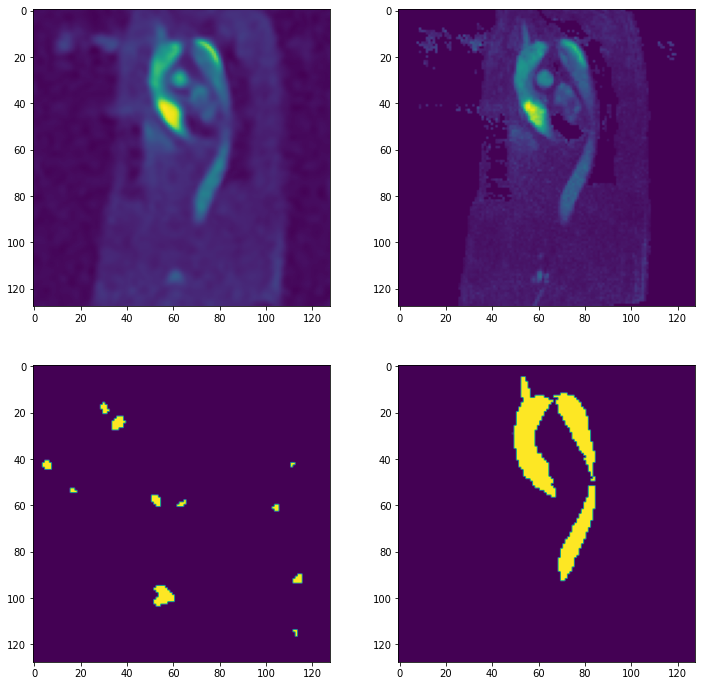

Batch 101 	 pcmra loss: 0.000377 	 mask loss: 0.038379
5.332372876587499e-10
3.0317959499370772e-05
0.5444082587957372
0.999990701675415


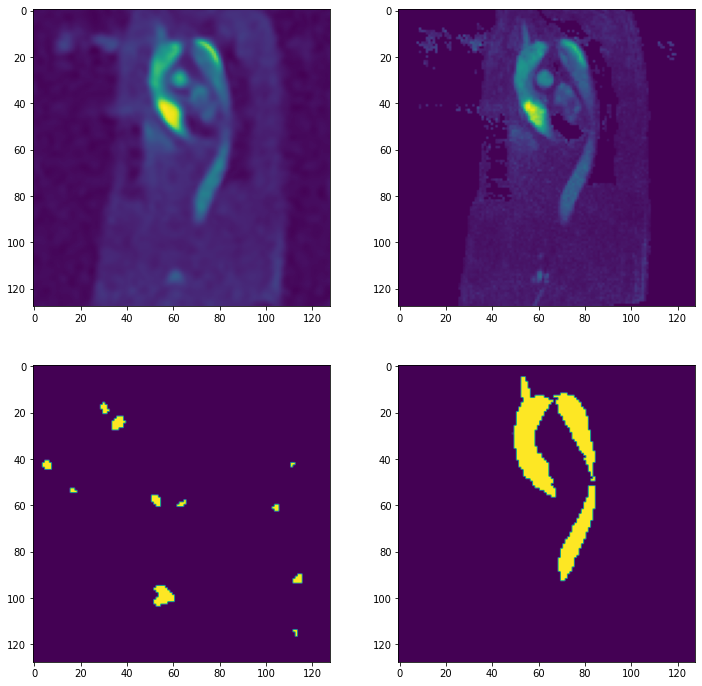

Batch 102 	 pcmra loss: 0.000375 	 mask loss: 0.038376
5.444633077722472e-10
3.0322224120027386e-05
0.5438205987214995
0.9999909400939941


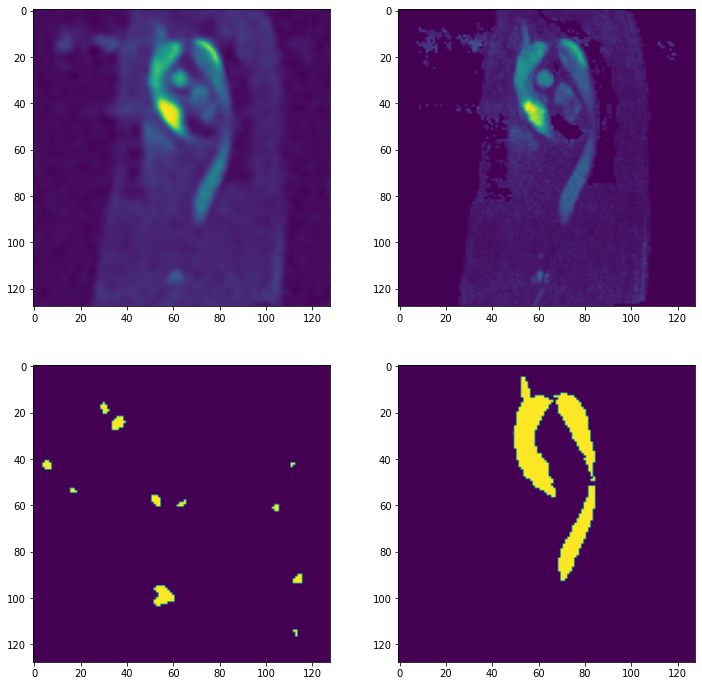

Batch 103 	 pcmra loss: 0.000374 	 mask loss: 0.038373
5.573046468754228e-10
3.0313811294035986e-05
0.5428561151027677
0.9999911785125732


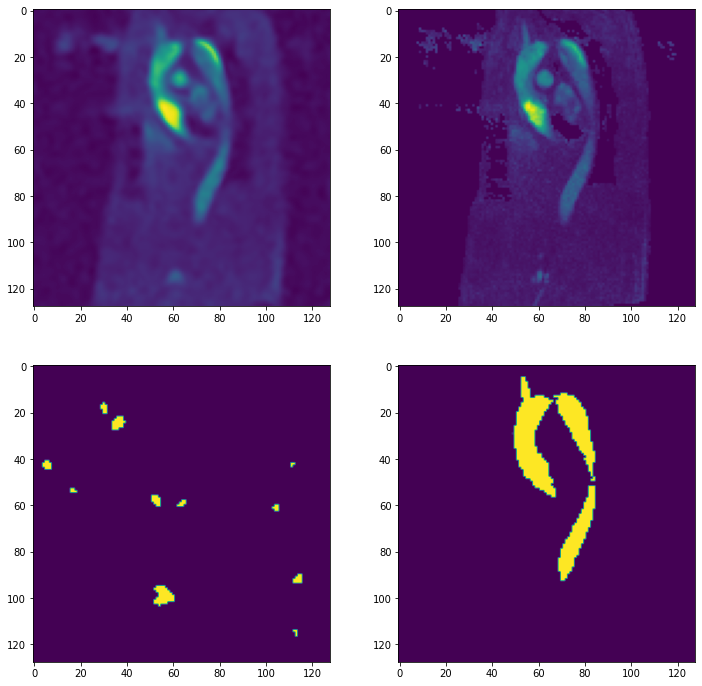

Batch 104 	 pcmra loss: 0.000372 	 mask loss: 0.038369
5.720037221657037e-10
3.0331379093695432e-05
0.5420539230108258
0.9999915361404419


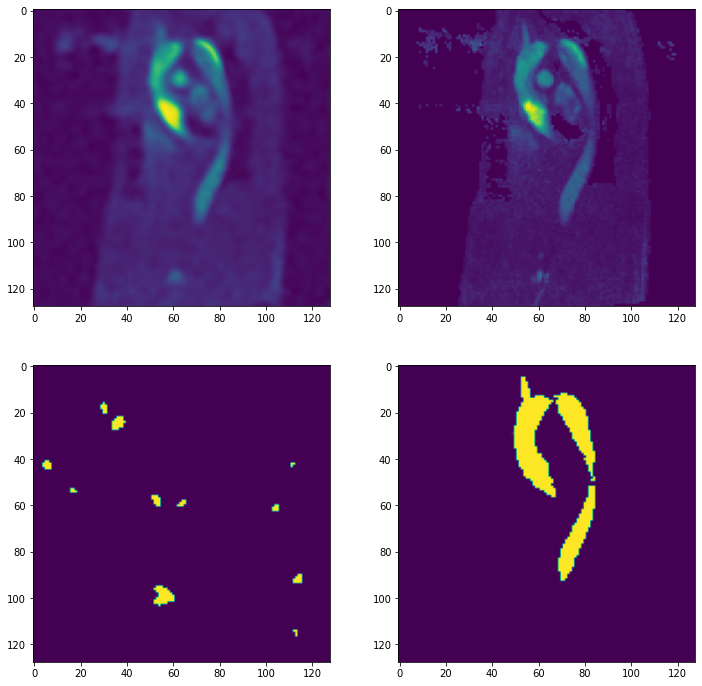

Batch 105 	 pcmra loss: 0.00037 	 mask loss: 0.038363
5.8846044703742e-10
3.0336151212395635e-05
0.541162800788876
0.999991774559021


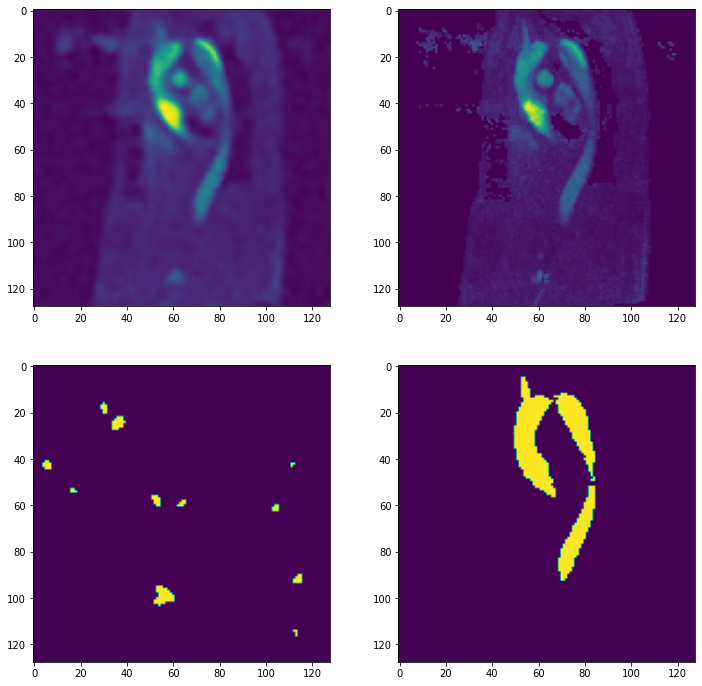

Batch 106 	 pcmra loss: 0.000369 	 mask loss: 0.038356
6.062190749389629e-10
3.037589976884192e-05
0.5420881509780869
0.9999920129776001


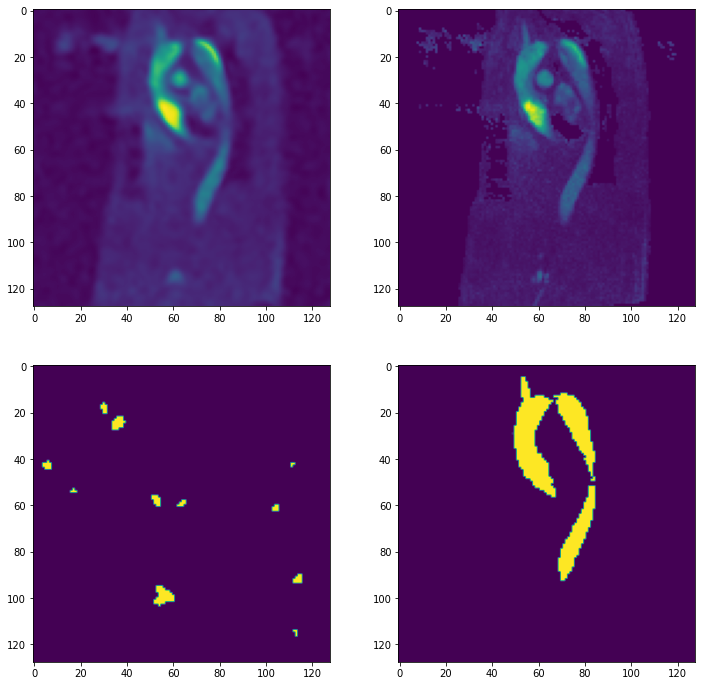

Batch 107 	 pcmra loss: 0.000368 	 mask loss: 0.03835
6.247936057413028e-10
3.041145100723952e-05
0.5422346085309879
0.9999922513961792


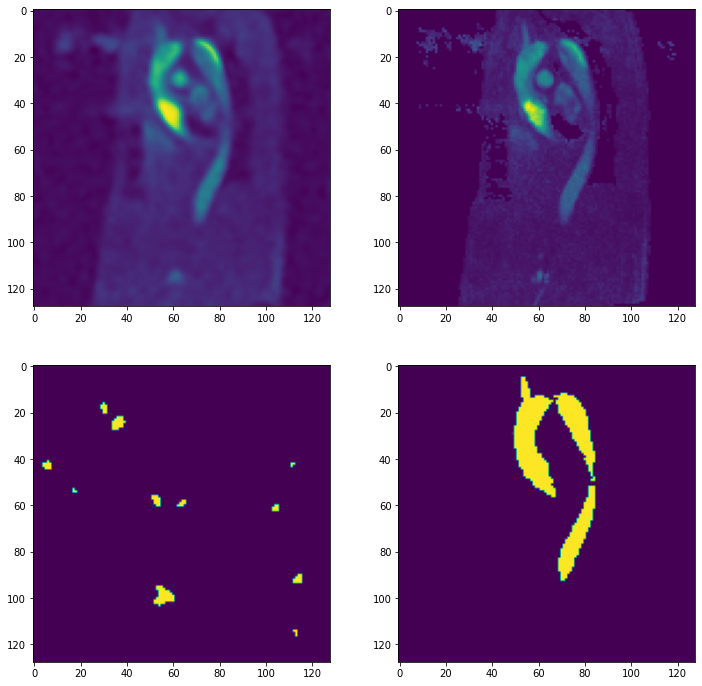

Batch 108 	 pcmra loss: 0.000366 	 mask loss: 0.038344
6.441953082081397e-10
3.039418425032636e-05
0.5406985968351344
0.9999924898147583


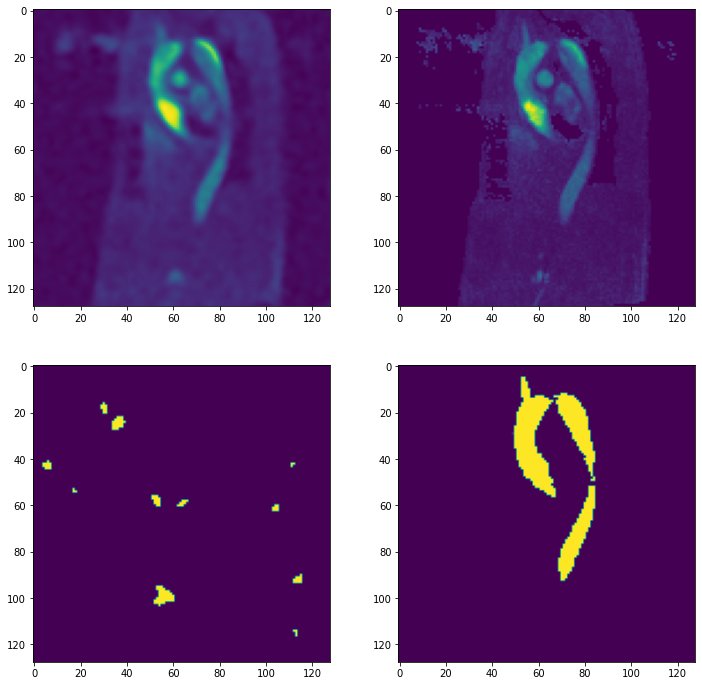

Batch 109 	 pcmra loss: 0.000365 	 mask loss: 0.038339
6.651629802512105e-10
3.0413478270929772e-05
0.5397365063428877
0.9999927282333374


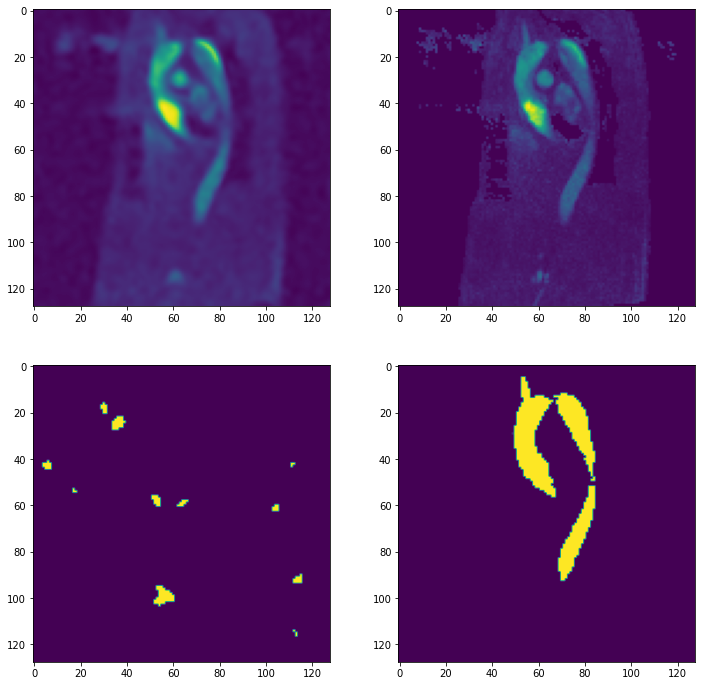

Batch 110 	 pcmra loss: 0.000363 	 mask loss: 0.038333
6.888294934448425e-10
3.040519732167013e-05
0.5383439034223529
0.9999929666519165


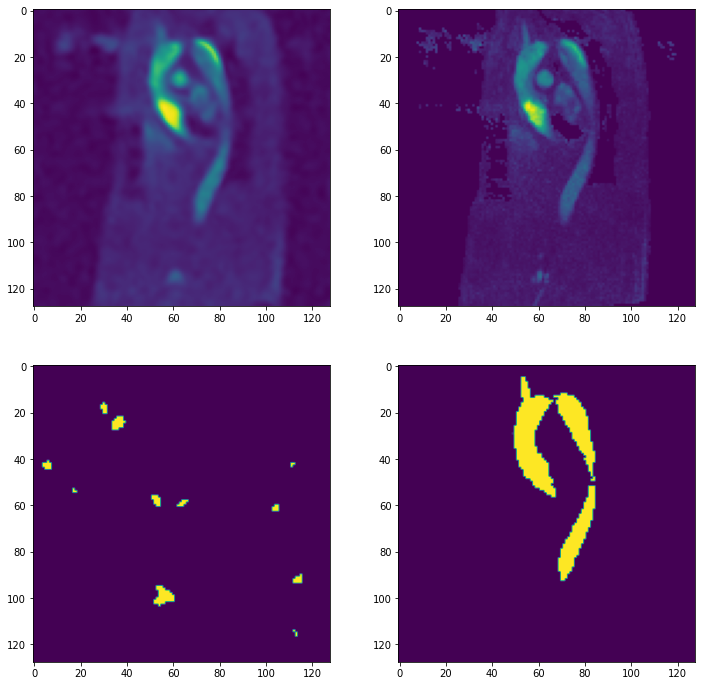

Batch 111 	 pcmra loss: 0.000362 	 mask loss: 0.038326
7.160630421942926e-10
3.0414003049372695e-05
0.5377354055642949
0.9999932050704956


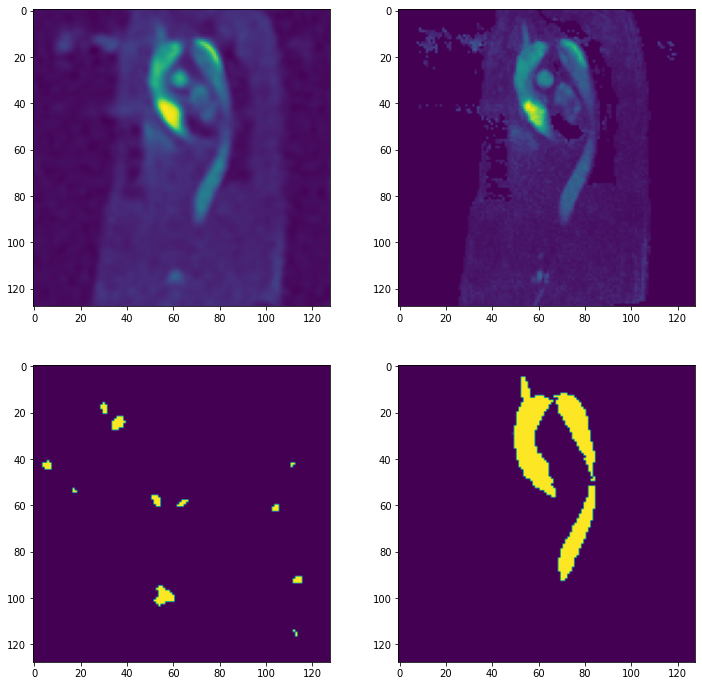

Batch 112 	 pcmra loss: 0.00036 	 mask loss: 0.038321
7.4677386496802e-10
3.0436139240919147e-05
0.5390685021876962
0.9999934434890747


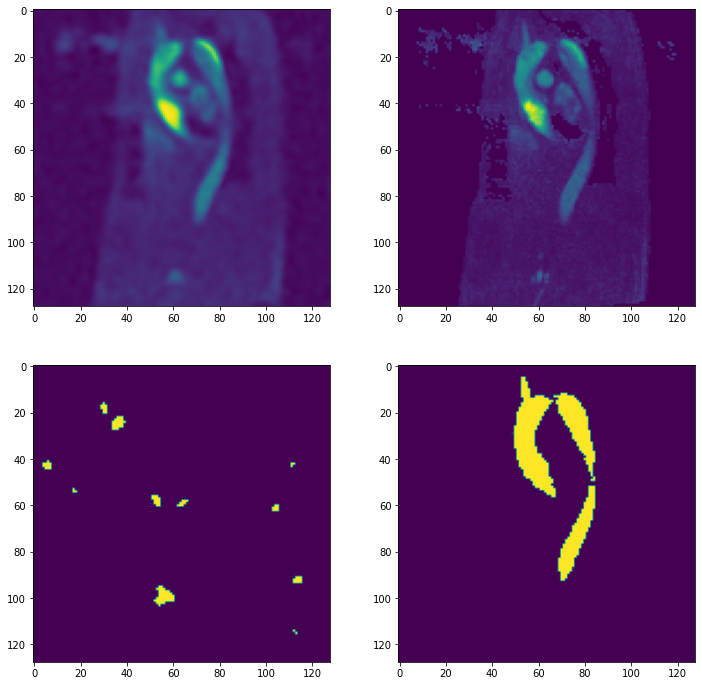

Batch 113 	 pcmra loss: 0.000359 	 mask loss: 0.038316
7.799715318057565e-10
3.044445566047216e-05
0.538782477378845
0.9999935626983643


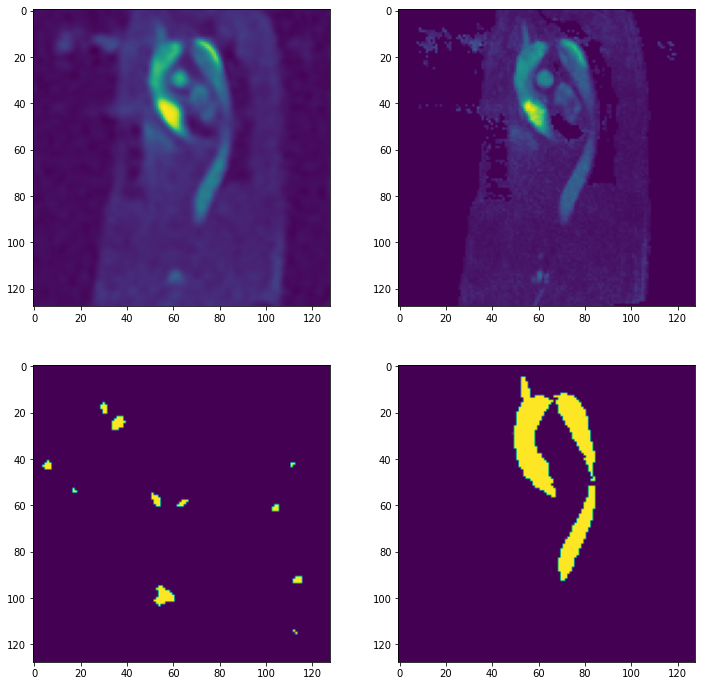

Batch 114 	 pcmra loss: 0.000358 	 mask loss: 0.038312
8.143997143328363e-10
3.0443280593317468e-05
0.5375643223524086
0.9999938011169434


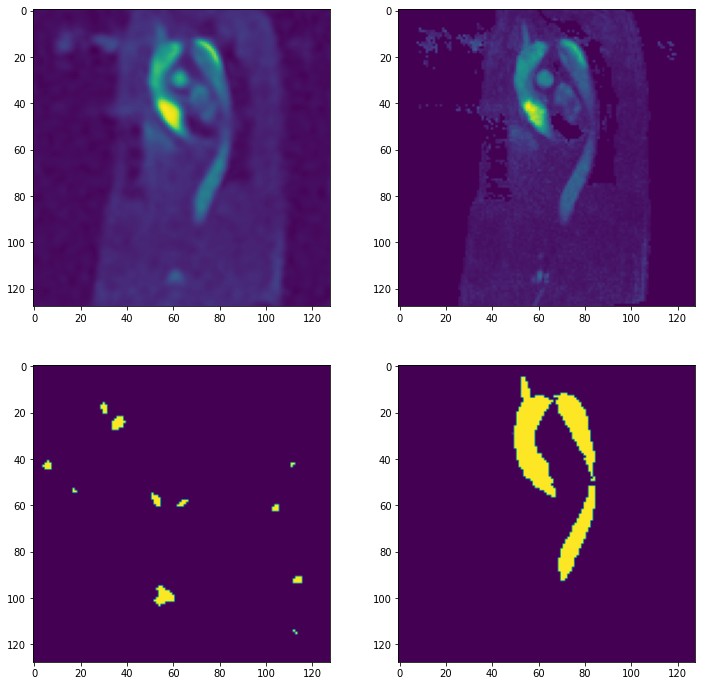

Batch 115 	 pcmra loss: 0.000357 	 mask loss: 0.038308
8.493668546272204e-10
3.043535616598092e-05
0.5377062112092926
0.9999939203262329


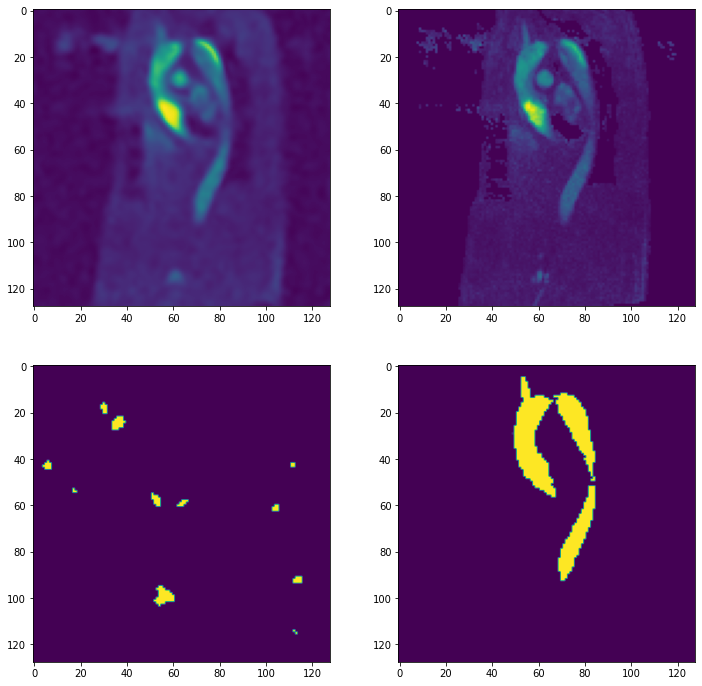

Batch 116 	 pcmra loss: 0.000355 	 mask loss: 0.038303
8.517809790831166e-10
3.0454226362053305e-05
0.5366451680660242
0.999994158744812


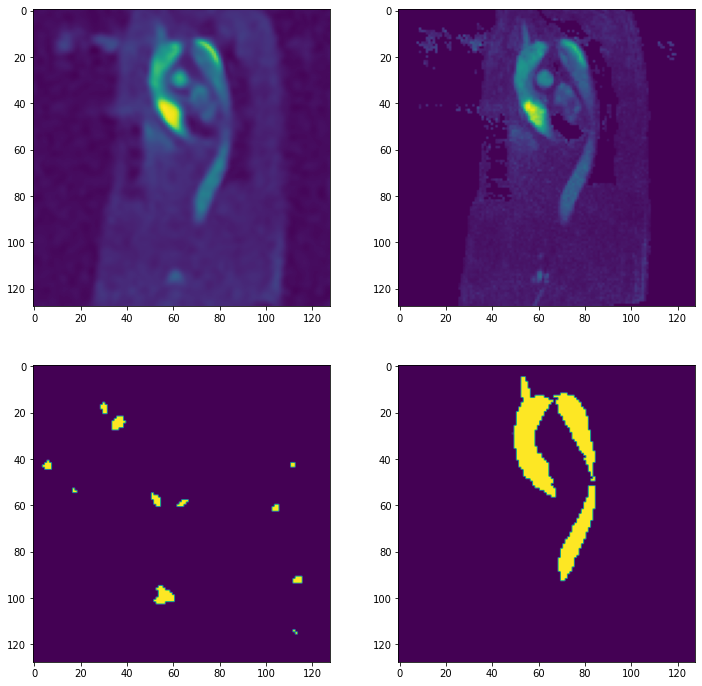

Batch 117 	 pcmra loss: 0.000354 	 mask loss: 0.038298
8.22917456400063e-10
3.0459514164249413e-05
0.535450133681291
0.9999942779541016


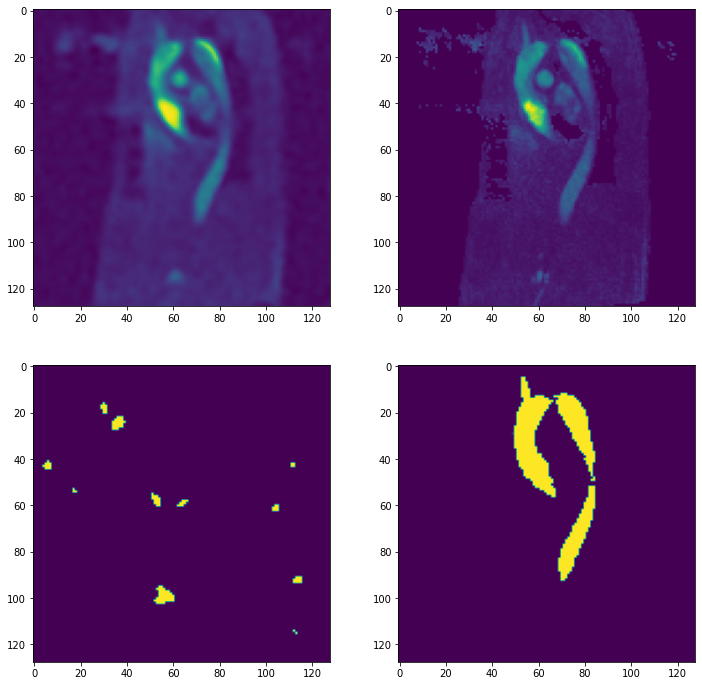

Batch 118 	 pcmra loss: 0.000353 	 mask loss: 0.038293
7.965362258666175e-10
3.0464075280178804e-05
0.5347759842872616
0.9999943971633911


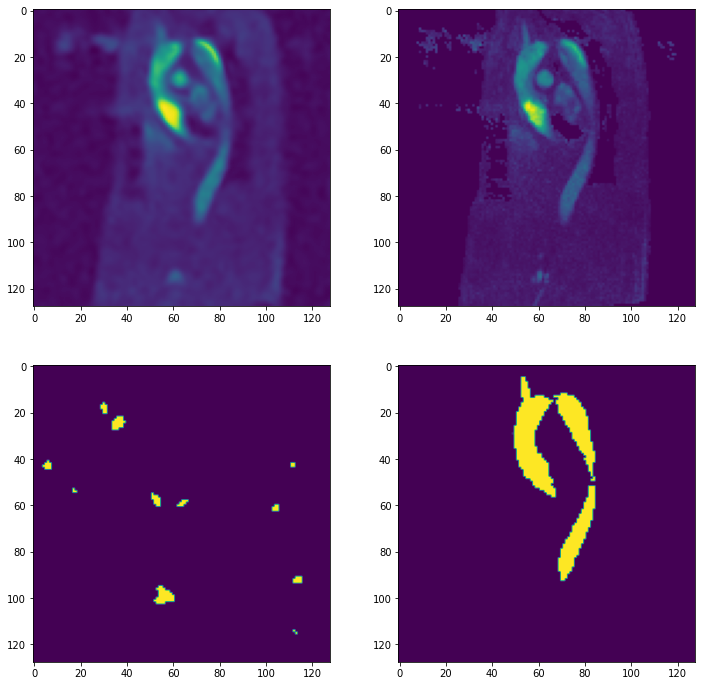

Batch 119 	 pcmra loss: 0.000352 	 mask loss: 0.038288
7.71920471986931e-10
3.048049438802991e-05
0.5356628239154705
0.9999946355819702


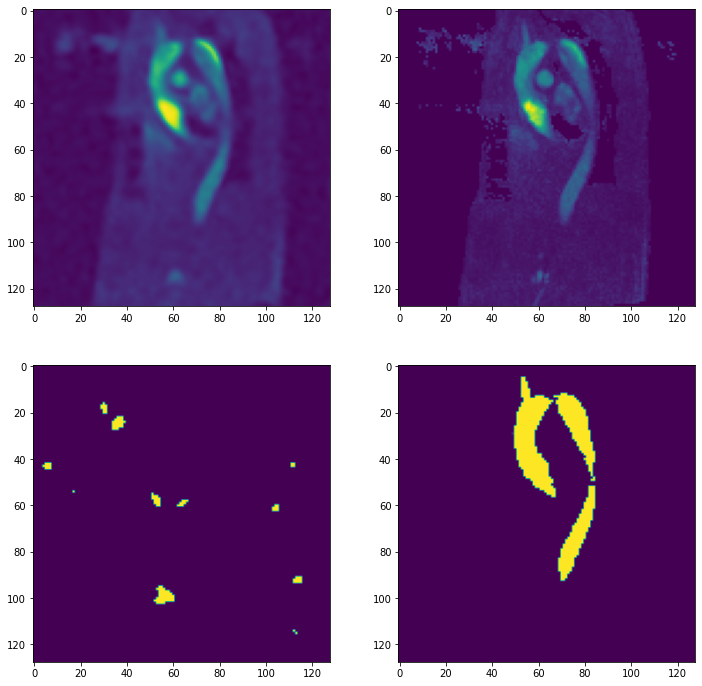

Batch 120 	 pcmra loss: 0.00035 	 mask loss: 0.038283
7.481909536366516e-10
3.0506680559483357e-05
0.5363885968923553
0.9999947547912598


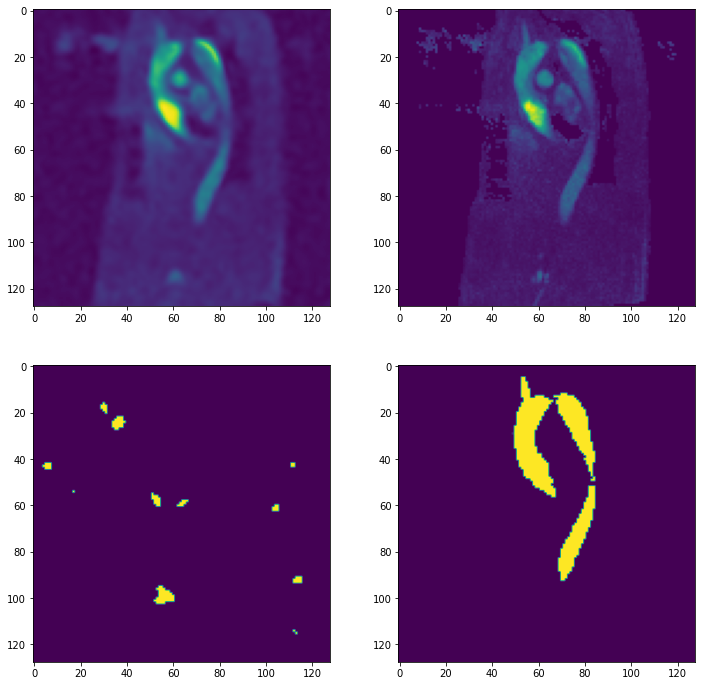

Batch 121 	 pcmra loss: 0.000349 	 mask loss: 0.038279
7.249156275257462e-10
3.0483472073683515e-05
0.5360001981258384
0.9999948740005493


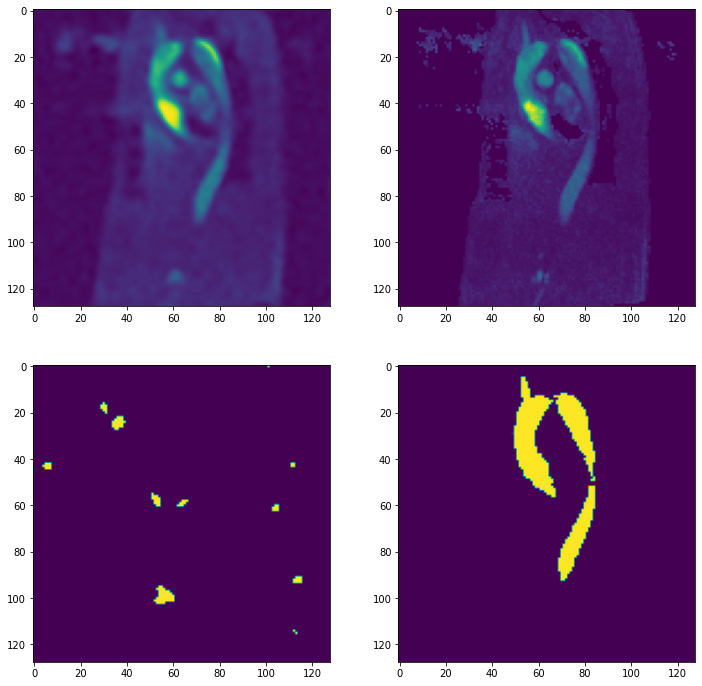

Batch 122 	 pcmra loss: 0.000348 	 mask loss: 0.038275
7.021328518597159e-10
3.0486817195196636e-05
0.5352201730012872
0.9999949932098389


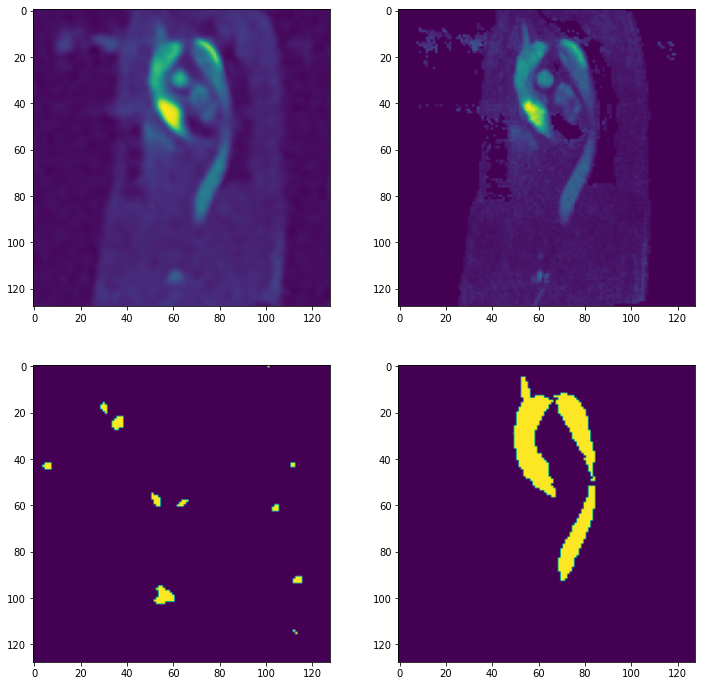

Batch 123 	 pcmra loss: 0.000347 	 mask loss: 0.03827
6.800737195611362e-10
3.05155263049528e-05
0.5358715951442716
0.9999951124191284


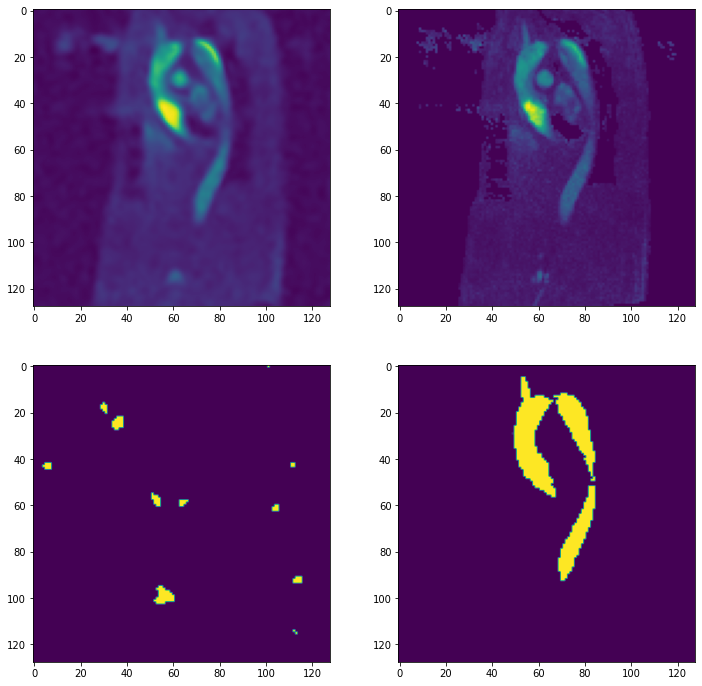

Batch 124 	 pcmra loss: 0.000346 	 mask loss: 0.038265
6.588283252284555e-10
3.053463660762645e-05
0.5375475734472273
0.999995231628418


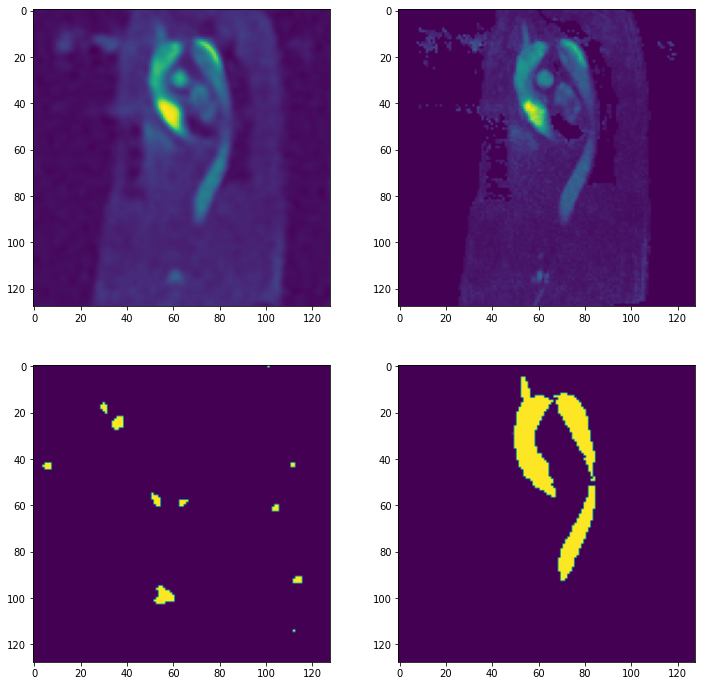

Batch 125 	 pcmra loss: 0.000345 	 mask loss: 0.038258
6.385058592961457e-10
3.056820060010068e-05
0.5367525875568329
0.9999953508377075


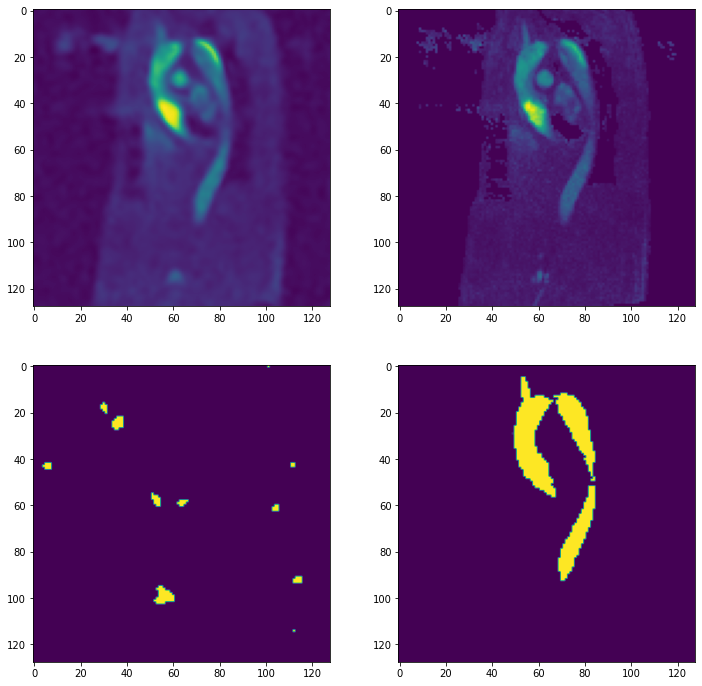

Batch 126 	 pcmra loss: 0.000343 	 mask loss: 0.038251
6.192034662788615e-10
3.057289359276183e-05
0.535168734192845
0.9999954700469971


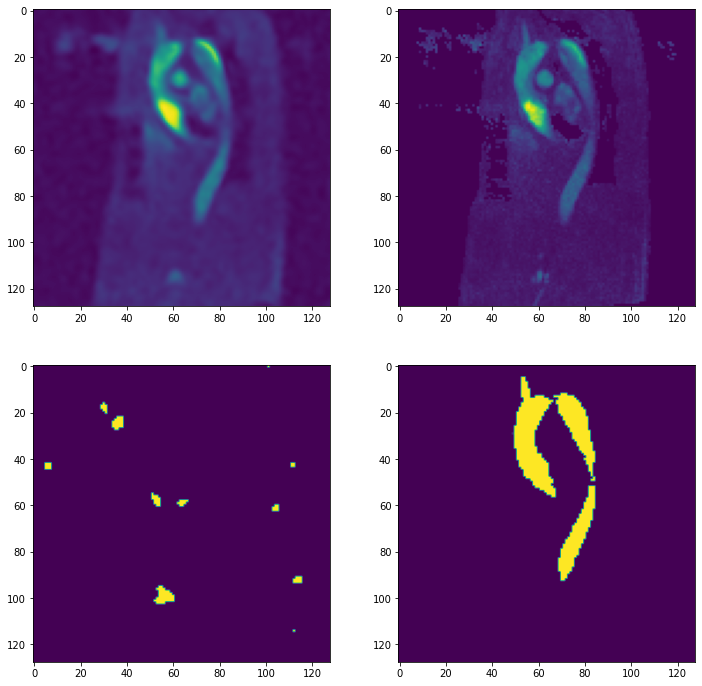

Batch 127 	 pcmra loss: 0.000342 	 mask loss: 0.038244
6.004342578691535e-10
3.0559194783563726e-05
0.5352460443973532
0.9999955892562866


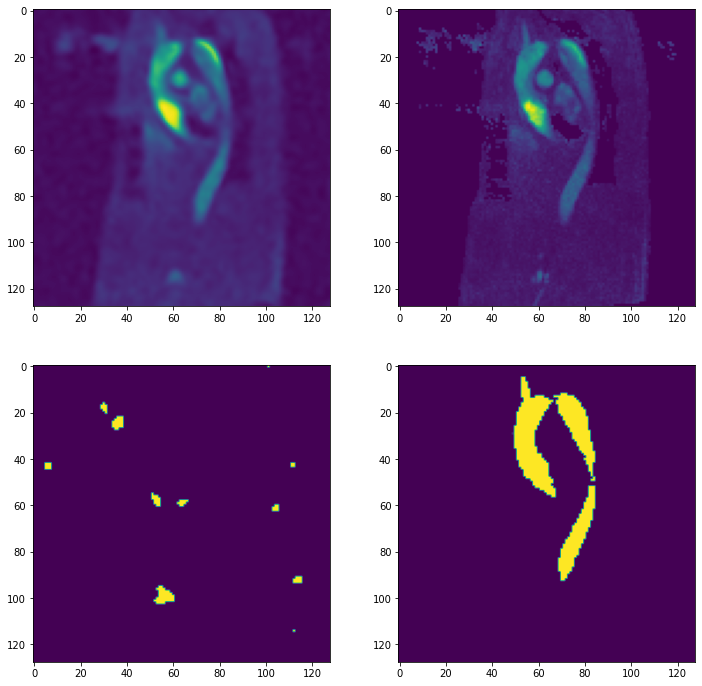

Batch 128 	 pcmra loss: 0.000341 	 mask loss: 0.038237
5.813662329323677e-10
3.0588598747272044e-05
0.5346330404281603
0.9999957084655762


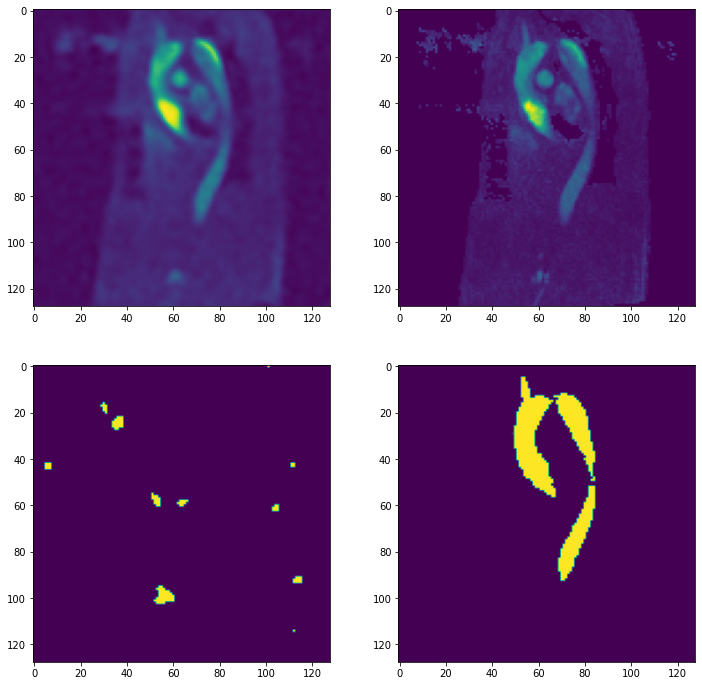

Batch 129 	 pcmra loss: 0.00034 	 mask loss: 0.03823
5.628768007248652e-10
3.0601131584262475e-05
0.5346788704395223
0.9999958276748657


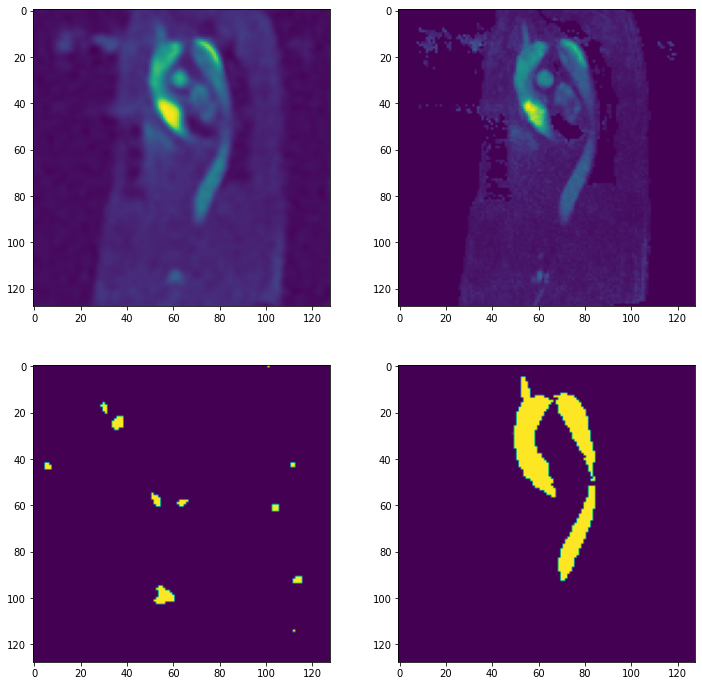

Batch 130 	 pcmra loss: 0.000339 	 mask loss: 0.038222
5.44991107798154e-10
3.059937989746686e-05
0.5319496333599079
0.9999958276748657


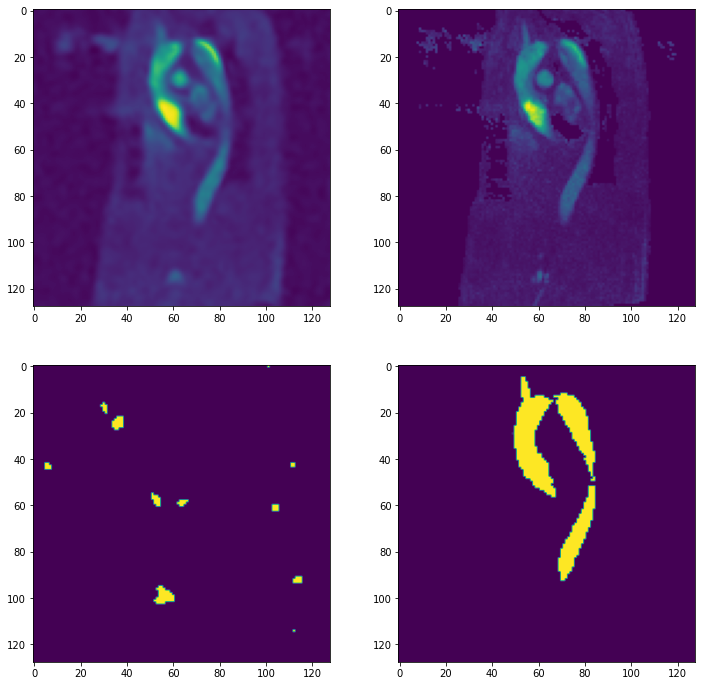

Batch 131 	 pcmra loss: 0.000338 	 mask loss: 0.038214
5.277853709628744e-10
3.061756615352351e-05
0.5319837093353089
0.9999959468841553


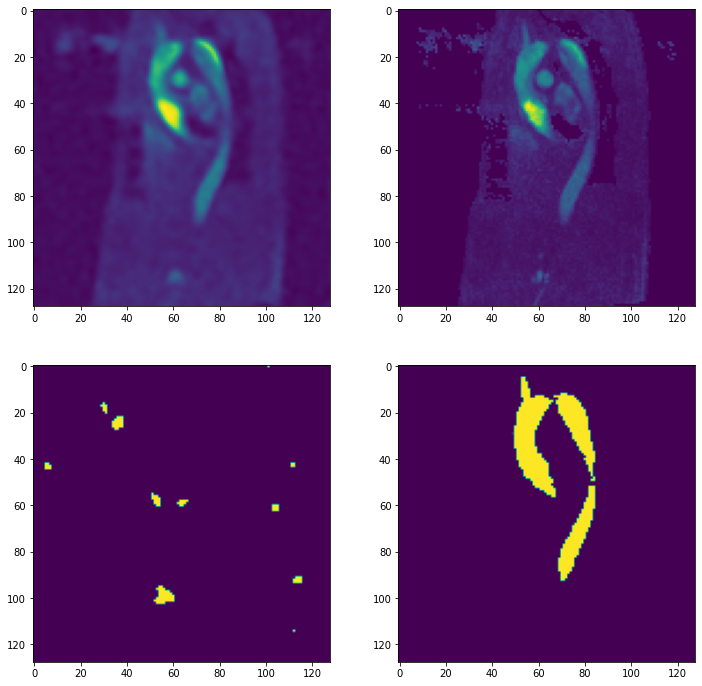

Batch 132 	 pcmra loss: 0.000337 	 mask loss: 0.038207
5.114261791838715e-10
3.0643575883004814e-05
0.5324663043022058
0.9999960660934448


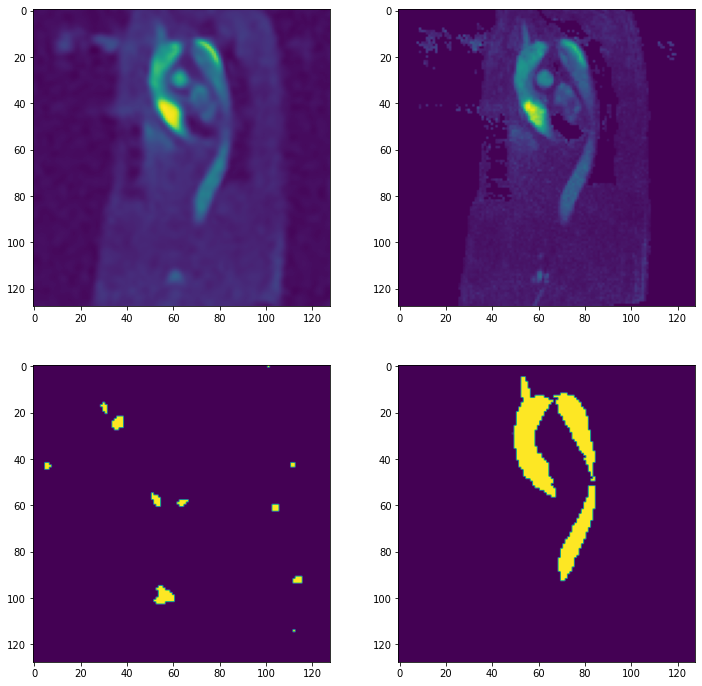

Batch 133 	 pcmra loss: 0.000336 	 mask loss: 0.038201
4.959673782778395e-10
3.0662227800348774e-05
0.5324899286031711
0.9999960660934448


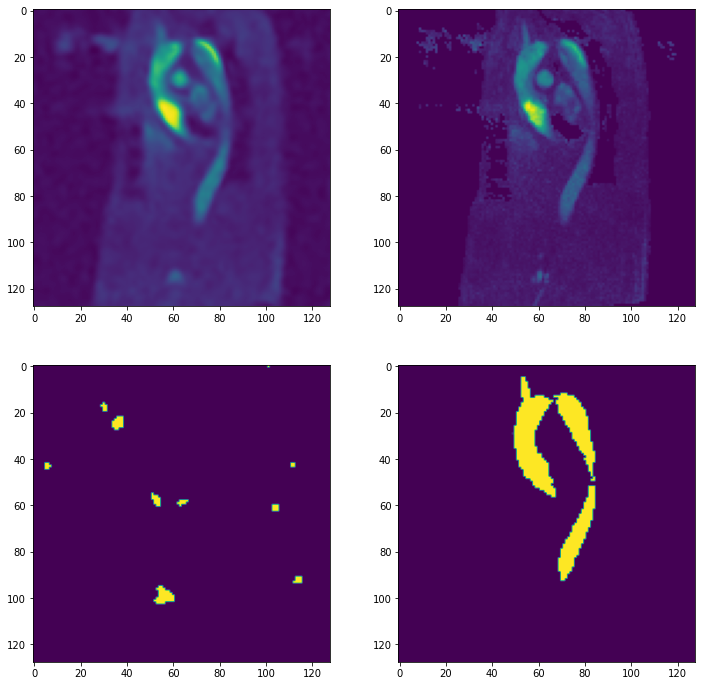

Batch 134 	 pcmra loss: 0.000335 	 mask loss: 0.038195
4.813650034130035e-10
3.068148726015352e-05
0.5322519868612281
0.9999961853027344


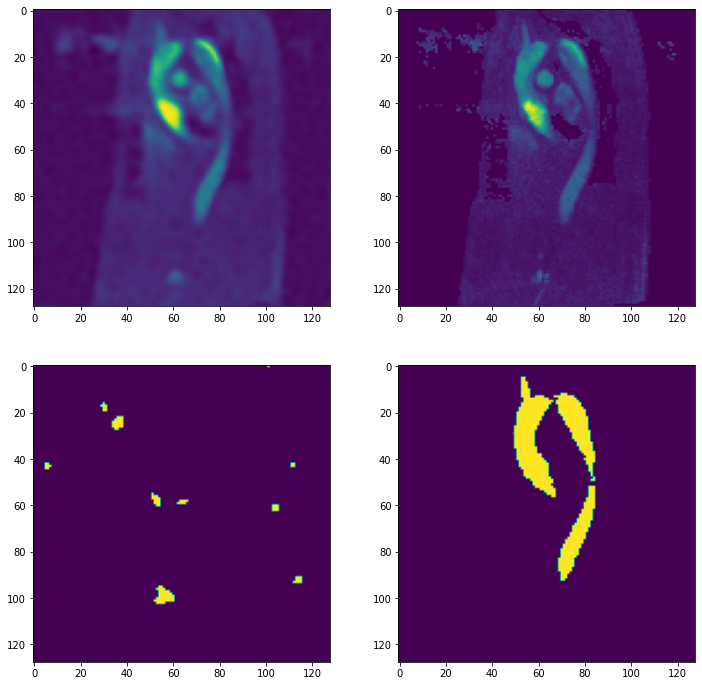

Batch 135 	 pcmra loss: 0.000334 	 mask loss: 0.038188
4.674751141742206e-10
3.0717996196472086e-05
0.5320146054029404
0.9999963045120239


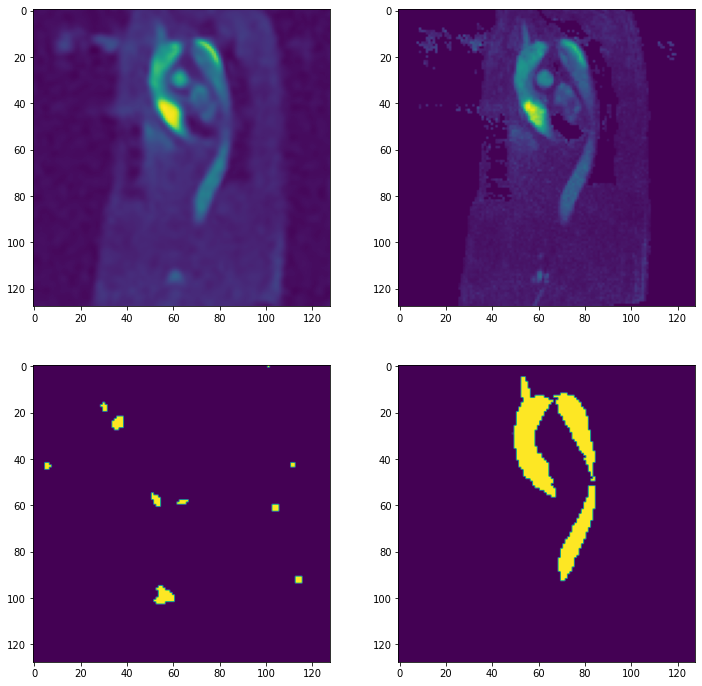

Batch 136 	 pcmra loss: 0.000333 	 mask loss: 0.038181
4.5413844906860845e-10
3.0722361771040596e-05
0.5298612862825359
0.9999963045120239


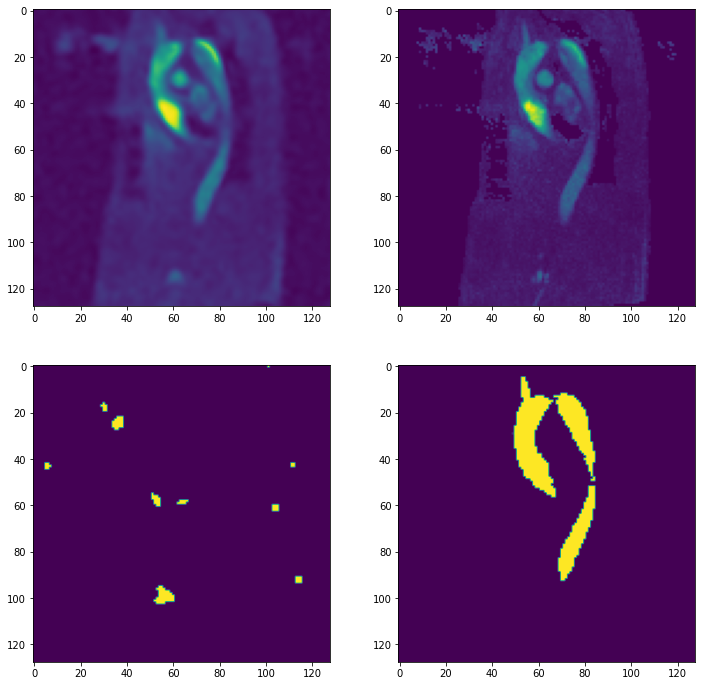

Batch 137 	 pcmra loss: 0.000332 	 mask loss: 0.038174
4.412285259380866e-10
3.0706647521583363e-05
0.5293572157621276
0.9999964237213135


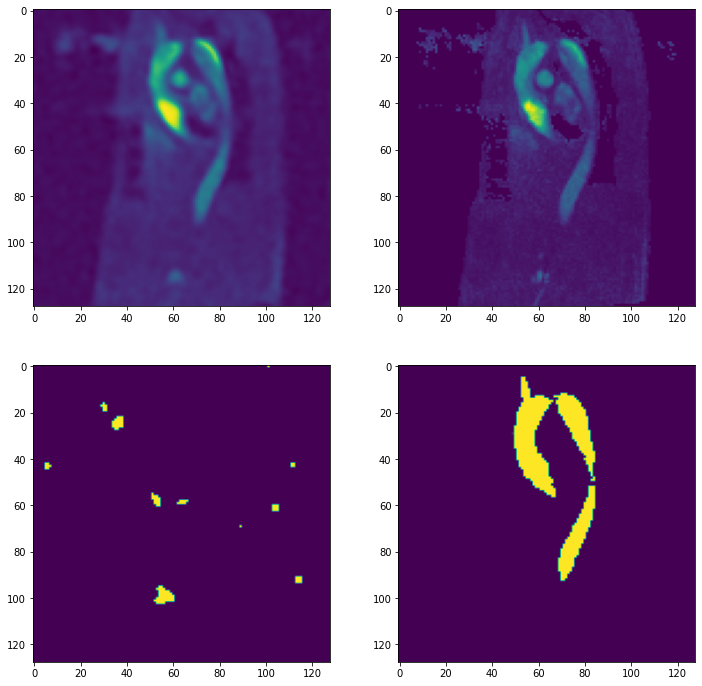

Batch 138 	 pcmra loss: 0.000331 	 mask loss: 0.038167
4.287110111356185e-10
3.0744799005333334e-05
0.5282415986061094
0.9999964237213135


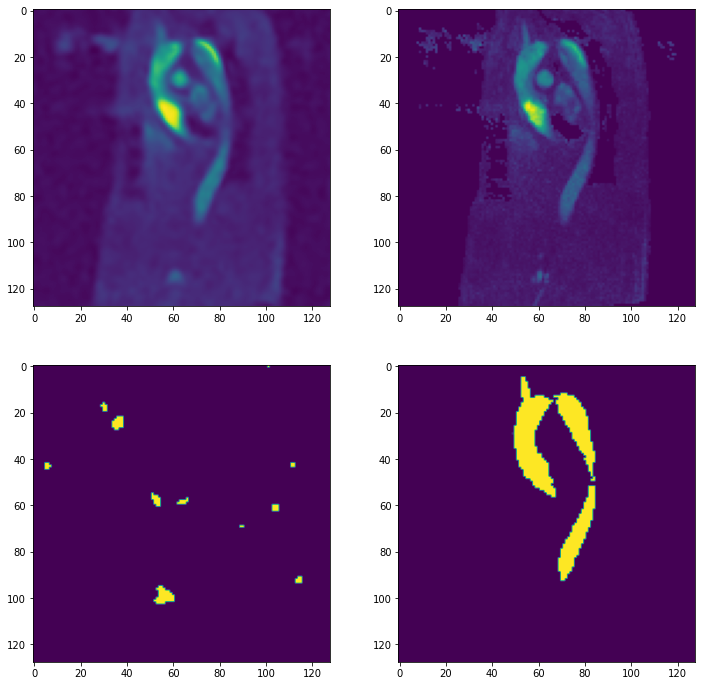

Batch 139 	 pcmra loss: 0.00033 	 mask loss: 0.03816
4.167122202858309e-10
3.0773660910199396e-05
0.5279828846454588
0.999996542930603


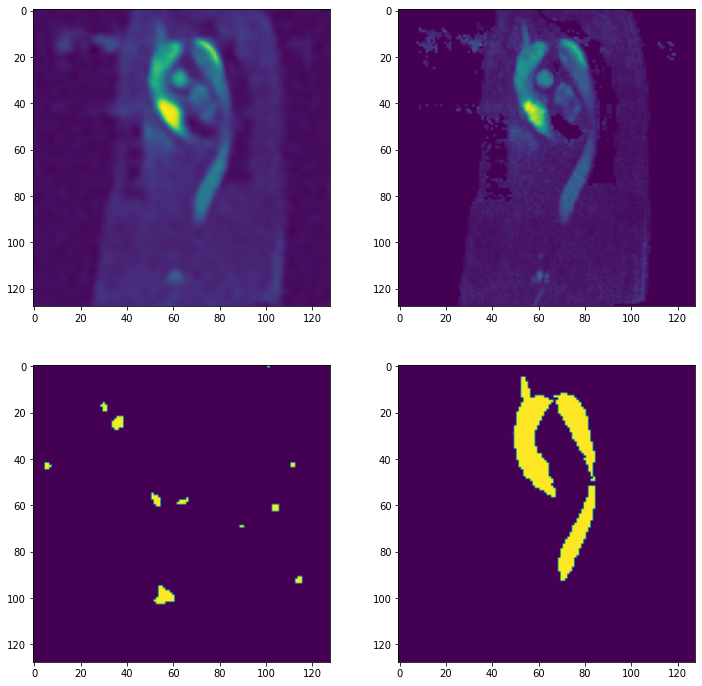

Batch 140 	 pcmra loss: 0.000329 	 mask loss: 0.038154
4.0534686718274315e-10
3.0778548534726724e-05
0.5279680311679816
0.999996542930603


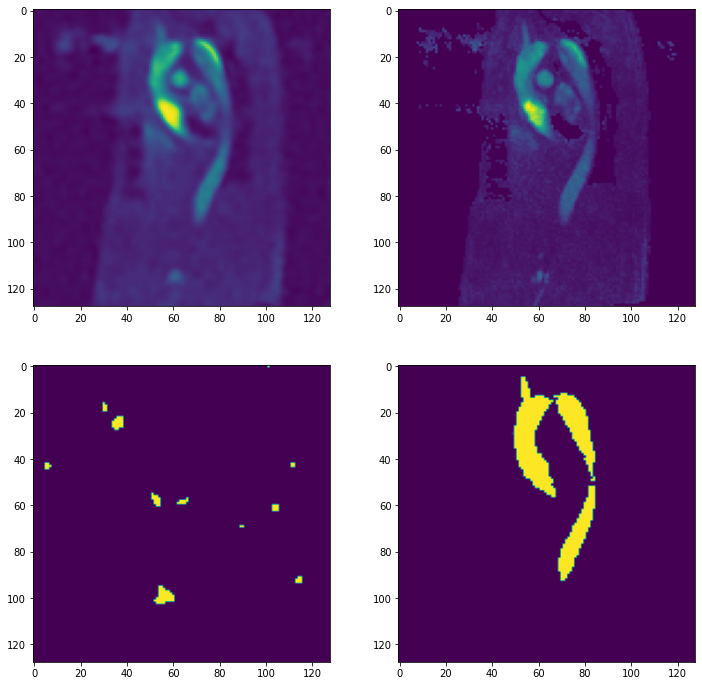

Batch 141 	 pcmra loss: 0.000329 	 mask loss: 0.038147
3.9470382517947655e-10
3.080484384554438e-05
0.5278464734554248
0.9999966621398926


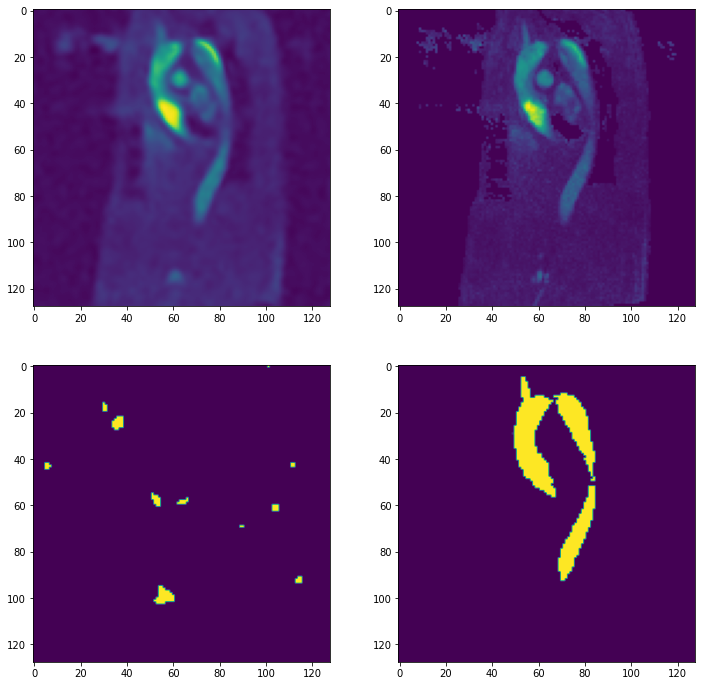

Batch 142 	 pcmra loss: 0.000328 	 mask loss: 0.03814
3.8482142472595626e-10
3.083054434682708e-05
0.5265424460172651
0.9999966621398926


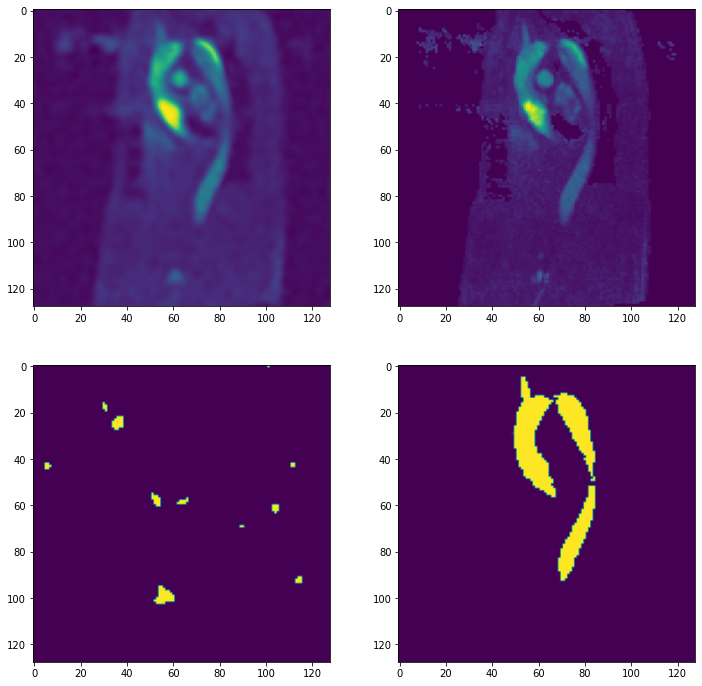

Batch 143 	 pcmra loss: 0.000327 	 mask loss: 0.038134
3.75613179448564e-10
3.0819050152786076e-05
0.5264856517314885
0.9999966621398926


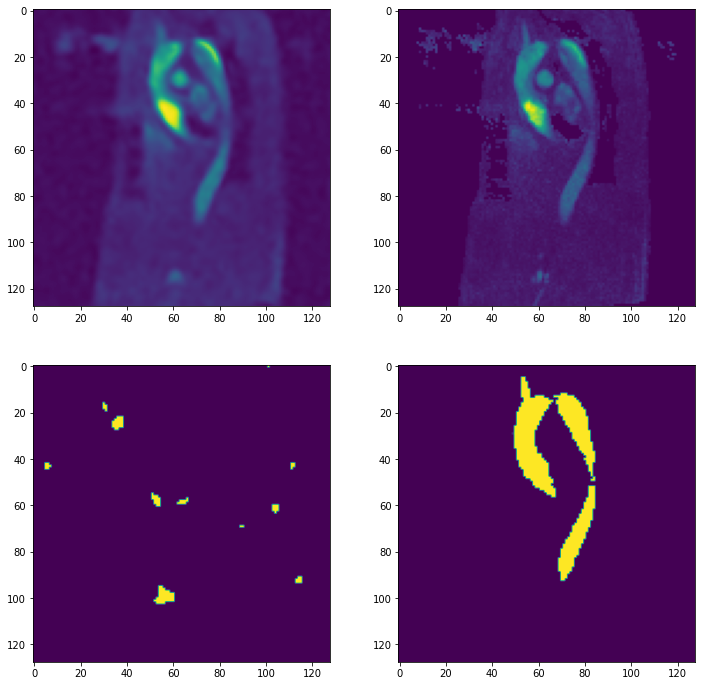

Batch 144 	 pcmra loss: 0.000326 	 mask loss: 0.038128
3.669821113660987e-10
3.0816187063464895e-05
0.5249347805976818
0.9999967813491821


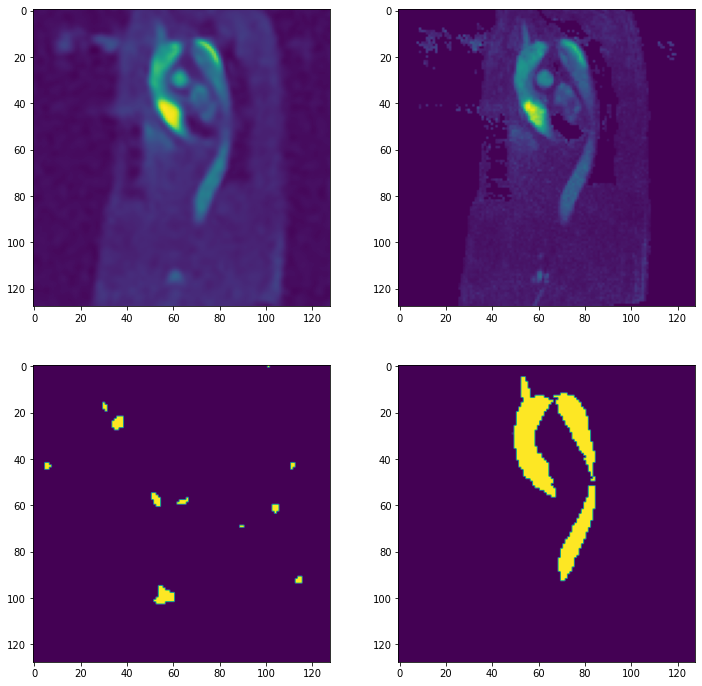

Batch 145 	 pcmra loss: 0.000325 	 mask loss: 0.038123
3.588127572839994e-10
3.0846940717310645e-05
0.524375087022781
0.9999967813491821


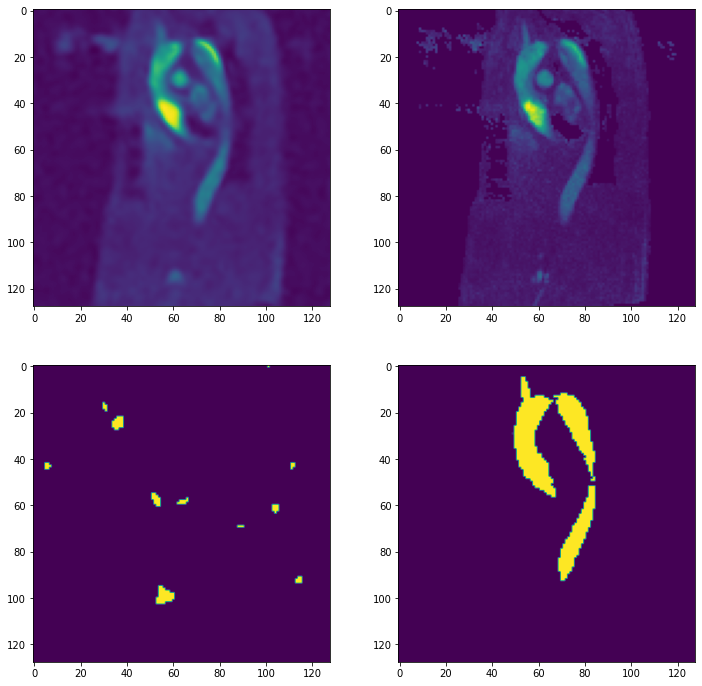

Batch 146 	 pcmra loss: 0.000324 	 mask loss: 0.038117
3.5102540318909803e-10
3.0857179808663204e-05
0.5233169496059388
0.9999969005584717


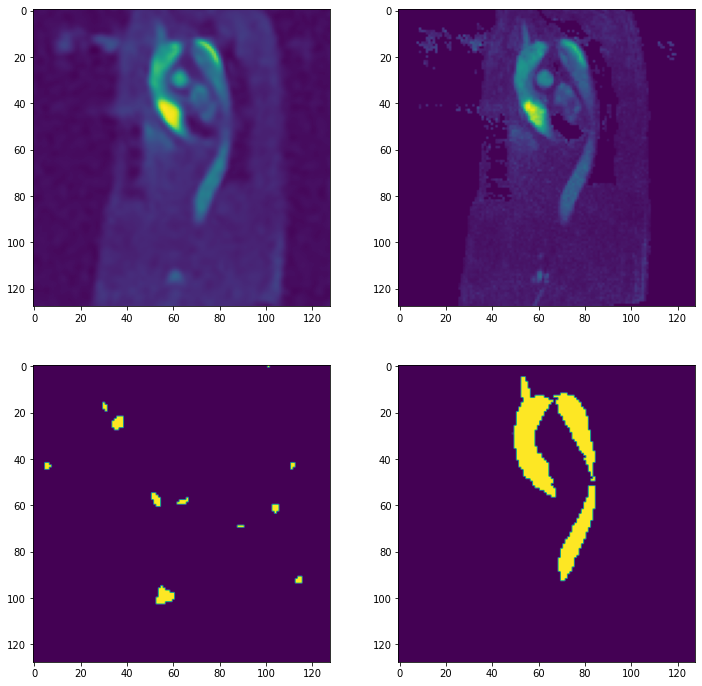

Batch 147 	 pcmra loss: 0.000323 	 mask loss: 0.038111
3.4356947842262286e-10
3.0856517696520314e-05
0.523023825883864
0.9999969005584717


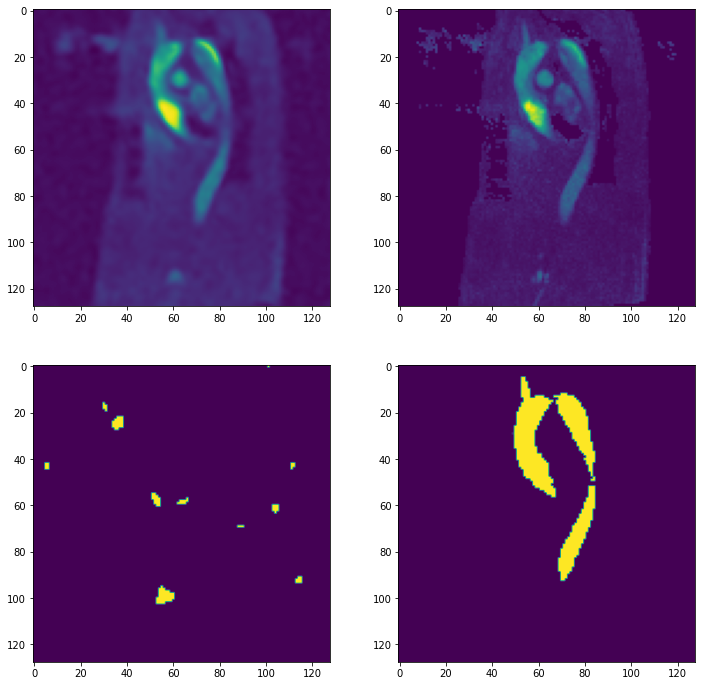

Batch 148 	 pcmra loss: 0.000322 	 mask loss: 0.038105
3.3644517727360324e-10
3.088539779128041e-05
0.5221056014299391
0.9999969005584717


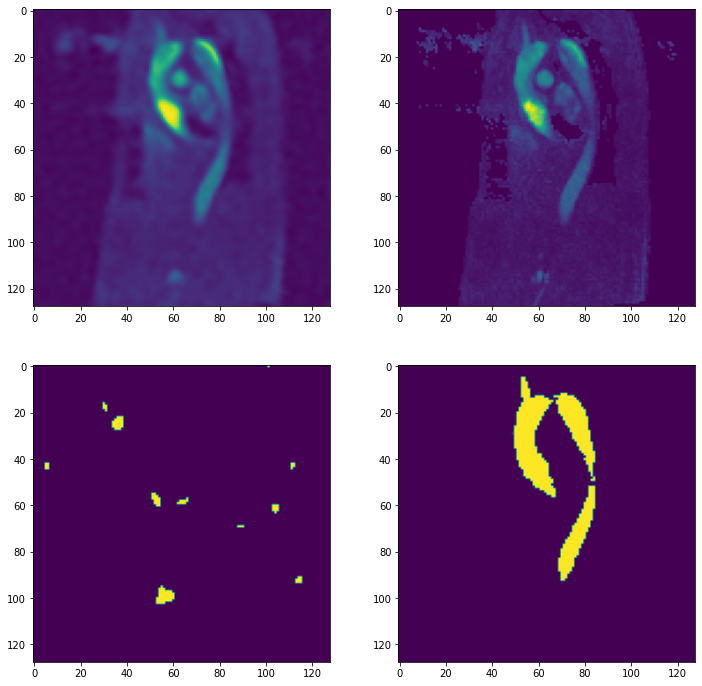

Batch 149 	 pcmra loss: 0.000322 	 mask loss: 0.038099
3.296609651926019e-10
3.0916589821572416e-05
0.5215778559446296
0.9999970197677612


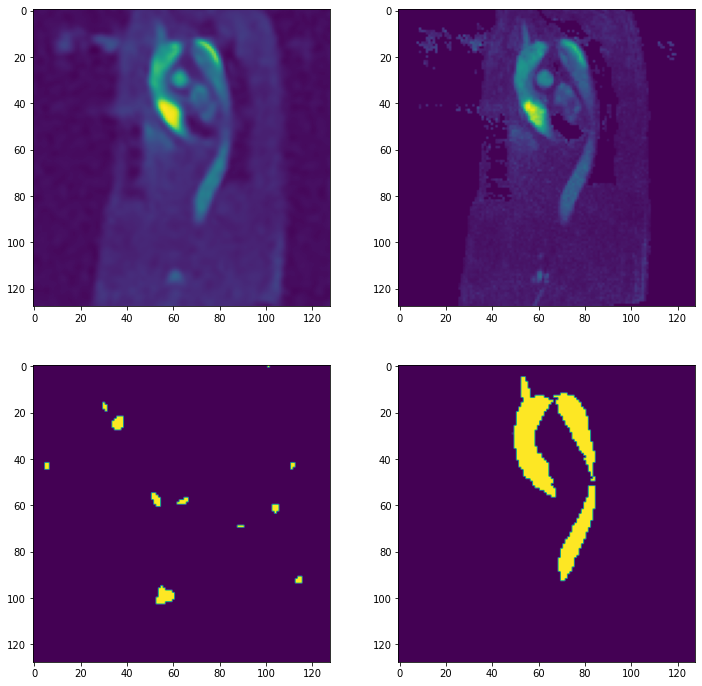

Batch 150 	 pcmra loss: 0.000321 	 mask loss: 0.038094
3.232347722814666e-10
3.092708720942028e-05
0.5204086780548056
0.9999970197677612


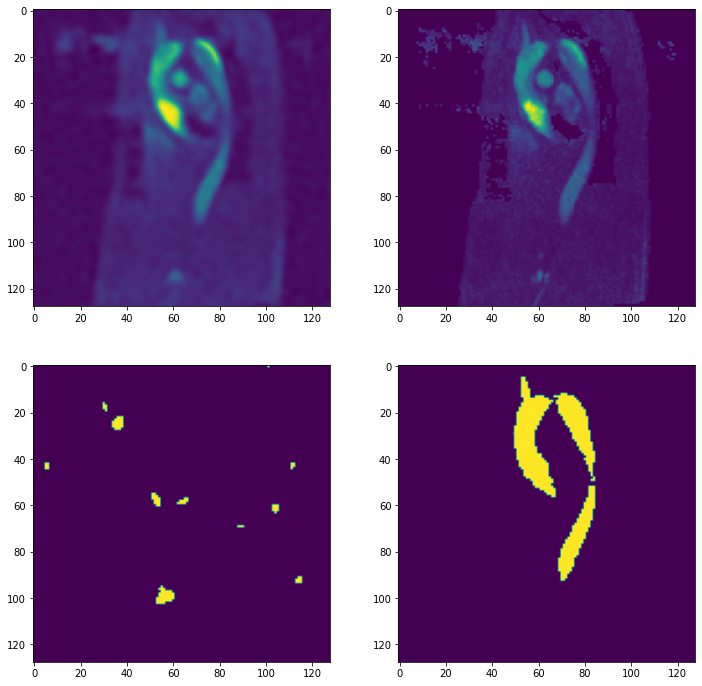

Batch 151 	 pcmra loss: 0.00032 	 mask loss: 0.038089
3.1718669357694296e-10
3.0948727726354264e-05
0.5201459497213363
0.9999971389770508


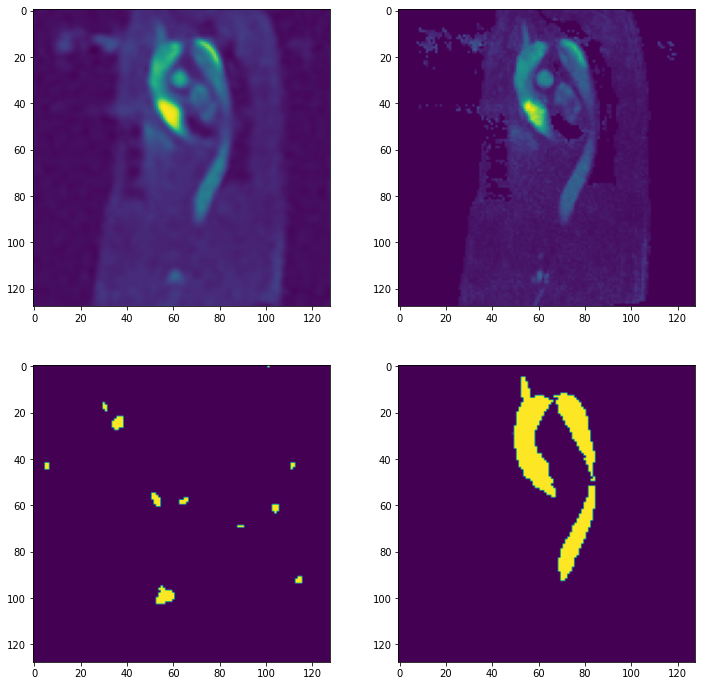

Batch 152 	 pcmra loss: 0.000319 	 mask loss: 0.038085
3.114988544883346e-10
3.096905675192829e-05
0.5205905109643894
0.9999972581863403


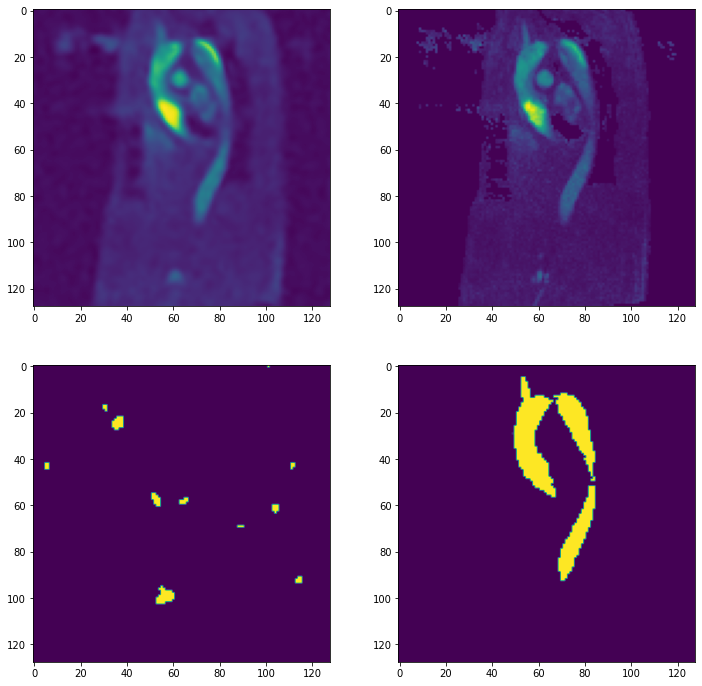

Batch 153 	 pcmra loss: 0.000318 	 mask loss: 0.03808
3.061650932778548e-10
3.100624599028379e-05
0.5192176848649968
0.9999972581863403


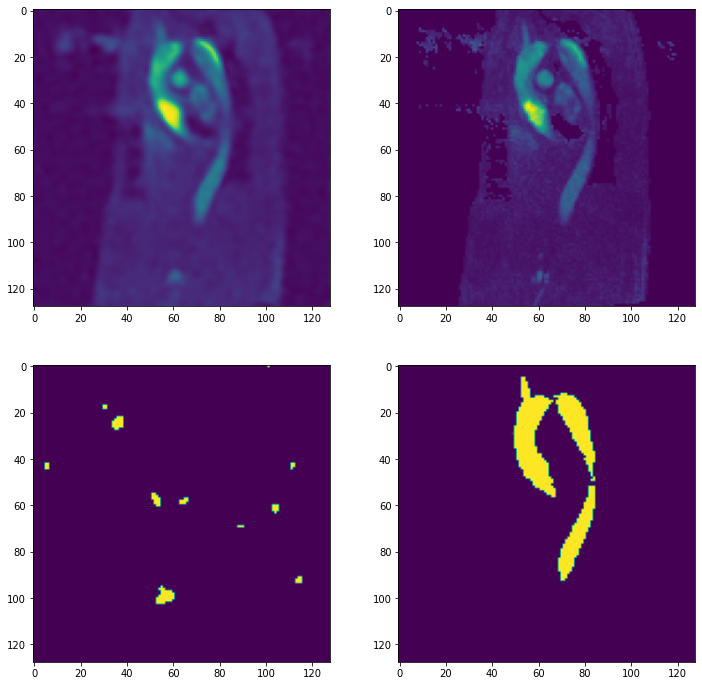

Batch 154 	 pcmra loss: 0.000318 	 mask loss: 0.038075
3.011569882360732e-10
3.103642120549921e-05
0.5191439628601051
0.9999973773956299


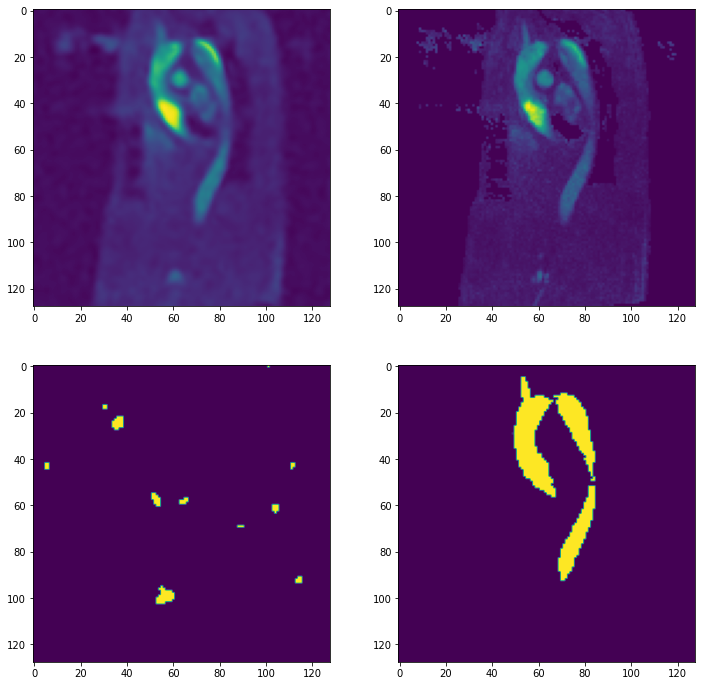

Batch 155 	 pcmra loss: 0.000317 	 mask loss: 0.038071
2.964664624904856e-10
3.1067824238562025e-05
0.5185935020446754
0.9999974966049194


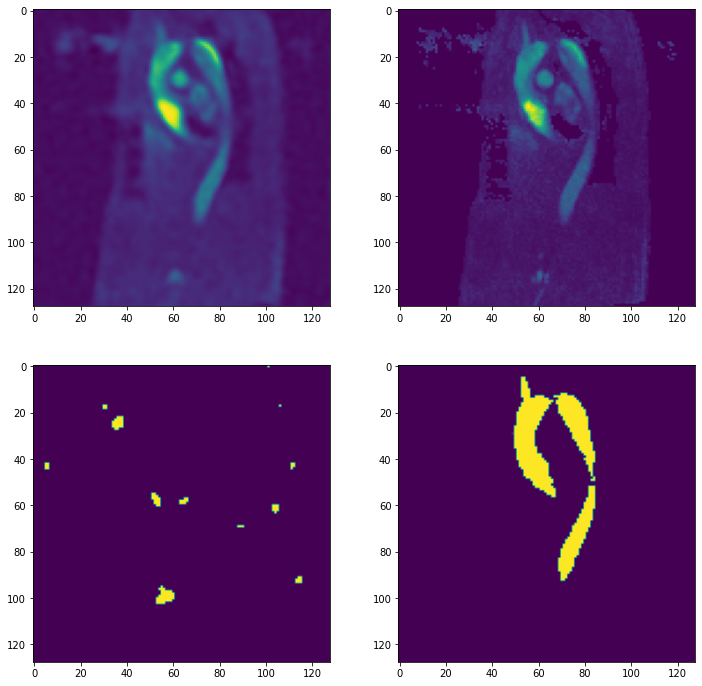

Batch 156 	 pcmra loss: 0.000316 	 mask loss: 0.038066
2.9207403162700984e-10
3.109293174929917e-05
0.5181705534458148
0.9999974966049194


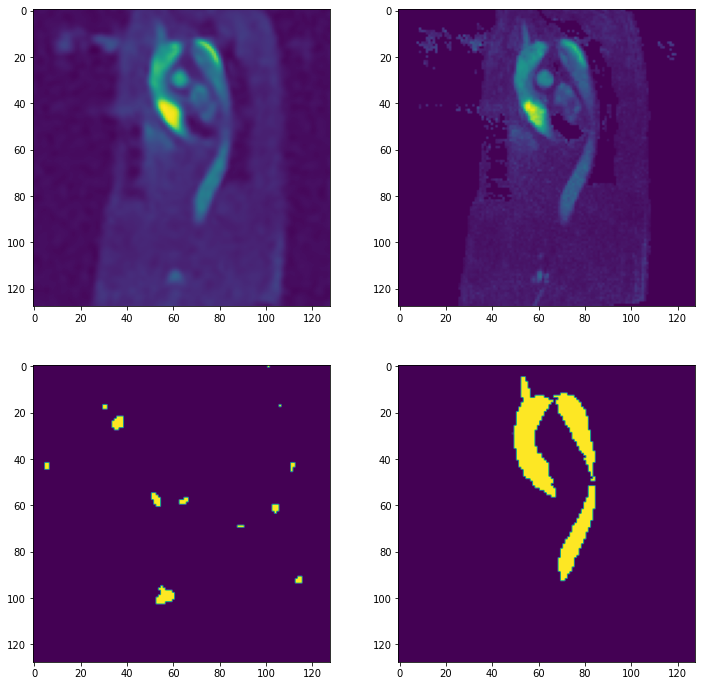

Batch 157 	 pcmra loss: 0.000315 	 mask loss: 0.038062
2.8792782047482035e-10
3.111105252173729e-05
0.5182723075151439
0.999997615814209


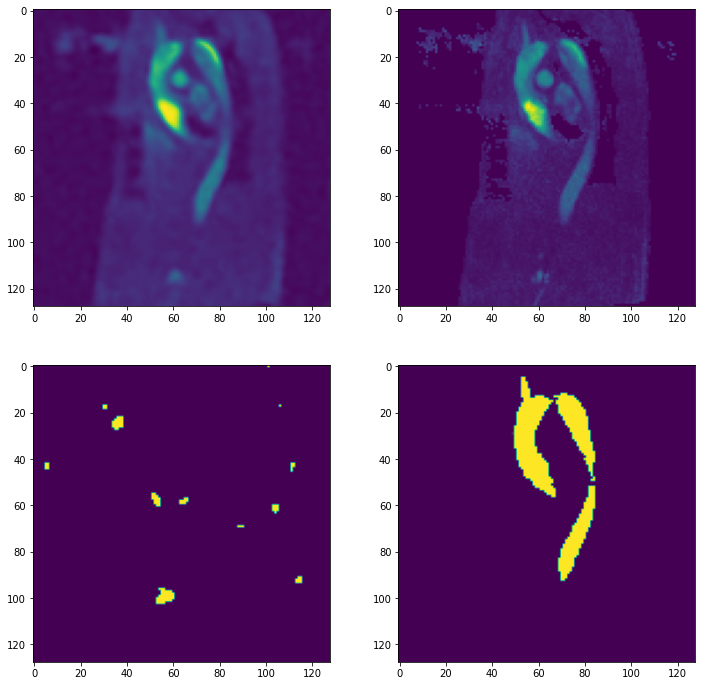

Batch 158 	 pcmra loss: 0.000314 	 mask loss: 0.038058
2.8399591012195913e-10
3.1123590815695934e-05
0.5180008798837656
0.999997615814209


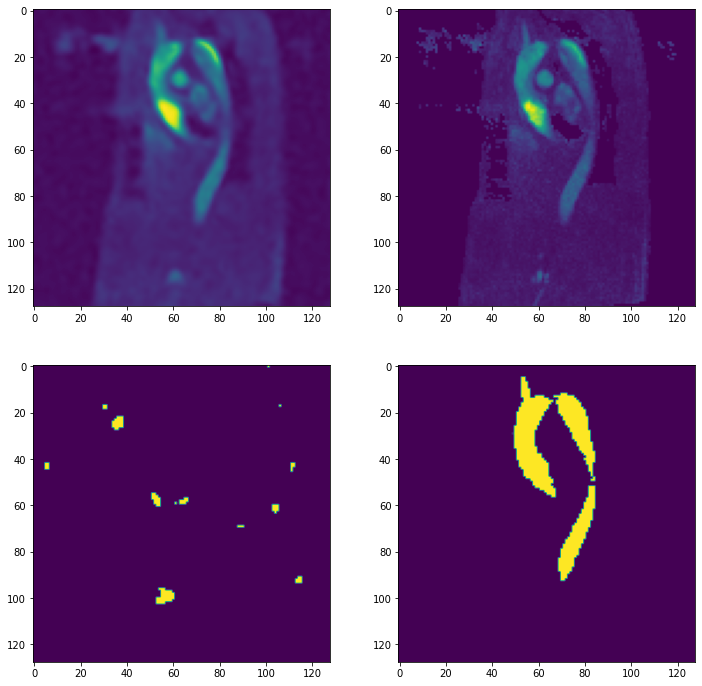

Batch 159 	 pcmra loss: 0.000314 	 mask loss: 0.038054
2.8025817777610484e-10
3.1140883947955444e-05
0.5179222226142882
0.9999977350234985


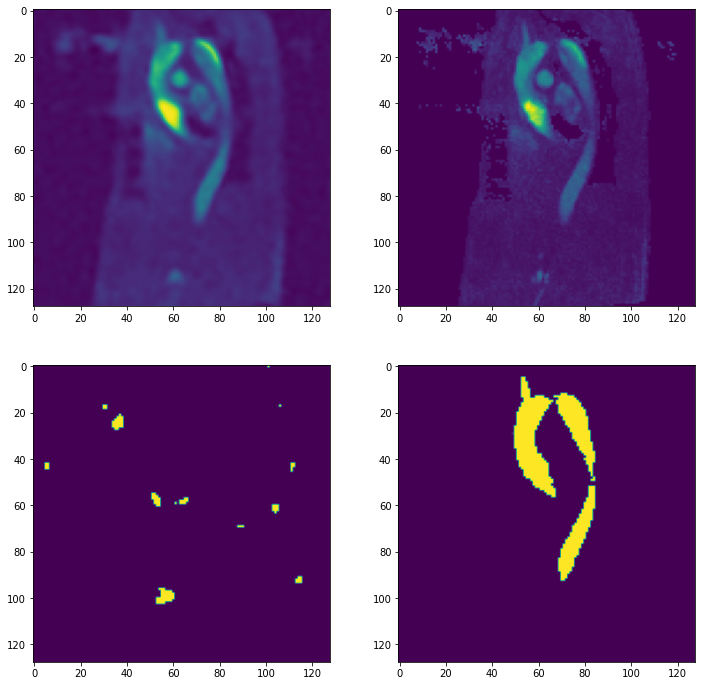

Batch 160 	 pcmra loss: 0.000313 	 mask loss: 0.03805
2.7670266078416716e-10
3.117453525192104e-05
0.5177547395229275
0.9999978542327881


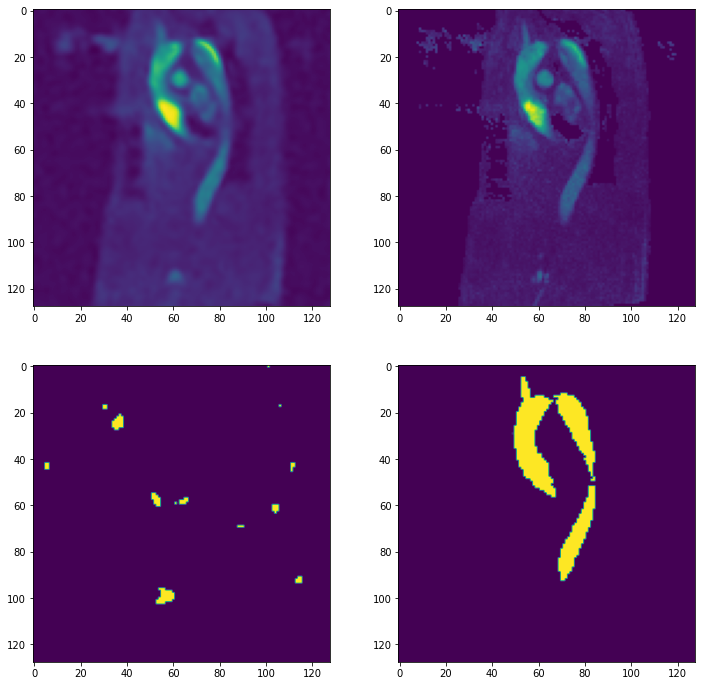

Batch 161 	 pcmra loss: 0.000312 	 mask loss: 0.038046
2.733100412655176e-10
3.120720975857694e-05
0.5173253715038246
0.9999978542327881


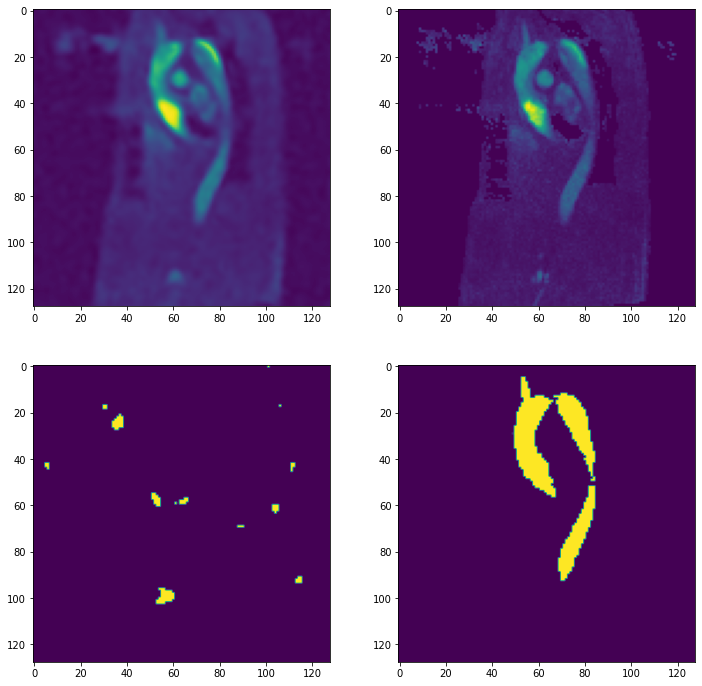

Batch 162 	 pcmra loss: 0.000312 	 mask loss: 0.038043
2.7008362213365444e-10
3.1223105906974524e-05
0.5183527678251254
0.9999979734420776


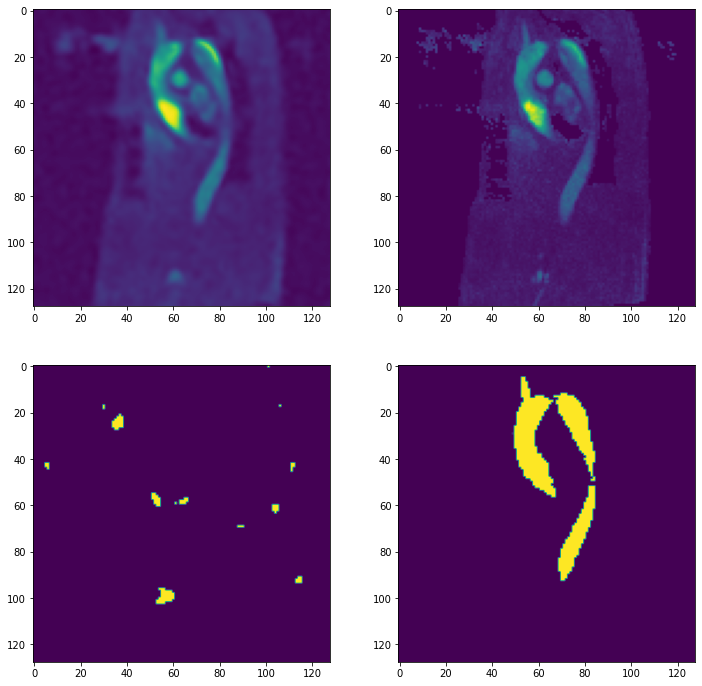

Batch 163 	 pcmra loss: 0.000311 	 mask loss: 0.03804
2.6701699185061045e-10
3.123777423752472e-05
0.5176198780536645
0.9999979734420776


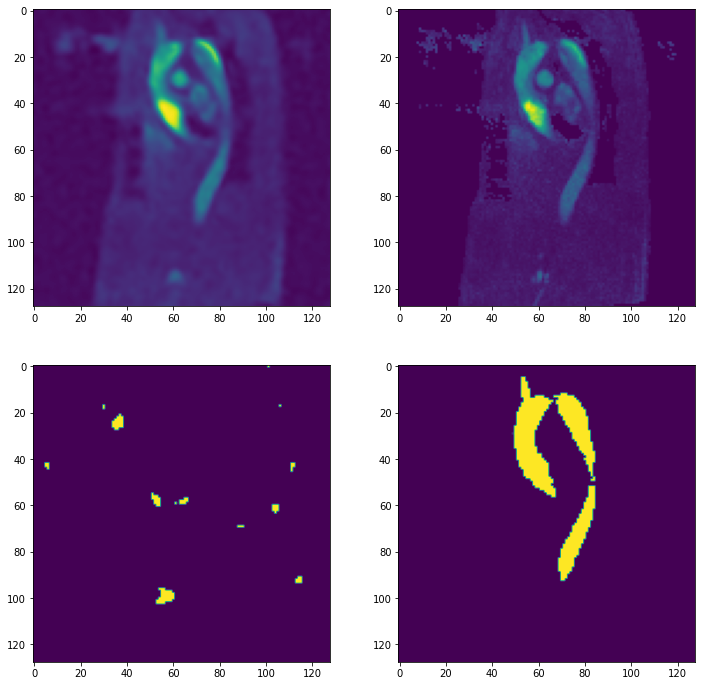

Batch 164 	 pcmra loss: 0.00031 	 mask loss: 0.038038
2.641196705788218e-10
3.126581941614859e-05
0.5177759617567044
0.9999979734420776


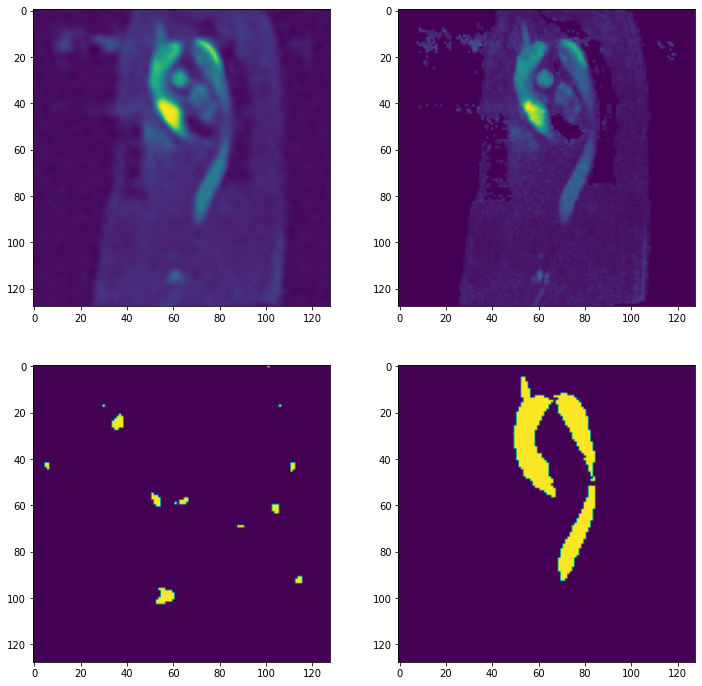

Batch 165 	 pcmra loss: 0.000309 	 mask loss: 0.038035
2.613948502094843e-10
3.1268562452169135e-05
0.517642289400099
0.9999980926513672


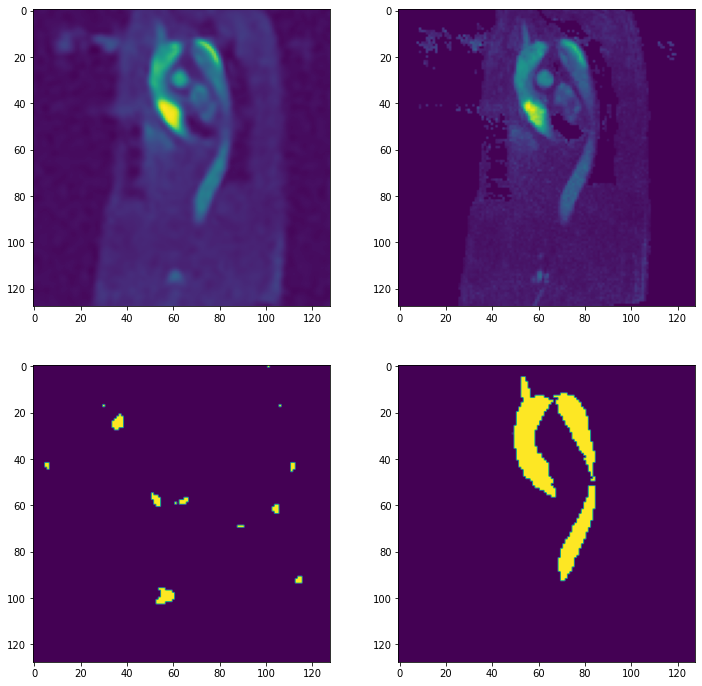

Batch 166 	 pcmra loss: 0.000309 	 mask loss: 0.038032
2.5884172583090503e-10
3.129779906885233e-05
0.5170394539833068
0.9999980926513672


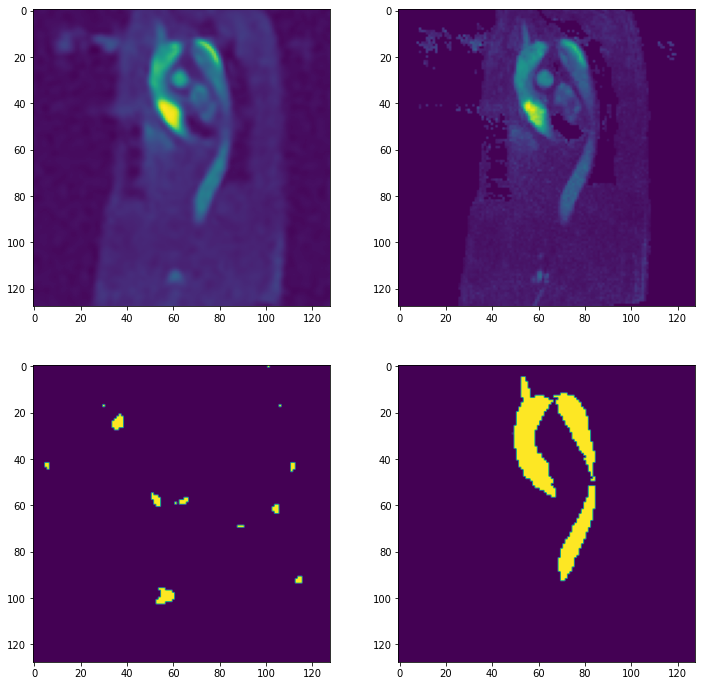

Batch 167 	 pcmra loss: 0.000308 	 mask loss: 0.03803
2.5644072976227505e-10
3.1292636776925065e-05
0.5189614981412827
0.9999982118606567


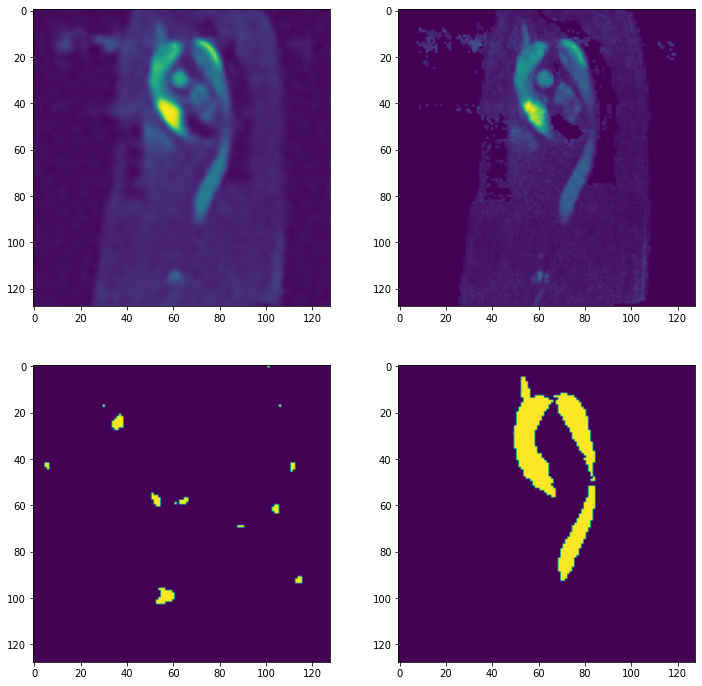

Batch 168 	 pcmra loss: 0.000307 	 mask loss: 0.038028
2.5417781768233283e-10
3.129923061351292e-05
0.5190181195735847
0.9999982118606567


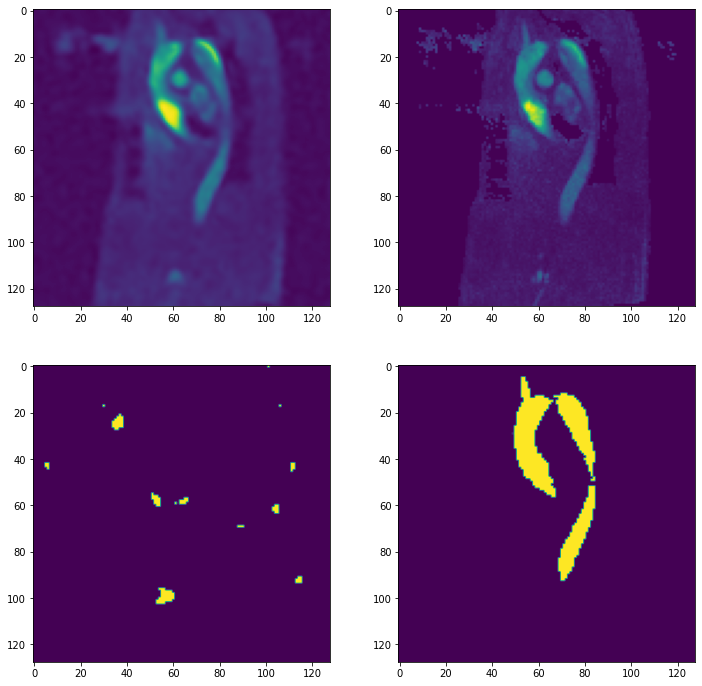

Batch 169 	 pcmra loss: 0.000307 	 mask loss: 0.038026
2.5203963915920724e-10
3.129320248262957e-05
0.5181748807430258
0.9999982118606567


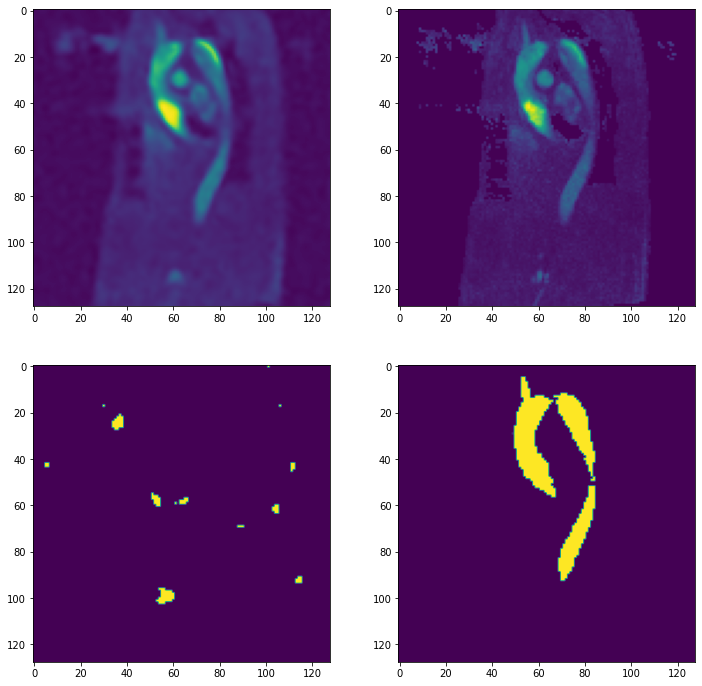

Batch 170 	 pcmra loss: 0.000306 	 mask loss: 0.038024
2.5002486192526874e-10
3.1300962291425094e-05
0.5194663941860189
0.9999983310699463


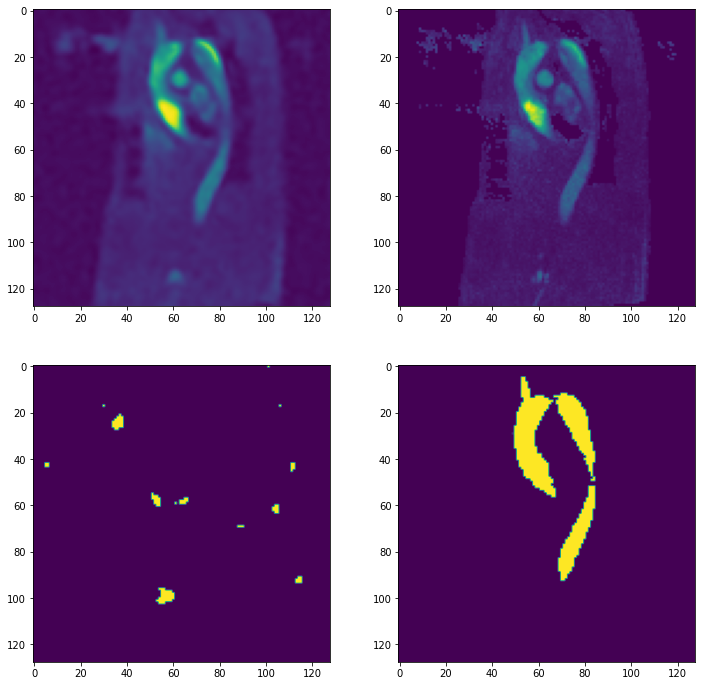

Batch 171 	 pcmra loss: 0.000305 	 mask loss: 0.038022
2.481160554790307e-10
3.1320667403633706e-05
0.5191170066594987
0.9999983310699463


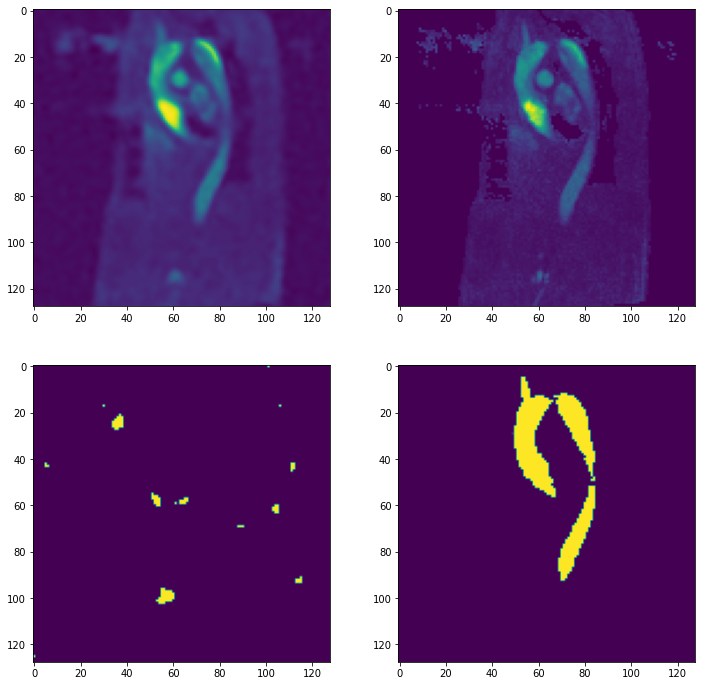

Batch 172 	 pcmra loss: 0.000305 	 mask loss: 0.03802
2.463101111960242e-10
3.132419442408718e-05
0.5181572496890976
0.9999983310699463


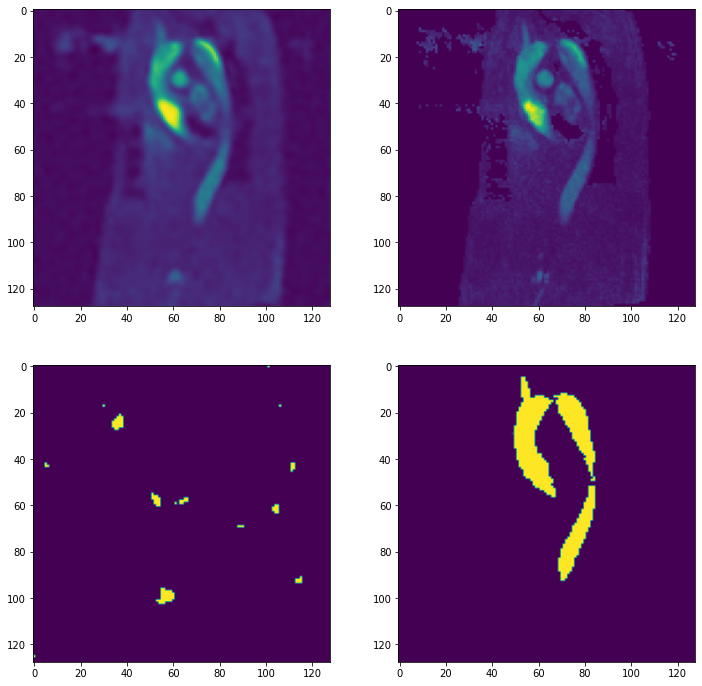

Batch 173 	 pcmra loss: 0.000304 	 mask loss: 0.038019
2.4461904724049077e-10
3.131496487185359e-05
0.5182668745517721
0.9999983310699463


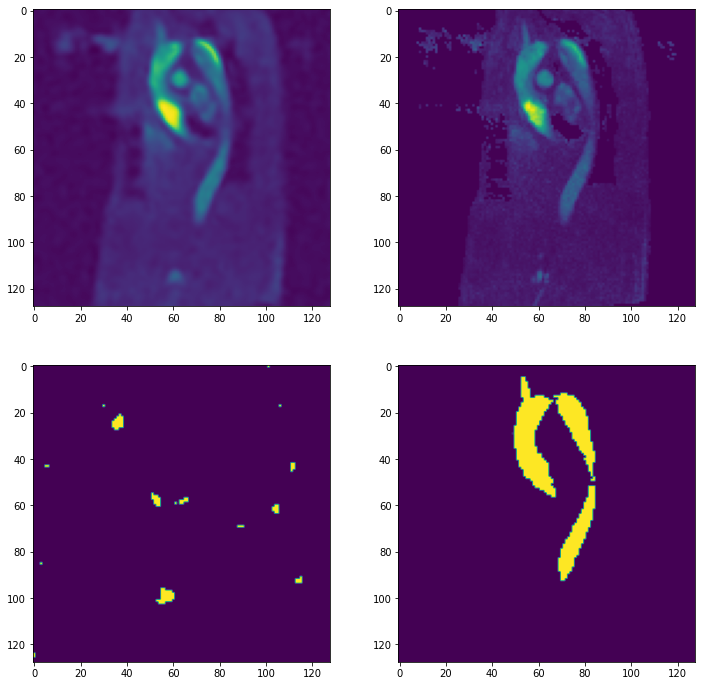

Batch 174 	 pcmra loss: 0.000303 	 mask loss: 0.038018
2.430433632127915e-10
3.1320862035499886e-05
0.5187088936567303
0.9999984502792358


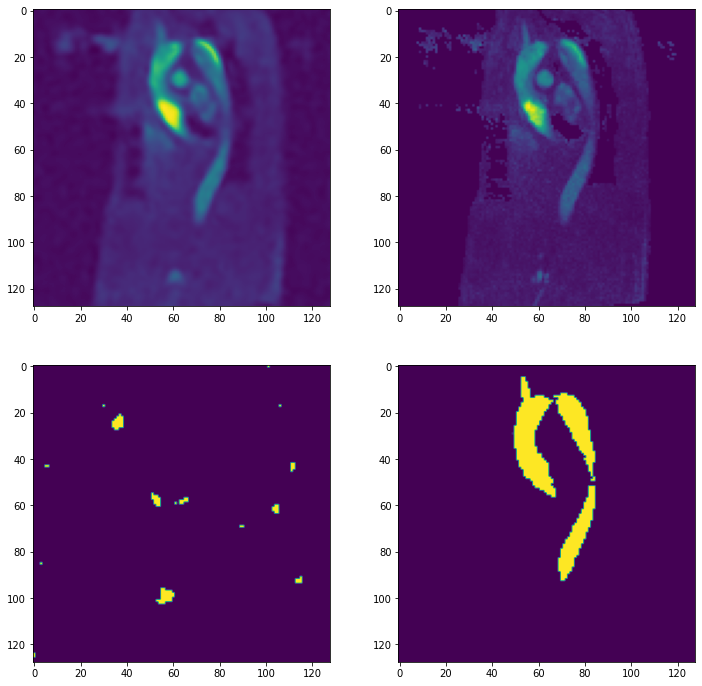

Batch 175 	 pcmra loss: 0.000303 	 mask loss: 0.038016
2.4156354694326865e-10
3.1336712709162384e-05
0.5183496057987198
0.9999984502792358


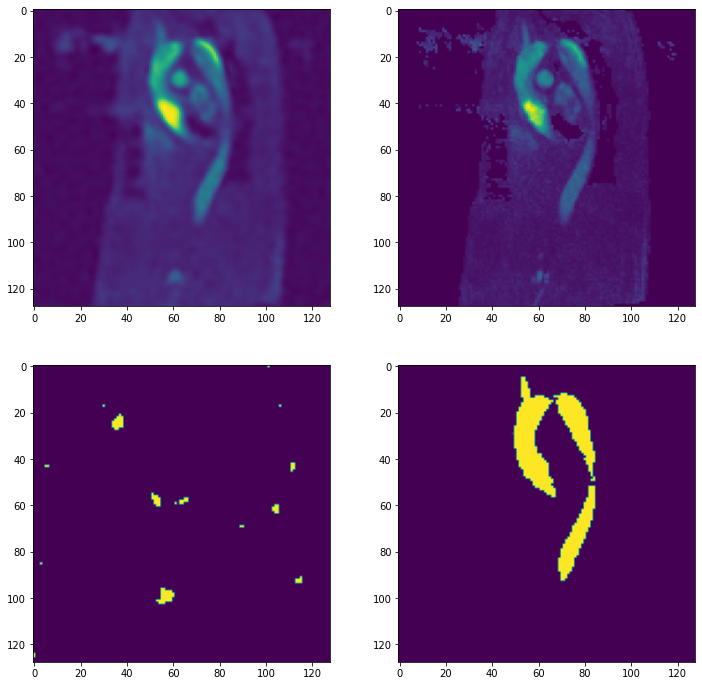

Batch 176 	 pcmra loss: 0.000302 	 mask loss: 0.038015
2.401848164801379e-10
3.1342495276476257e-05
0.5180883169174085
0.9999984502792358


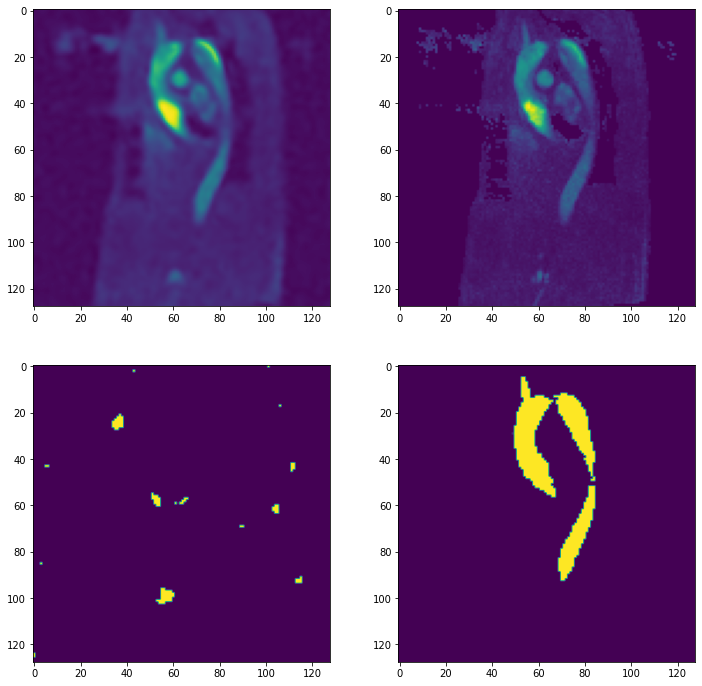

Batch 177 	 pcmra loss: 0.000301 	 mask loss: 0.038014
2.388772513128856e-10
3.13586260745069e-05
0.5180445671081538
0.9999984502792358


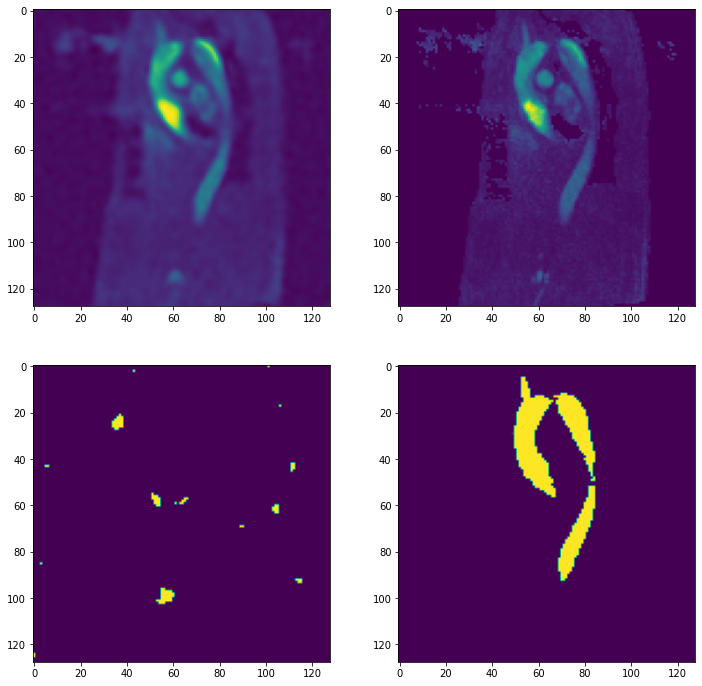

Batch 178 	 pcmra loss: 0.000301 	 mask loss: 0.038013
2.376339403031835e-10
3.137907151540276e-05
0.5175656974315633
0.9999985694885254


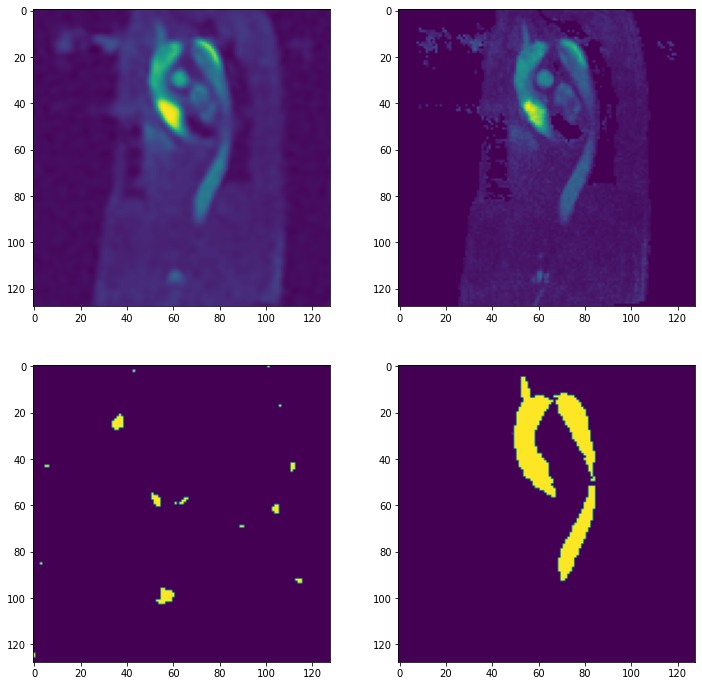

Batch 179 	 pcmra loss: 0.0003 	 mask loss: 0.038012
2.364629048123845e-10
3.138374086120166e-05
0.5188643664121544
0.9999985694885254


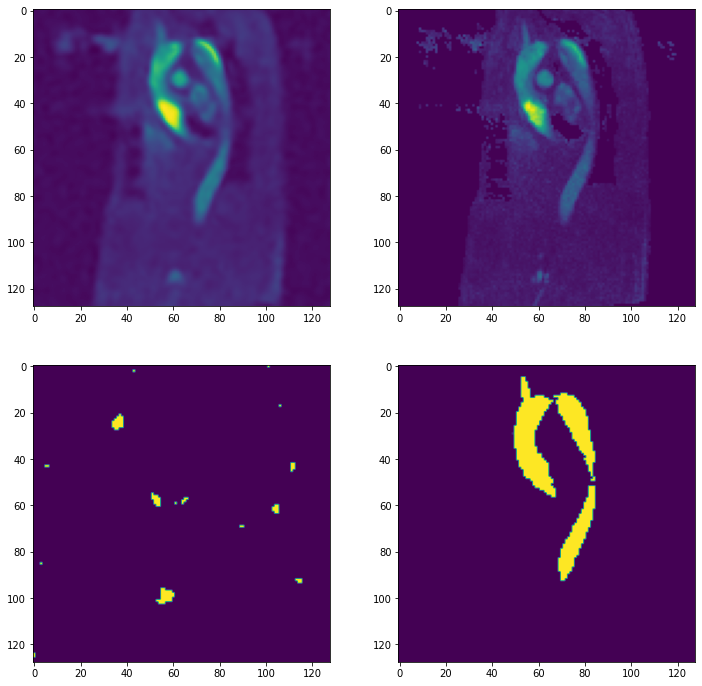

Batch 180 	 pcmra loss: 0.0003 	 mask loss: 0.038011
2.353550965228379e-10
3.142046989523806e-05
0.517334073781965
0.9999985694885254


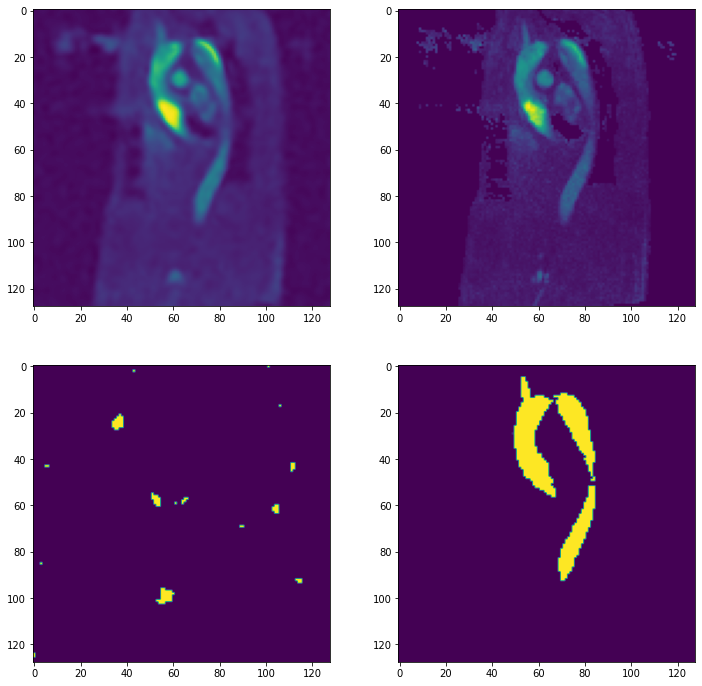

Batch 181 	 pcmra loss: 0.000299 	 mask loss: 0.03801
2.3430252182876643e-10
3.1443851185031235e-05
0.5167352676391598
0.9999985694885254


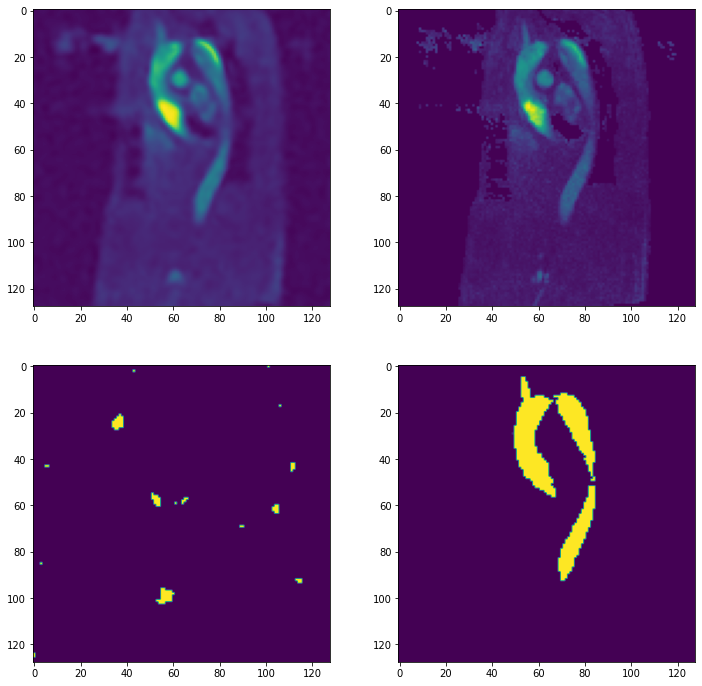

Batch 182 	 pcmra loss: 0.000298 	 mask loss: 0.038009
2.33311175934503e-10
3.147838287986815e-05
0.5165895432233726
0.9999985694885254


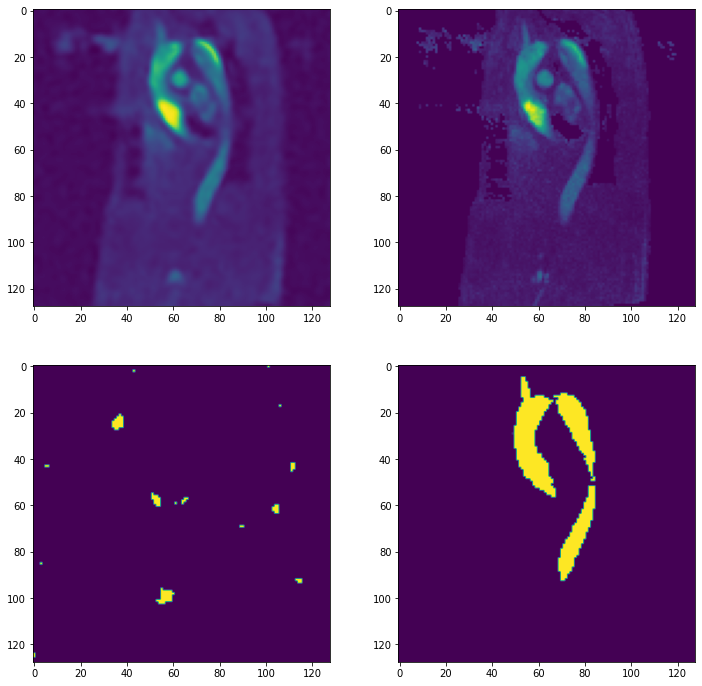

Batch 183 	 pcmra loss: 0.000298 	 mask loss: 0.038009
2.3237056723246496e-10
3.146802737319376e-05
0.51649956703186
0.9999986886978149


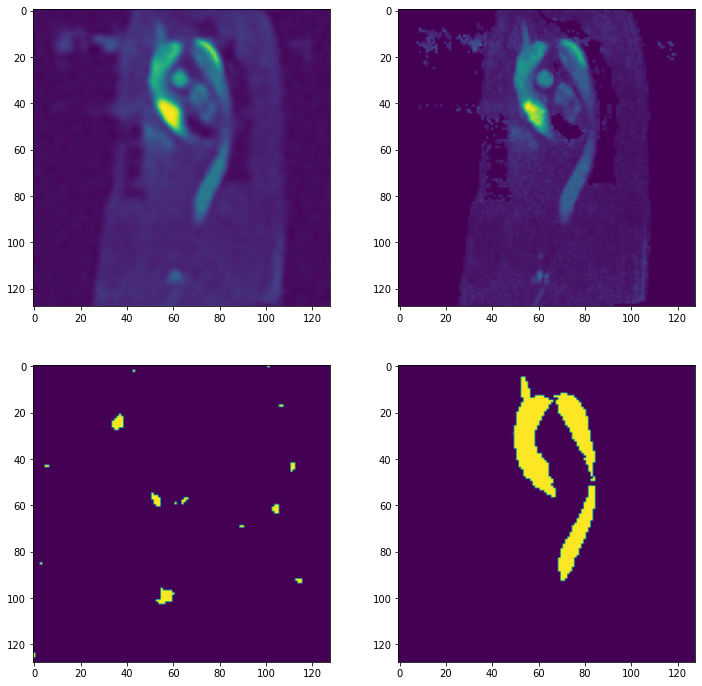

Batch 184 	 pcmra loss: 0.000297 	 mask loss: 0.038008
2.3148848116161247e-10
3.148988253087737e-05
0.516929951310152
0.9999986886978149


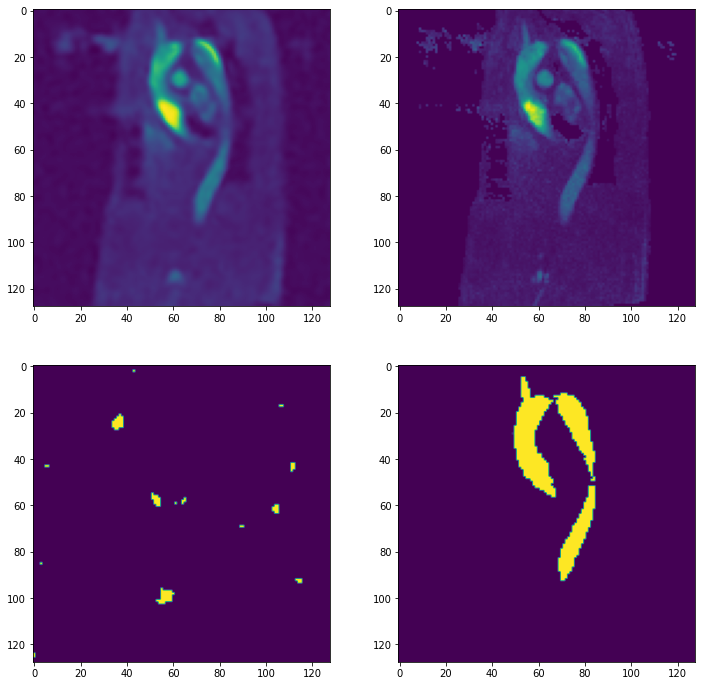

Batch 185 	 pcmra loss: 0.000297 	 mask loss: 0.038007
2.306480006986078e-10
3.153868965455331e-05
0.517392605543133
0.9999986886978149


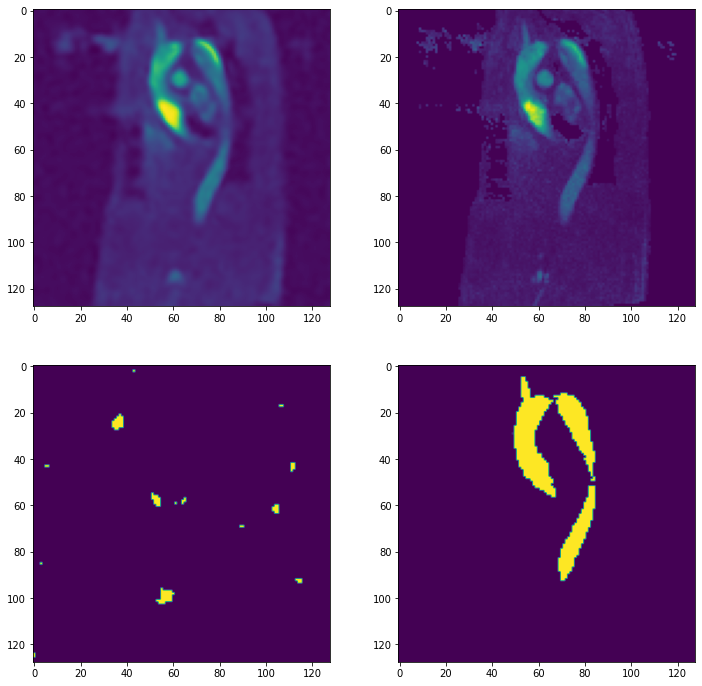

Batch 186 	 pcmra loss: 0.000296 	 mask loss: 0.038007
2.2984698866412856e-10
3.1561254218104295e-05
0.5176550328731533
0.9999986886978149


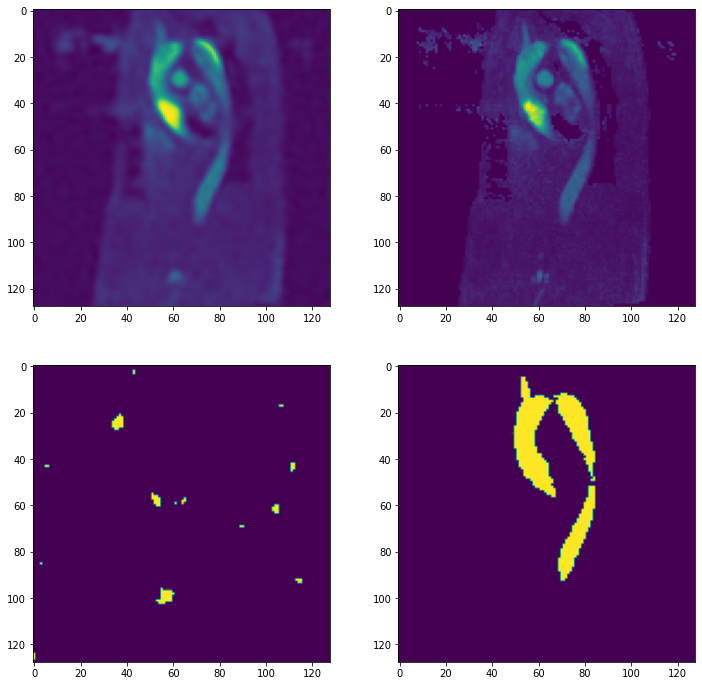

Batch 187 	 pcmra loss: 0.000296 	 mask loss: 0.038006
2.2907058194743257e-10
3.15669003612129e-05
0.517303964495658
0.9999986886978149


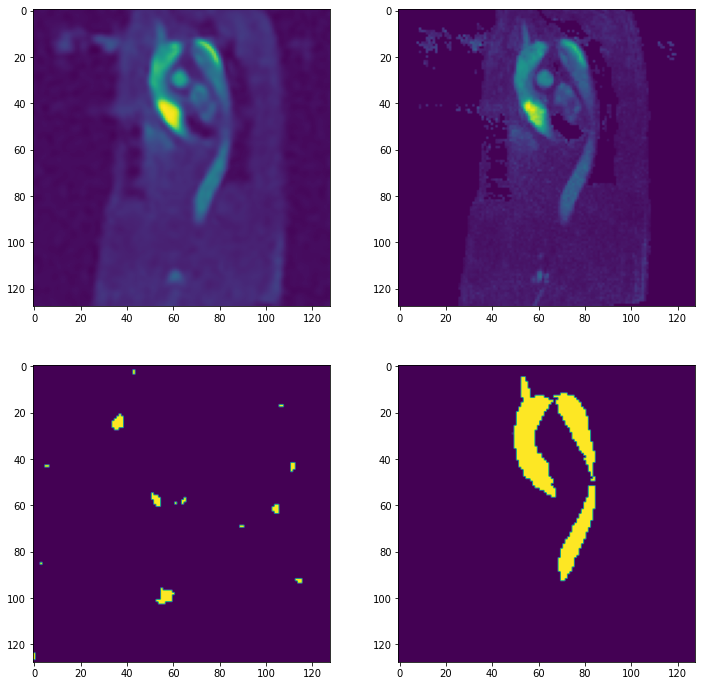

Batch 188 	 pcmra loss: 0.000295 	 mask loss: 0.038006
2.2832816193307792e-10
3.158686376991682e-05
0.51707010269165
0.9999986886978149


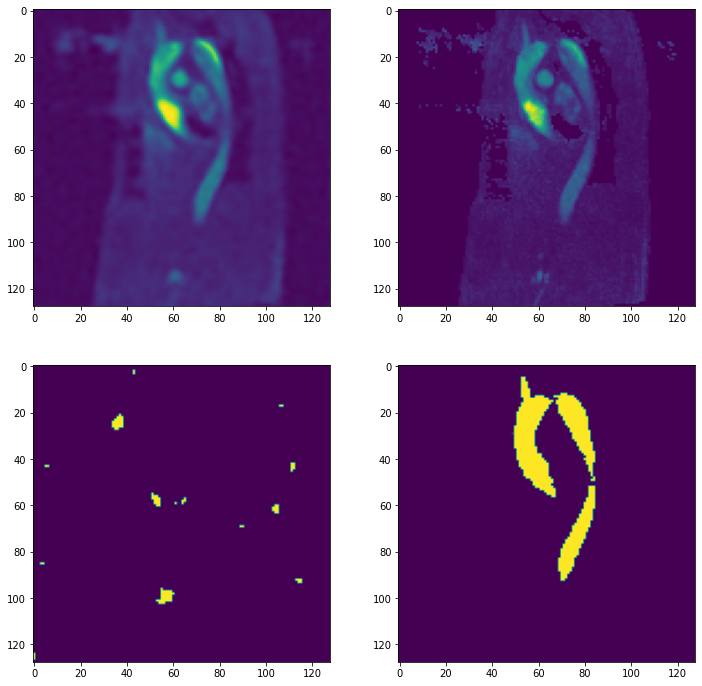

Batch 189 	 pcmra loss: 0.000294 	 mask loss: 0.038005
2.276007160517679e-10
3.1595691325492226e-05
0.5174848169088311
0.9999986886978149


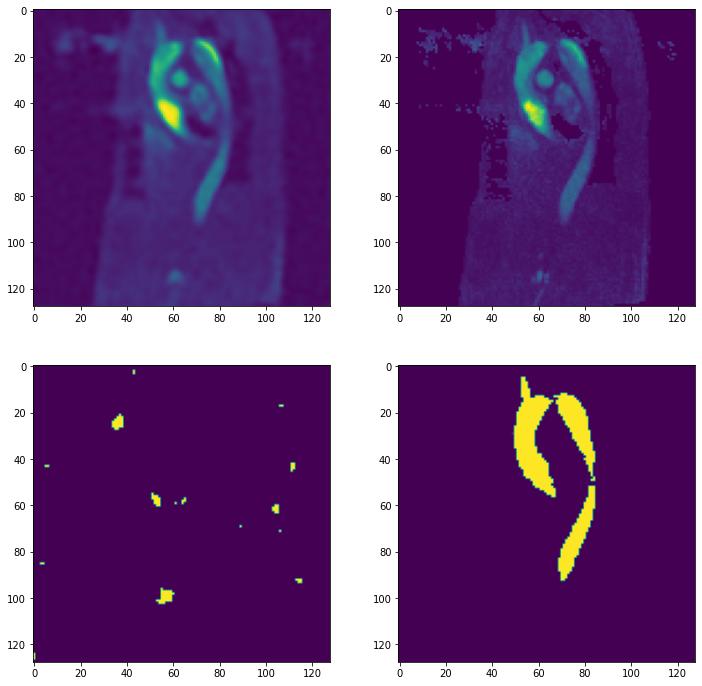

Batch 190 	 pcmra loss: 0.000294 	 mask loss: 0.038005
2.2688900758183195e-10
3.159331208735239e-05
0.5176994293928008
0.9999988079071045


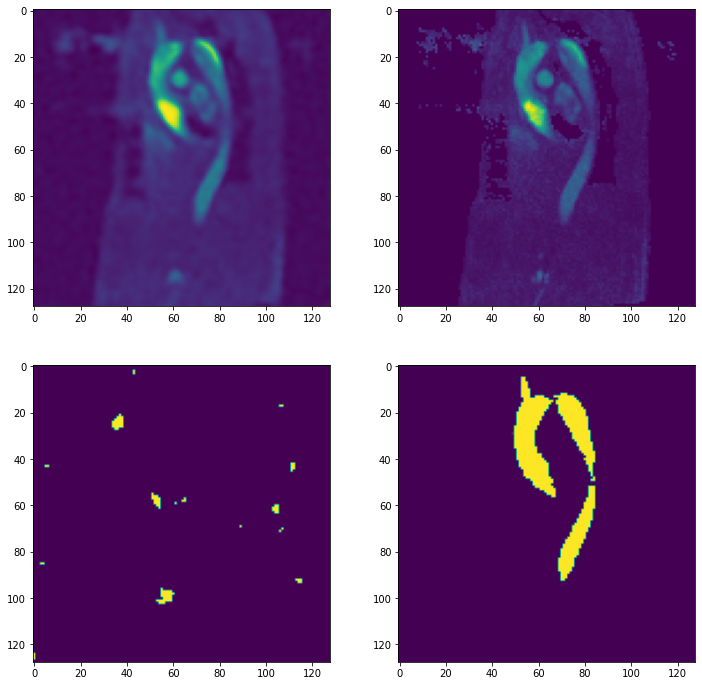

Batch 191 	 pcmra loss: 0.000293 	 mask loss: 0.038004
2.2620240403004033e-10
3.1597994166077115e-05
0.5168898075818998
0.9999988079071045


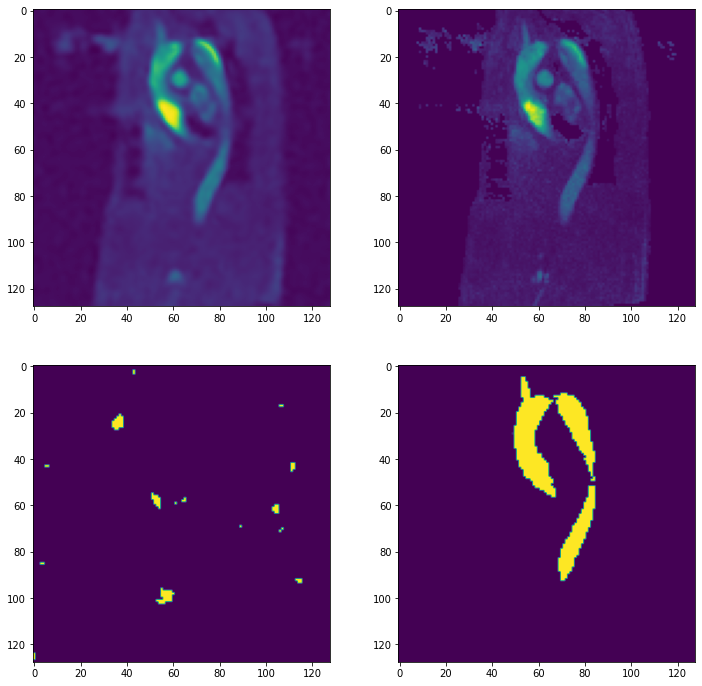

Batch 192 	 pcmra loss: 0.000293 	 mask loss: 0.038004
2.2553810208325586e-10
3.1620304071111605e-05
0.5159804224967905
0.9999988079071045


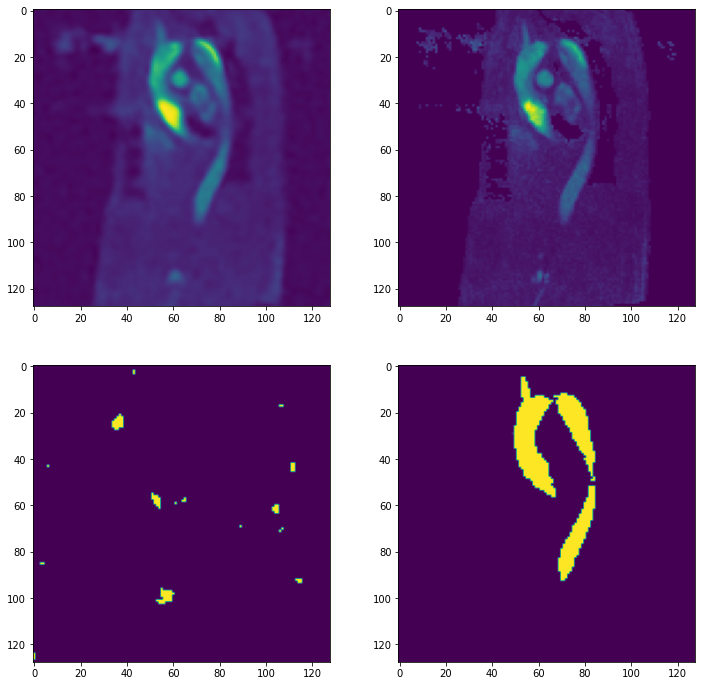

Batch 193 	 pcmra loss: 0.000292 	 mask loss: 0.038003
2.248881775246403e-10
3.1634612241759896e-05
0.5159565329551696
0.9999988079071045


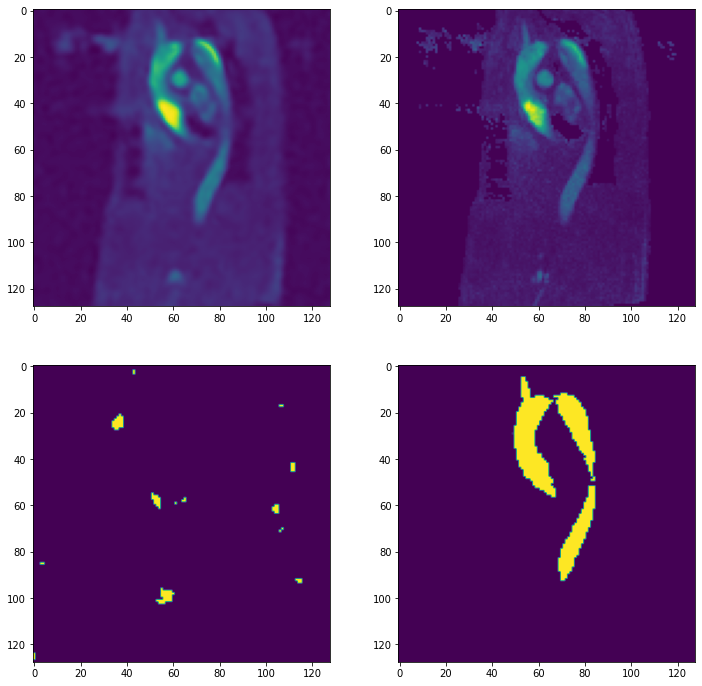

Batch 194 	 pcmra loss: 0.000292 	 mask loss: 0.038003
2.2426278889486895e-10
3.1653566111344844e-05
0.5164335191249828
0.9999988079071045


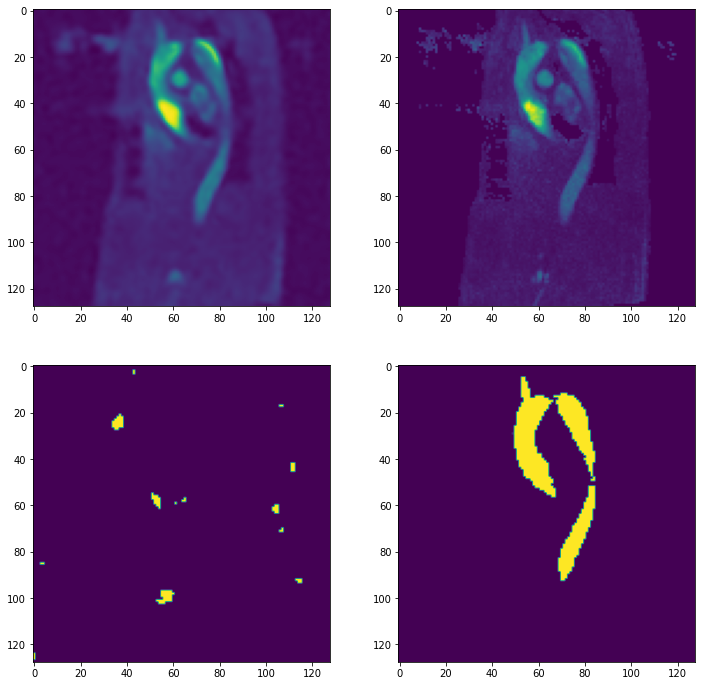

Batch 195 	 pcmra loss: 0.000291 	 mask loss: 0.038002
2.2365236052035442e-10
3.1636227504350245e-05
0.5170455157756716
0.9999988079071045


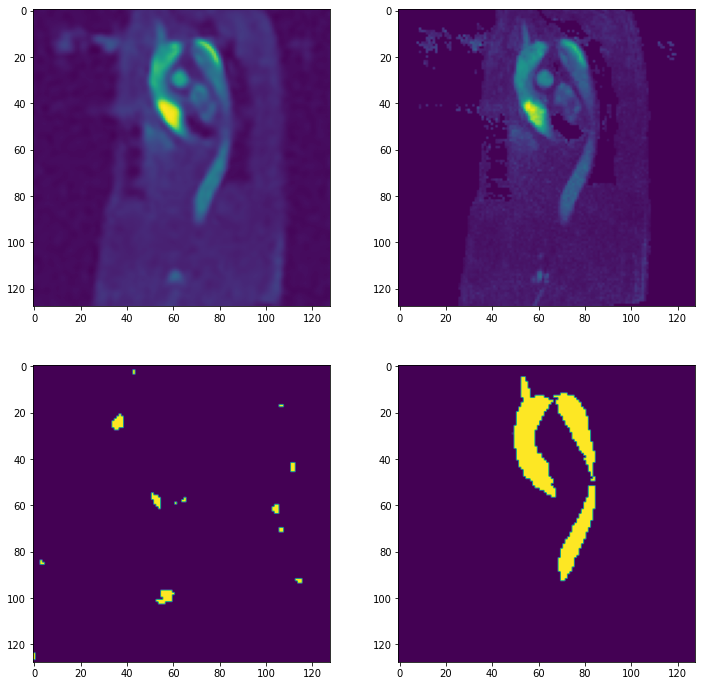

Batch 196 	 pcmra loss: 0.000291 	 mask loss: 0.038002
2.2305381153220338e-10
3.165812449879013e-05
0.5167325735092114
0.9999988079071045


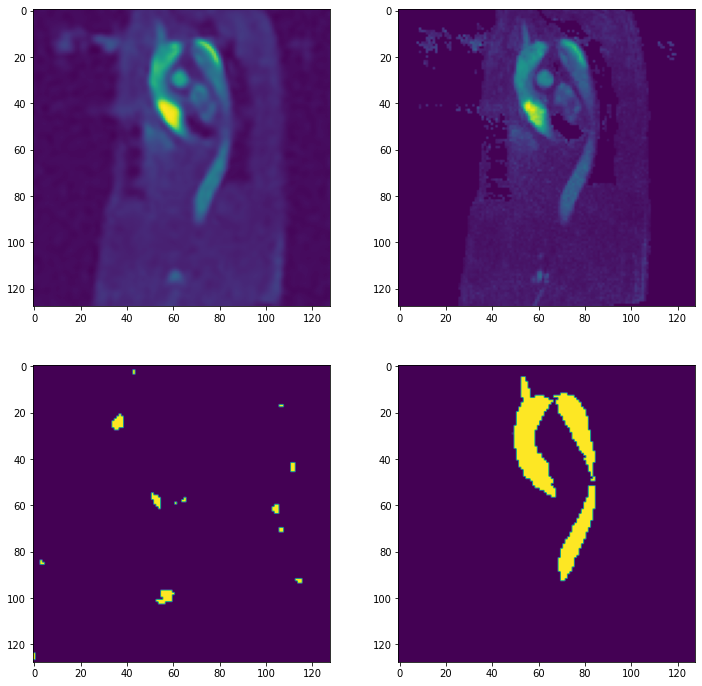

Batch 197 	 pcmra loss: 0.00029 	 mask loss: 0.038002
2.2245985609181673e-10
3.1670126190874726e-05
0.5164006024598995
0.9999988079071045


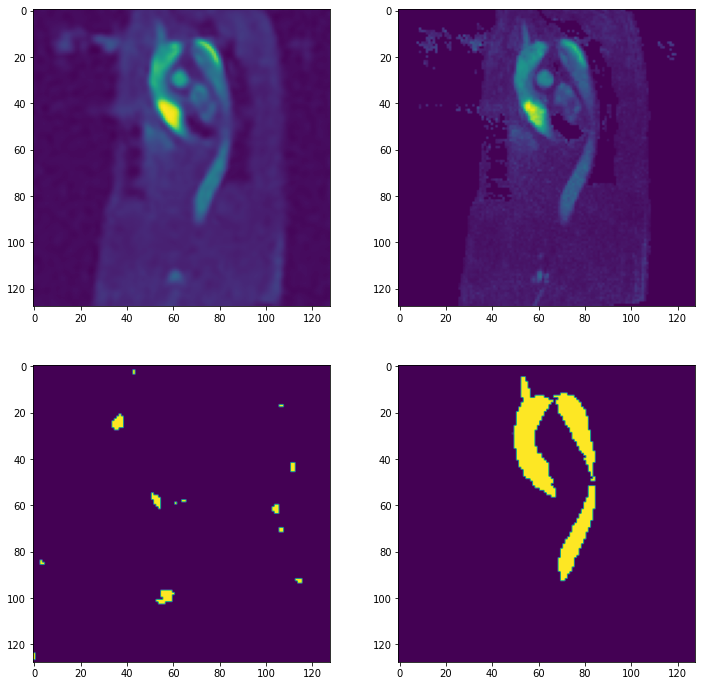

Batch 198 	 pcmra loss: 0.00029 	 mask loss: 0.038001
2.2187381099048054e-10
3.166446367686149e-05
0.5167298257350807
0.9999988079071045


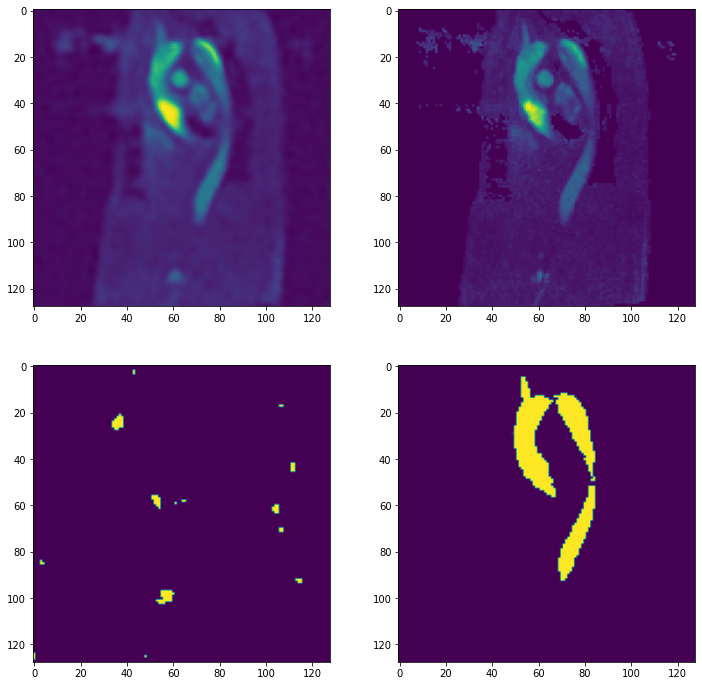

Batch 199 	 pcmra loss: 0.000289 	 mask loss: 0.038001
2.212846572646754e-10
3.1666668292018585e-05
0.5157161653041826
0.9999988079071045


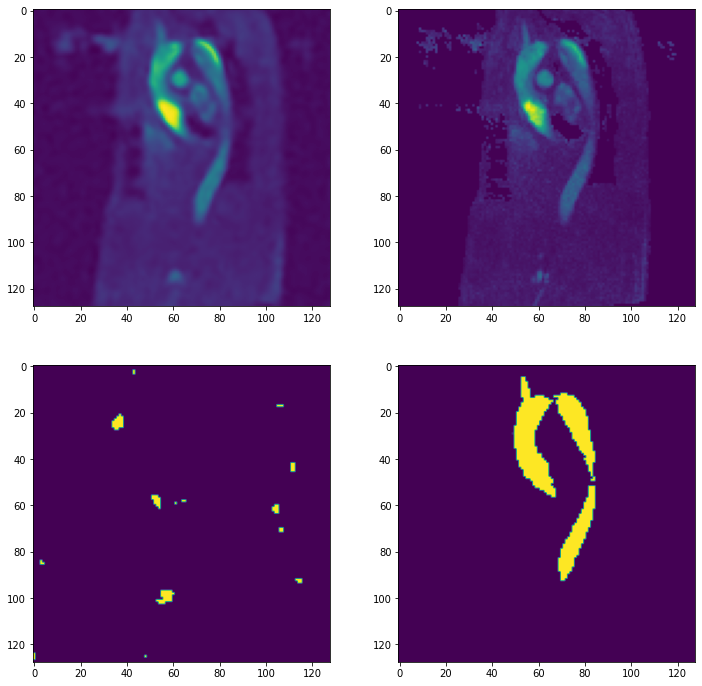

In [19]:
batches = 200
steps_til_summary = 1
i = 2

lowest_losses = 1000

for batch in range(batches):
    
#     idx, subj, proj, coords, pcmra, mask = train_ds[i]
    idx, subj, proj, coords, pcmra, mask = val_ds[i]
    subj = subj.item()
    
#     img_siren, img_optim = train_models[subj]
    img_siren, img_optim = val_models[subj]
    
    pcmra_out, pcmra_loss = train_model(coords, pcmra, img_siren, img_optim, 
                                        pcmra_siren, pcmra_optim, l2_loss, 
                                        train_head=True, train_tail=False)

    mask_out, mask_loss = train_model(coords, mask, img_siren, img_optim,
                                    mask_siren, mask_optim, l2_loss, 
                                    train_head=False, train_tail=False)
    
    if not batch % steps_til_summary:
        print(f"Batch {batch} \t pcmra loss: {round(pcmra_loss.item(), 6)} \t mask loss: {round(mask_loss.item(), 6)}")
        print(np.percentile(mask_out.flatten().cpu().detach().numpy(), 0))
        print(np.percentile(mask_out.flatten().cpu().detach().numpy(), 50))
        print(np.percentile(mask_out.flatten().cpu().detach().numpy(), 99))
        print(np.percentile(mask_out.flatten().cpu().detach().numpy(), 100))

        
        slic = 9

        fig, axes = plt.subplots(2,2, figsize=(12,12))
        axes[0, 0].imshow(pcmra_out.cpu().view(128, 128, 24).detach().numpy()[:, :, slic])
        axes[0, 1].imshow(pcmra.cpu().view(128, 128, 24).detach().numpy()[:, :, slic])
        axes[1, 0].imshow(mask_out.cpu().view(128, 128, 24).detach().numpy().round()[:, :, slic])
        axes[1, 1].imshow(mask.cpu().view(128, 128, 24).detach().numpy()[:, :, slic])
        
        plt.show()
